In [1]:
import numpy as np
import os
from sklearn.metrics import confusion_matrix
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle           
import matplotlib.pyplot as plt             
import cv2                                 
import tensorflow as tf                
from tqdm import tqdm
import pandas as pd


In [2]:
from tensorflow.compat.v1.losses import sparse_softmax_cross_entrop

ImportError: cannot import name 'sparse_softmax_cross_entrop' from 'tensorflow.compat.v1.losses' (d:\Сириус\.venv\lib\site-packages\tensorflow\_api\v2\compat\v1\losses\__init__.py)

In [3]:
# Import Data Science Libraries
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
import itertools
import random

# Import visualization libraries
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import cv2
import seaborn as sns

# Tensorflow Libraries
from tensorflow import keras
from tensorflow.keras import layers,models
from keras_preprocessing.image import ImageDataGenerator
from keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import Callback, EarlyStopping,ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras import Model
from tensorflow.keras.layers.experimental import preprocessing

# System libraries
from pathlib import Path
import os.path

# Metrics
from sklearn.metrics import classification_report, confusion_matrix
sns.set_style('darkgrid')

In [2]:
BATCH_SIZE = 64
TARGET_SIZE = (224, 224)

In [ ]:
dataset = "../input/sea-animals-image-dataste"
walk_through_dir(dataset)

In [23]:
train_generator = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.efficientnet.preprocess_input,
    validation_split=0.2
)

test_generator = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.efficientnet.preprocess_input
)

In [27]:
# Split the data into three categories.
train_images = train_generator.flow_from_dataframe(
    dataframe=train_path,
    x_col='Filepath',
    y_col='Label',
    target_size=TARGET_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
    subset='training'
)

val_images = train_generator.flow_from_dataframe(
    dataframe=train_path,
    x_col='Filepath',
    y_col='Label',
    target_size=TARGET_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
    subset='validation'
)

test_images = test_generator.flow_from_dataframe(
    dataframe=test_path,
    x_col='Filepath',
    y_col='Label',
    target_size=TARGET_SIZE,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False
)

AttributeError: 'str' object has no attribute 'copy'

In [28]:
class_labels = list(test_images.class_indices.keys())
print(class_labels)

NameError: name 'test_images' is not defined

In [54]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '1'  # Установка уровня логирования TensorFlow
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import *
from tqdm.notebook import tqdm
import pickle
from tensorflow.keras.applications import EfficientNetB3
N_TOP = 25

IMG_SIZE = 300

CUTOUT_COUNT = 5
CUTOUT_P = 0.75
CUTOUT_MASKSIZE = 0.2

CROP_SIZE = 0.5
CROP_P = 0.75


LR_START = 1e-06
LR_MAX = 5e-5
LR_MIN = 1e-9
LR_RAMPUP_EPOCHS = 5
LR_SUSTAIN_EPOCHS = 25
EPOCHS = 100


TF_VERBOSE = 2


EFFNET_DROP_CONNCET_RATE = 0.35
HEAD_DENSE_LAYER = 512
HEAD_DROPOUT = 0.25


ds_path = "/загрузки/archive_art"
output_path = "/загрузки/archive_art-effnetb3"
batch_size = 16

EFFNET = EFFNET_B3

In [55]:
def resize(image, size):
    # Функция изменения размера изображения
    image = tf.image.resize(image, [size, size])
    return image

def dropout(img, size, p, count, cutout_masksize):
    # Функция для дропаута (удаления квадратов) изображения с определенной вероятностью
    # и количеством квадратов
    p = tf.cast(tf.random.uniform([], 0, 1) < p, tf.int32)
    if (p == 0) or (count == 0) or (cutout_masksize == 0):
        return img
    
    for k in range(count):
        x = tf.cast(tf.random.uniform([], 0, size), tf.int32)
        y = tf.cast(tf.random.uniform([], 0, size), tf.int32)
        width = tf.cast(cutout_masksize*size, tf.int32)
        ya = tf.math.maximum(0, y-width//2)
        yb = tf.math.minimum(size, y+width//2)
        xa = tf.math.maximum(0, x-width//2)
        xb = tf.math.minimum(size, x+width//2)
        one = img[ya:yb, 0:xa, :]
        two = tf.zeros([yb-ya, xb-xa, 3])
        three = img[ya:yb, xb:size, :]
        middle = tf.concat([one, two, three], axis=1)
        img = tf.concat([img[0:ya, :, :], middle, img[yb:size, :, :]], axis=0)
            
    img = tf.reshape(img, [size, size, 3])
    return img

def preprocess_image(file_path, label, augmentation=False, rescale=True, crop_size=None, crop_p=None, cutout_count=None, cutout_p=None, cutout_masksize=None):
    # Функция предобработки изображения
    img = tf.io.read_file(file_path)
    img = tf.io.decode_jpeg(img, channels=3)
    
    if augmentation:
        crop_p = tf.cast(tf.random.uniform([], 0, 1) < crop_p, tf.float32)
        r = 1.0 + crop_size*np.random.random()*crop_p

        img = resize(img, size=int(IMG_SIZE*r))
        img = tf.image.random_crop(img, size=[IMG_SIZE, IMG_SIZE, 3])
        img = tf.image.random_flip_left_right(img)
        
        if cutout_count > 0:
            img = dropout(img, size=IMG_SIZE, p=cutout_p, count=cutout_count, cutout_masksize=cutout_masksize)

    else:
        img = resize(img, size=IMG_SIZE)
        
    if rescale:
        img = tf.cast(img, tf.float32) / 255.0

    return img, label

def train_preprocess_image(file_path, label):
    return preprocess_image(file_path, label, augmentation=True, rescale=True, 
                            crop_size=CROP_SIZE, crop_p=CROP_P,
                            cutout_count=CUTOUT_COUNT, 
                            cutout_p=CUTOUT_P,  
                            cutout_masksize=CUTOUT_MASKSIZE)

def test_preprocess_image(file_path, label):
    return preprocess_image(file_path, label, augmentation=False, rescale=True)


In [56]:
def configure_ds_for_performance(ds, batch_size, shuffle, shuffle_buffer_size=32, shuffle_seed=42, reshuffle_each_iteration=True):
    if shuffle:
        ds = ds.shuffle(buffer_size=shuffle_buffer_size, seed=shuffle_seed, reshuffle_each_iteration=reshuffle_each_iteration)
    ds = ds.batch(batch_size)
    ds = ds.prefetch(buffer_size=tf.data.AUTOTUNE)
    return ds

def create_ds(df, ds_path):
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    labels = df["genre"].values
    ds = tf.data.Dataset.from_tensor_slices((filenames, labels))
    return ds


In [57]:
def show_samples(df_train, ds_path):
    df = df_train.sample(n=100, random_state=421)
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    labels = df["description"].values
    plt.figure(figsize=(30, 30))
    for n, (filename, label) in enumerate(zip(filenames, labels)):
        if n < 10*10:
            image, label = preprocess_image(filename, label, augmentation=False, rescale=False)

            ax = plt.subplot(10, 10, n+1)
            plt.imshow(image.numpy().astype("uint8"))
            plt.axis("off")
    plt.show()

def show_augmentation(df_train, ds_path):
    df = df_train.sample(n=100, random_state=421)
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    labels = df["description"].values
    plt.figure(figsize=(15, 30))
    for n, (filename, label) in enumerate(zip(filenames, labels)):
        if n < 10:
            image, label = preprocess_image(filename, label, augmentation=False, rescale=False)
            ax = plt.subplot(10, 5, 5*n + 1)

            ax.imshow(image.numpy().astype("uint8"))
            ax.set_title(label)
            ax.axis("off")
            for i in range(4):
                ax = plt.subplot(10, 5, 5*n + 2+i)
                image_aug, label = preprocess_image(filename, label, augmentation=True, rescale=False, 
                                                    crop_size=CROP_SIZE, crop_p=CROP_P,
                                                    cutout_count=CUTOUT_COUNT, cutout_p=CUTOUT_P,  cutout_masksize=CUTOUT_MASKSIZE)
                ax.imshow(image_aug.numpy().astype("uint8"))
                ax.axis("off")

def show_predictions(df_test, ds_path, class_names):
    row = 5
    col = 5
    df = df_test.sample(n=row*col, random_state=123)
    
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    labels = df["genre_class"].values
    preds = [class_names[i] for i in df["pred"].values]
    plt.figure(figsize=(3*col, 3*row))
    for n, (filename, label) in enumerate(zip(filenames, labels)):
        if n < row*col:
            image, label = preprocess_image(filename, label, augmentation=False, rescale=False)
            pred = preds[n]
            fg_color = 'white'
            
            if pred == label:
                fg_color = "green"
                title = pred
            else:
                fg_color = "red"
                title = f"{pred}\n({label})"
            
            ax = plt.subplot(row, col, n+1)
            ax.set_title(title, color=fg_color)
            ax.imshow(image.numpy().astype("uint8"))
            ax.axis("off")
    plt.tight_layout()
    plt.show()


In [78]:
## model
EFFICIENT_NETS = [
    tf.keras.applications.efficientnet.EfficientNetB0,
    tf.keras.applications.efficientnet.EfficientNetB1,
    tf.keras.applications.efficientnet.EfficientNetB2,
    tf.keras.applications.efficientnet.EfficientNetB3,
    tf.keras.applications.efficientnet.EfficientNetB4,
    tf.keras.applications.efficientnet.EfficientNetB5,
    tf.keras.applications.efficientnet.EfficientNetB6,
    tf.keras.applications.efficientnet.EfficientNetB7,
]

EFFNET_B0 = EFFICIENT_NETS [0]
EFFNET_B1 = EFFICIENT_NETS [1]
EFFNET_B2 = EFFICIENT_NETS [2]
EFFNET_B3 = EFFICIENT_NETS [3]
EFFNET_B4 = EFFICIENT_NETS [4]
EFFNET_B5 = EFFICIENT_NETS [5]
EFFNET_B6 = EFFICIENT_NETS [6]
EFFNET_B7 = EFFICIENT_NETS [7]

EFFNET = EFFNET_B3

def build_model(n_classes, return_feature_extractor_model = False):



    inp = tf.keras.Input(shape=(IMG_SIZE,IMG_SIZE,3))
    base_model = EFFNET(include_top=False, weights="imagenet",input_tensor=inp, drop_connect_rate=EFFNET_DROP_CONNCET_RATE ) 

    # Add layers at the end
    x = base_model.output
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    
    if return_feature_extractor_model:
        feat_extractor1 = x
    x = tf.keras.layers.Dense(HEAD_DENSE_LAYER,name="head_dense_512", kernel_initializer='he_uniform')(x)
    
    if return_feature_extractor_model:
        feat_extractor2 = x

    x = tf.keras.layers.Dropout(HEAD_DROPOUT)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    if return_feature_extractor_model:
        feat_extractor = tf.keras.layers.concatenate ([feat_extractor1, feat_extractor2])

    output = tf.keras.layers.Dense(n_classes, activation='softmax')(x)

    model = tf.keras.Model(inputs=base_model.input, outputs=output)
    if return_feature_extractor_model:
        model_fe = tf.keras.Model(inputs=base_model.input, outputs=feat_extractor)
        return model, model_fe
    else:
        return model



In [ ]:
# import os
# from sklearn.model_selection import train_test_split
# from sklearn.utils import shuffle

# # Путь к корневой папке с изображениями
# dataset_path = '/загрузки/archive_2'

# # Список стилей
# styles = ['Ukiyo_e', 'Synthetic_Cubism', 'Symbolism', 'Romanticism', 'Rococo',
#           'Realism', 'Post_Impressionism', 'Pop_Art', 'Pointillism', 'Northern_Renaissance',
#           'New_Realism', 'Naive_Art_Primitivism', 'Minimalism','Mannerism_Late_Renaissance',
#           'Impressionism','High_Renaissance','Fauvism','Expressionism','Early_Renaissance','Cubism',
#           'Contemporary_Realism','Color_Field_Painting','Baroque','Art_Nouveau_Modern','Analytical_Cubism',
#           'Action_painting','Abstract_Expressionism']

# # Создание списка для хранения путей к изображениям и их стилей
# image_paths = []
# labels = []

# # Заполнение списка путей и меток
# for style in styles:
#     style_path = os.path.join(dataset_path, style)
#     images = os.listdir(style_path)
#     images = [os.path.join(style_path, img) for img in images if img.endswith(".jpg")]
#     image_paths.extend(images)
#     labels.extend([style] * len(images))

# # Перемешивание данных
# image_paths, labels = shuffle(image_paths, labels, random_state=42)

# # Разделение на обучающую и тестовую выборки (80% train, 20% test)
# train_paths, test_paths, train_labels, test_labels = train_test_split(
#     image_paths, labels, test_size=0.2, random_state=42, stratify=labels
# )

# # Создание папок для train и test, если они не существуют
# train_folder = "/загрузки/train_img"
# test_folder = "/загрузки/test_img"
# os.makedirs(train_folder, exist_ok=True)
# os.makedirs(test_folder, exist_ok=True)

# # Копирование файлов в соответствующие папки
# for path, label in zip(train_paths, train_labels):
#     destination_folder = os.path.join(train_folder, label)
#     os.makedirs(destination_folder, exist_ok=True)
#     os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

# for path, label in zip(test_paths, test_labels):
#     destination_folder = os.path.join(test_folder, label)
#     os.makedirs(destination_folder, exist_ok=True)
#     os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

In [64]:
# Выберите конкретную версию EfficientNet (например, EFFNET_B3)
EFFNET = EFFNET_B3

def build_model(n_classes, return_feature_extractor_model=False):
    # Функция построения модели
    inp = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    
    # Создайте экземпляр EfficientNet
    base_model = EFFNET(include_top=False, weights="imagenet", input_tensor=inp, drop_connect_rate=EFFNET_DROP_CONNCET_RATE)

    x = base_model.output
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    
    if return_feature_extractor_model:
        feat_extractor1 = x
    
    # Добавьте свой слой Dense
    x = tf.keras.layers.Dense(HEAD_DENSE_LAYER, name="head_dense_512", kernel_initializer='he_uniform')(x)
    
    if return_feature_extractor_model:
        feat_extractor2 = x

    x = tf.keras.layers.Dropout(HEAD_DROPOUT)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    if return_feature_extractor_model:
        feat_extractor = tf.keras.layers.concatenate([feat_extractor1, feat_extractor2])

    output = tf.keras.layers.Dense(n_classes, activation='softmax')(x)

    model = tf.keras.Model(inputs=inp, outputs=output)
    if return_feature_extractor_model:
        model_fe = tf.keras.Model(inputs=inp, outputs=feat_extractor)
        return model, model_fe
    else:
        return model


In [19]:
EFFNET = EFFNET_B3

In [71]:
def lrfn(epoch):
    if epoch < LR_RAMPUP_EPOCHS:
        lr = (LR_MAX - LR_START) / LR_RAMPUP_EPOCHS * epoch + LR_START
    elif epoch < LR_RAMPUP_EPOCHS + LR_SUSTAIN_EPOCHS:
        lr = LR_MAX
    else:
        decay_total_epochs = EPOCHS - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS - 1
        decay_epoch_index = epoch - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS
        phase = math.pi * decay_epoch_index / decay_total_epochs
        cosine_decay = 0.5 * (1 + math.cos(phase))
        lr = (LR_MAX - LR_MIN) * cosine_decay + LR_MIN
    return lr


In [73]:
def plot_training(history):
    # Функция для отображения графиков обучения
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 3, figsize=(20, 5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')

    lr = history['lr']
    axes[2].plot(epochs, lr, 'b', label='LR Loss')
    axes[2].set_title('Learning rate')
    axes[2].legend(loc='best')

    plt.show()


In [74]:
df_classes = pd.read_csv(f"{ds_path}/classes.csv")
print(f"df_classes:{df_classes.shape}")

df = df_classes.groupby(["subset","genre"]).size().reset_index()
df.columns = ["subset", "genre", "size"]
df = df.pivot(index="genre",columns="subset", values="size")
df = df.reset_index()
df = df.fillna(0).sort_values(by="train", ascending=False)
df["train"] = df["train"].astype(np.int16)
df["test"] = df["test"].astype(np.int16)

df=df.sort_values(by="train", ascending=False)

top_artists = df["genre"].values[:N_TOP]
display(df.head(N_TOP))

df_all = df_classes[df_classes["genre"].isin(top_artists)].reset_index(drop = True)
le = LabelEncoder()
df_all["genre_class"] = le.fit_transform(df_all["genre"].values)
class_names = le.classes_

with open('class_names.pickle', 'wb') as handle:
    pickle.dump(class_names, handle)
    
    
df_train = df_all.query("subset == 'train'").reset_index(drop = True)
df_test = df_all.query("subset == 'test'").reset_index(drop = True)


df_train, df_valid, y_train, y_valid =  train_test_split(df_train, df_train["genre"], 
                                                                   test_size=0.2, random_state=42, 
                                                                   stratify=df_train["genre"])


print(f"train:{df_train.shape[0]}, valid:{df_valid.shape[0]}, test:{df_test.shape[0]}")

df = df_train.groupby("genre_class").size().reset_index()
df.columns = ["genre_class","size"]
df["class_weight"] = df["size"].sum()/(df.shape[0]*df["size"])


# Set class weights - assign higher weights to underrepresented classes
class_weights = df['class_weight'].to_dict()

df_classes:(80042, 9)


subset,genre,test,train,uncertain artist
51,['Impressionism'],2576,10256,15.0
91,['Realism'],2118,8412,4.0
98,['Romanticism'],1384,5504,8.0
89,['Post Impressionism'],1245,5029,0.0
30,['Expressionism'],1278,5001,1.0
12,['Baroque'],833,3367,2.0
110,['Symbolism'],808,3366,0.0
9,['Art Nouveau Modern'],848,3306,1.0
3,['Abstract Expressionism'],508,2066,0.0
69,['Northern Renaissance'],509,2039,2.0


train:50174, valid:12544, test:15684


In [75]:
train_ds = create_ds(df_train, ds_path)
train_ds = train_ds.map(train_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
train_ds = configure_ds_for_performance(train_ds,batch_size, shuffle=True)


valid_ds = create_ds(df_valid, ds_path)
valid_ds = valid_ds.map(test_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
valid_ds = configure_ds_for_performance(valid_ds,batch_size, shuffle=True)


test_ds = create_ds(df_test, ds_path)
test_ds = test_ds.map(test_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
test_ds = configure_ds_for_performance(test_ds,batch_size, shuffle=False)

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xcd in position 219: invalid continuation byte

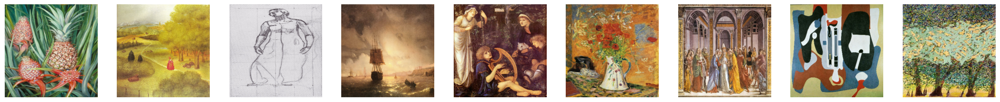

In [25]:
show_samples(df_train, ds_path)

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xcd in position 219: invalid continuation byte

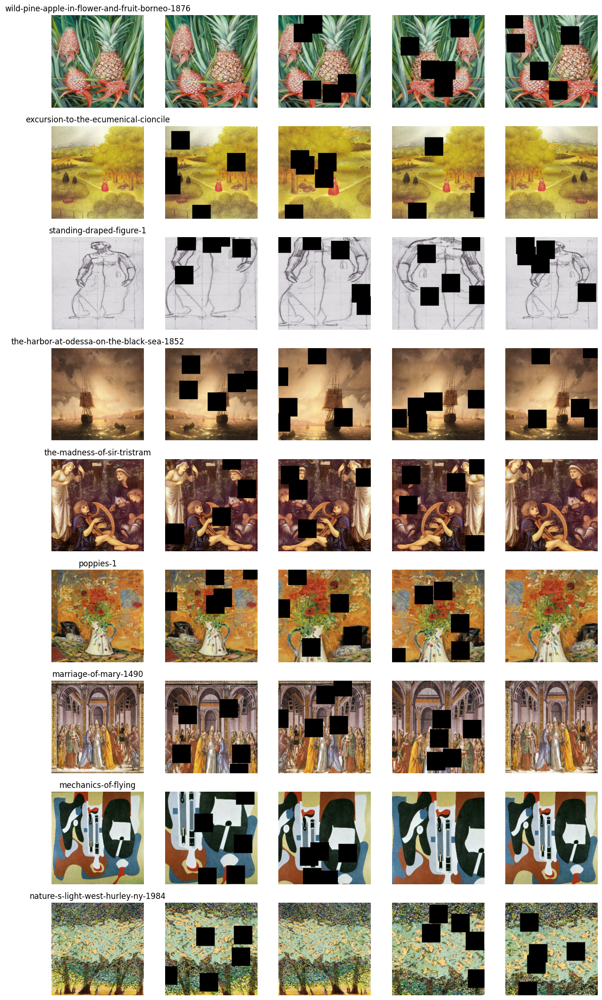

In [26]:
show_augmentation(df_train, ds_path)


In [82]:
        ## model
        EFFICIENT_NETS = [
            tf.keras.applications.efficientnet.EfficientNetB0,
            tf.keras.applications.efficientnet.EfficientNetB1,
            tf.keras.applications.efficientnet.EfficientNetB2,
            tf.keras.applications.efficientnet.EfficientNetB3,
            tf.keras.applications.efficientnet.EfficientNetB4,
            tf.keras.applications.efficientnet.EfficientNetB5,
            tf.keras.applications.efficientnet.EfficientNetB6,
            tf.keras.applications.efficientnet.EfficientNetB7,
        ]

        EFFNET_B0 = EFFICIENT_NETS [0]
        EFFNET_B1 = EFFICIENT_NETS [1]
        EFFNET_B2 = EFFICIENT_NETS [2]
        EFFNET_B3 = EFFICIENT_NETS [3]
        EFFNET_B4 = EFFICIENT_NETS [4]
        EFFNET_B5 = EFFICIENT_NETS [5]
        EFFNET_B6 = EFFICIENT_NETS [6]
        EFFNET_B7 = EFFICIENT_NETS [7]

        EFFNET = EFFNET_B3

        def build_model(n_classes, return_feature_extractor_model = False):



            inp = tf.keras.Input(shape=(IMG_SIZE,IMG_SIZE,3))
            base_model = EFFNET(include_top=False, weights="imagenet",input_tensor=inp, drop_connect_rate=EFFNET_DROP_CONNCET_RATE ) 

            # Add layers at the end
            x = base_model.output
            x = tf.keras.layers.GlobalAveragePooling2D()(x)
            
            if return_feature_extractor_model:
                feat_extractor1 = x
            x = tf.keras.layers.Dense(HEAD_DENSE_LAYER,name="head_dense_512", kernel_initializer='he_uniform')(x)
            
            if return_feature_extractor_model:
                feat_extractor2 = x

            x = tf.keras.layers.Dropout(HEAD_DROPOUT)(x)
            x = tf.keras.layers.BatchNormalization()(x)
            x = tf.keras.layers.Activation('relu')(x)

            if return_feature_extractor_model:
                feat_extractor = tf.keras.layers.concatenate ([feat_extractor1, feat_extractor2])

            output = tf.keras.layers.Dense(n_classes, activation='softmax')(x)

            model = tf.keras.Model(inputs=base_model.input, outputs=output)
            if return_feature_extractor_model:
                model_fe = tf.keras.Model(inputs=base_model.input, outputs=feat_extractor)
                return model, model_fe
            else:
                return model


    x = base_model.output
    x = tf.keras.layers.GlobalAveragePooling2D()(x)

    x = tf.keras.layers.Dense(HEAD_DENSE_LAYER,name="head_dense_512", kernel_initializer='he_uniform')(x)

    x = tf.keras.layers.Dropout(HEAD_DROPOUT)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)


    output = tf.keras.layers.Dense(n_classes, activation='softmax')(x)

In [86]:
import math

Learning rate schedule: 1e-06 to 5e-05 to 1e-09


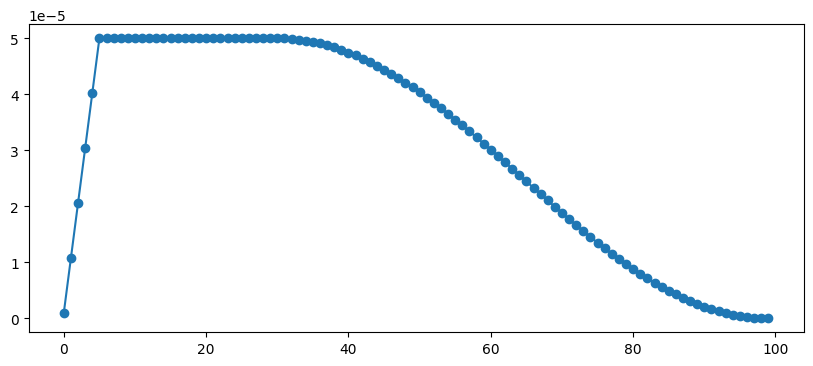

In [87]:
arly_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, verbose=1, 
                           mode='auto', restore_best_weights=True)

model_chkpoint = tf.keras.callbacks.ModelCheckpoint(
    f'{output_path}/model.weights.h5', monitor='val_loss', verbose=1, save_best_only=True,
    save_weights_only=True, mode='auto', save_freq='epoch')


reduce_lr = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose = False)

rng = [i for i in range(EPOCHS)]
lr_y = [lrfn(x) for x in rng]
plt.figure(figsize=(10, 4))
plt.plot(rng, lr_y, '-o')
print("Learning rate schedule: {:.3g} to {:.3g} to {:.3g}". \
      format(lr_y[0], max(lr_y), lr_y[-1]))

In [101]:
n_epoch = EPOCHS
model = build_model(N_TOP, return_feature_extractor_model = False)

    
optimizer = tf.keras.optimizers.Adam(learning_rate=LR_START)

model.compile(loss='sparse_categorical_crossentropy',
                  optimizer=optimizer, 
                  metrics=['accuracy'])

history = model.fit(
        train_ds,
        validation_data=valid_ds,
        epochs=n_epoch,
        verbose=TF_VERBOSE,
        callbacks=[reduce_lr, model_chkpoint],
        class_weight=class_weights
    )

plot_training(history.history)

TypeError: Value passed to parameter 'x' has DataType string not in list of allowed values: bfloat16, float16, float32, float64, int8, int16, int32, int64, complex64, complex128

In [92]:
model, model_fe = build_model(N_TOP, return_feature_extractor_model = True)
model.load_weights (f'{output_path}/model.h5')
model.compile(loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = '/загрузки/archive_art-effnetb3/model.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [91]:
score = model.evaluate(valid_ds, verbose=TF_VERBOSE)
print(f"accuracy valid: {score[1]:.5f}")

ValueError: You must call `compile()` before using the model.

In [ ]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '1' 

import tensorflow as tf

from tqdm.notebook import tqdm

from sklearn.model_selection import train_test_split

from tensorflow.keras.applications.efficientnet import EfficientNetB3

import math

from tqdm.notebook import tqdm

## image pre-processing

def resize(image, size):
    image = tf.image.resize(image, [size, size])
    return image

def dropout(img, size, p , count , cutout_masksize ):
    p = tf.cast(tf.random.uniform([],0,1)<p, tf.int32)
    if (p==0)|(count==0)|(cutout_masksize==0): return img
    
    for k in range(count):
        x = tf.cast(tf.random.uniform([],0,size),tf.int32)
        y = tf.cast(tf.random.uniform([],0,size),tf.int32)
        width = tf.cast(cutout_masksize*size,tf.int32)
        ya = tf.math.maximum(0,y-width//2)
        yb = tf.math.minimum(size,y+width//2)
        xa = tf.math.maximum(0,x-width//2)
        xb = tf.math.minimum(size,x+width//2)
        one = img[ya:yb,0:xa,:]
        two = tf.zeros([yb-ya,xb-xa,3]) 
        three = img[ya:yb,xb:size,:]
        middle = tf.concat([one,two,three],axis=1)
        img = tf.concat([img[0:ya,:,:],middle,img[yb:size,:,:]],axis=0)
            
    img = tf.reshape(img,[size,size,3])
    return img

def preprocess_image(file_path, augmentation=False):
    img = tf.io.read_file(file_path)
    img = tf.io.decode_jpeg(img, channels=3)
    
    if augmentation:
        img = resize(img, size=int(IMG_SIZE*(1 + CROP_SIZE*np.random.random()*CROP_P)))
        img = tf.image.random_crop(img, size=[IMG_SIZE, IMG_SIZE, 3])
        img = tf.image.random_flip_left_right(img)
        
        if CUTOUT_COUNT > 0:
            img = dropout(img, size=IMG_SIZE, p=CUTOUT_P, count=CUTOUT_COUNT, cutout_masksize=CUTOUT_MASKSIZE)

    else:
        img = resize(img, size=IMG_SIZE)
        
    img = tf.cast(img, tf.float32) / 255.0
    return img

def configure_ds_for_performance(ds, batch_size, shuffle, shuffle_buffer_size=32, shuffle_seed=42, reshuffle_each_iteration=True):
    if shuffle:
        ds = ds.shuffle(buffer_size=shuffle_buffer_size, seed=shuffle_seed, reshuffle_each_iteration=reshuffle_each_iteration)
    ds = ds.batch(batch_size)
    ds = ds.prefetch(buffer_size=tf.data.AUTOTUNE)
    return ds

def create_ds(df, ds_path, augmentation=False):
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    labels = df["genre"].values
    ds = tf.data.Dataset.from_tensor_slices((filenames, labels))
    ds = ds.map(lambda x, y: (preprocess_image(x, augmentation), y), num_parallel_calls=tf.data.AUTOTUNE)
    return ds

def show_samples(df_train, ds_path):
    df = df_train.sample(n=100, random_state=421)
    
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    plt.figure(figsize=(30, 30))
    
    for n, filename in enumerate(filenames):
        if n < 10*10:
            image = preprocess_image(filename, augmentation=False)

            ax = plt.subplot(10, 10, n+1)
            plt.imshow(image.numpy().astype("uint8"))
            plt.axis("off")
            
    plt.show()

def build_model(n_classes, return_feature_extractor_model=False):
    inp = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    base_model = EfficientNetB3(include_top=False, weights="imagenet", input_tensor=inp, drop_connect_rate=EFFNET_DROP_CONNCET_RATE)

    x = base_model.output
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    
    if return_feature_extractor_model:
        feat_extractor1 = x
    
    x = tf.keras.layers.Dense(HEAD_DENSE_LAYER, name="head_dense_512", kernel_initializer='he_uniform')(x)
    
    if return_feature_extractor_model:
        feat_extractor2 = x

    x = tf.keras.layers.Dropout(HEAD_DROPOUT)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)

    if return_feature_extractor_model:
        feat_extractor = tf.keras.layers.concatenate([feat_extractor1, feat_extractor2])

    output = tf.keras.layers.Dense(n_classes, activation='softmax')(x)

    model = tf.keras.Model(inputs=base_model.input, outputs=output)
    if return_feature_extractor_model:
        model_fe = tf.keras.Model(inputs=base_model.input, outputs=feat_extractor)
        return model, model_fe
    else:
        return model

def lrfn(epoch):
    if epoch < LR_RAMPUP_EPOCHS:
        lr = (LR_MAX - LR_START) / LR_RAMPUP_EPOCHS * epoch + LR_START
    elif epoch < LR_RAMPUP_EPOCHS + LR_SUSTAIN_EPOCHS:
        lr = LR_MAX
    else:
        decay_total_epochs = EPOCHS - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS - 1
        decay_epoch_index = epoch - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS
        phase = math.pi * decay_epoch_index / decay_total_epochs
        cosine_decay = 0.5 * (1 + math.cos(phase))
        lr = (LR_MAX - LR_MIN) * cosine_decay + LR_MIN
    return lr

def plot_training(history):
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')

    lr = history['lr']
    axes[2].plot(epochs, lr, 'b', label='LR Loss')
    axes[2].set_title('Learning rate')
    axes[2].legend(loc='best')

    plt.show()

def predict_class(model, file_path):
    img = preprocess_image(file_path, augmentation=False)
    img = tf.expand_dims(img, axis=0)
    predictions = model.predict(img)
    predicted_class_idx = np.argmax(predictions)
    return predicted_class_idx

def show_predictions(df_test, ds_path, model, class_names):
    row = 5
    col = 5
    df = df_test.sample(n=row*col, random_state=123)
    
    filenames = [f"{ds_path}/{filename}" for filename in df["filename"].values]
    labels = df["genre"].values
    
    plt.figure(figsize=(3*col, 3*row))
    for n, (filename, label) in enumerate(zip(filenames, labels)):
        if n < row*col:
            predicted_class_idx = predict_class(model, filename)
            pred = class_names[predicted_class_idx]
            fg_color = 'white'
            
            if pred == label:
                fg_color = "green"
                title = pred
            else:
                fg_color = "red"
                title = f"{pred}\n({label})"
            
            image = preprocess_image(filename, augmentation=False)
            
            ax = plt.subplot(row, col, n+1)
            ax.set_title(title, color=fg_color)
            ax.imshow(image.numpy().astype("uint8"))
            ax.axis("off")
            
    plt.tight_layout()
    plt.show()

# Используйте эту функцию для создания и конфигурации датасета
def create_and_configure_dataset(df, ds_path, batch_size, augmentation=False, shuffle=True):
    ds = create_ds(df, ds_path, augmentation=augmentation)
    ds = configure_ds_for_performance(ds, batch_size, shuffle)
    return ds

# Пример использования функций
# Пусть df_train - ваш датафрейм для обучающего датасета
# Пусть df_test - ваш датафрейм для тестового датасета

# 1. Создание и конфигурация датасета для обучения
train_ds = create_and_configure_dataset(df_train, ds_path, batch_size=16, augmentation=True, shuffle=True)

# 2. Создание и конфигурация датасета для тестирования (без аугментации)
test_ds = create_and_configure_dataset(df_test, ds_path, batch_size=16, augmentation=False, shuffle=False)

# 3. Создание модели
n_classes = len(df_train["genre"].unique())  # Замените artist_class на ваше имя столбца с классами
model, model_fe = build_model(n_classes, return_feature_extractor_model=True)

# 4. Компиляция модели
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 5. Обучение модели
history = model.fit(train_ds, epochs=100, validation_data=test_ds)

# 6. Оценка точности на тестовом датасете
test_accuracy = model.evaluate(test_ds)[1]
print(f'Test Accuracy: {test_accuracy}')

# 7. Построение графиков обучения
plot_training(history)

# 8. Визуализация предсказаний
class_names = df_train["genre"].unique()  # Замените artist_class на ваше имя столбца с классами
show_predictions(df_test, ds_path, model, class_names)


In [1]:
import os
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

# Путь к корневой папке с изображениями
dataset_path = '/загрузки/archive_2'

# Список стилей
styles = ['Ukiyo_e', 'Synthetic_Cubism', 'Symbolism', 'Romanticism', 'Rococo',
          'Realism', 'Post_Impressionism', 'Pop_Art', 'Pointillism', 'Northern_Renaissance',
          'New_Realism', 'Naive_Art_Primitivism', 'Minimalism','Mannerism_Late_Renaissance',
          'Impressionism','High_Renaissance','Fauvism','Expressionism','Early_Renaissance','Cubism',
          'Contemporary_Realism','Color_Field_Painting','Baroque','Art_Nouveau_Modern','Analytical_Cubism',
          'Action_painting','Abstract_Expressionism']

# Создание списка для хранения путей к изображениям и их стилей
image_paths = []
labels = []

# Заполнение списка путей и меток
for style in styles:
    style_path = os.path.join(dataset_path, style)
    images = os.listdir(style_path)
    images = [os.path.join(style_path, img) for img in images if img.endswith(".jpg")]
    image_paths.extend(images)
    labels.extend([style] * len(images))

# Перемешивание данных
image_paths, labels = shuffle(image_paths, labels, random_state=42)

# Разделение на обучающую и тестовую выборки (80% train, 20% test)
train_paths, test_paths, train_labels, test_labels = train_test_split(
    image_paths, labels, test_size=0.2, random_state=42, stratify=labels
)

# Создание папок для train и test, если они не существуют
train_folder = "/загрузки/train_img"
test_folder = "/загрузки/test_img"
os.makedirs(train_folder, exist_ok=True)
os.makedirs(test_folder, exist_ok=True)

# Копирование файлов в соответствующие папки
for path, label in zip(train_paths, train_labels):
    destination_folder = os.path.join(train_folder, label)
    os.makedirs(destination_folder, exist_ok=True)
    os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

for path, label in zip(test_paths, test_labels):
    destination_folder = os.path.join(test_folder, label)
    os.makedirs(destination_folder, exist_ok=True)
    os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

ValueError: With n_samples=0, test_size=0.2 and train_size=None, the resulting train set will be empty. Adjust any of the aforementioned parameters.

In [1]:
import numpy as np 
import pandas as pd 
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg
import plotly.express as px
from tensorflow.keras.preprocessing.image import ImageDataGenerator 
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2

In [ ]:
---------------------------------------------------------------------------------------------------------------------

In [ ]:
pip install imutils
pip install super_gradients==3.0.7
pip install albumentations 
pip install split-folders[full]

In [1]:
import os
import math
import random
from typing import Dict, List,Tuple
import requests

import numpy as np
import matplotlib.pyplot as plt
import glob
from pathlib import Path, PurePath
import pathlib
import pandas as pd

import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import datasets
from torchvision import transforms

from PIL import Image

import albumentations as A
from albumentations.pytorch import ToTensorV2

from sklearn.model_selection import train_test_split

from imutils import paths

import splitfolders
import textwrap

import super_gradients
from super_gradients.common.object_names import Models
from super_gradients.training import Trainer
from super_gradients.training import training_hyperparams
from super_gradients.training.metrics.classification_metrics import Accuracy, Top5
from super_gradients.training.utils.early_stopping import EarlyStop
from super_gradients.training import models
from super_gradients.training.utils.callbacks import Phase

KeyboardInterrupt: 

In [ ]:
MODEL_NAME = "regnetY800"
# Note you can also pass 'model_name=regnetY200', 'model_name=regnetY400', 'model_name=regnetY600' to try a variety of the architecture

MODEL_NAME="resnet50"

MODEL_NAME='mobilenet_v2'

MODEL_NAME='mobilenet_v3_large'

MODEL_NAME='vit_base'

In [ ]:
# Подключаем необходимые библиотеки
import torch
from pathlib import Path

# Определяем класс конфигурации
class Config:

    TRAIN_DIR = "/загрузки/train_img"
    TEST_DIR = "/загрузки/test_img"

    # set the input height and width
    INPUT_HEIGHT = 224
    INPUT_WIDTH = 224

    # set the input heig/ht and width
    IMAGENET_MEAN = [0.485, 0.456, 0.406]
    IMAGENET_STD = [0.229, 0.224, 0.225]
    
    BATCH_SIZE = 128
    MODEL_NAME = 'regnetY800'
    DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
    TRAINING_PARAMS = 'training_hyperparams/default_train_params'
    
    NUM_CLASSES = 27

    CHECKPOINT_DIR = 'checkpoints'

# Инициализируем объект конфигурации
config = Config()




In [34]:
INPUT_SHAPE = (150,150,3)
BATCH_SIZE = 60
train_path = "/загрузки/train_img"
test_path = "/загрузки/test_img"


In [19]:
train_generator = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.efficientnet.preprocess_input,
    validation_split=0.2
)

test_generator = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.efficientnet.preprocess_input
)

NameError: name 'train_df' is not defined

ValueError: num must be an integer with 1 <= num <= 24, not 25

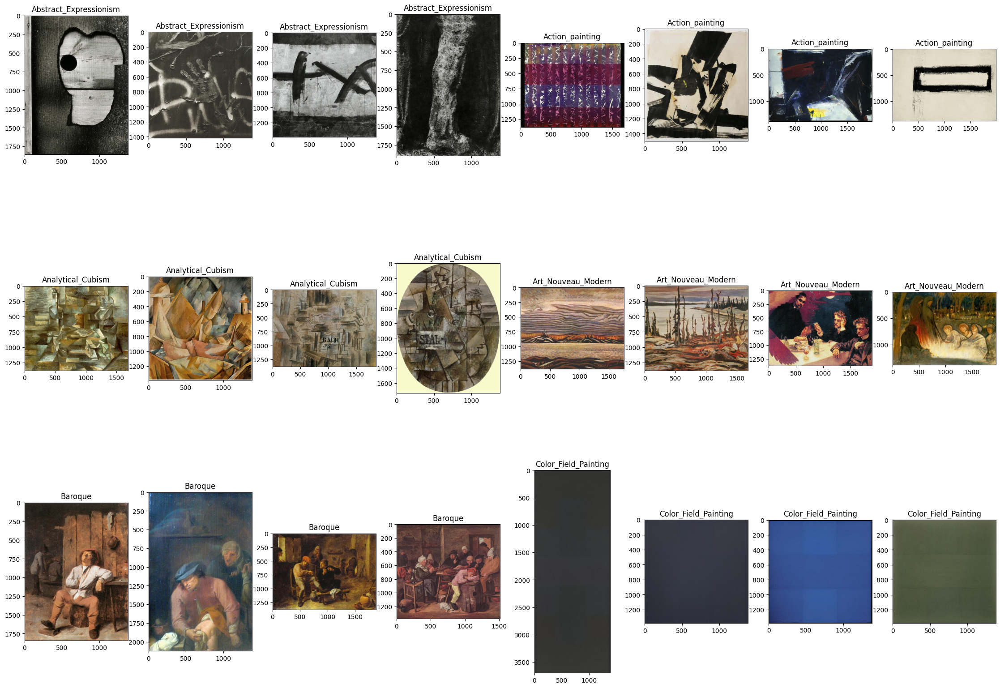

In [8]:
def visualize_data(folder):
    c=1
    directory=os.listdir(folder)
    plt.figure(figsize=(28,20))
    for each in directory:
        currentFolder=folder+ "/" +each
        for i, file in enumerate(os.listdir(currentFolder)[0:4]):
            full_path=currentFolder+"/"+file
            plt.subplot(3, 8, c)
            img = mpimg.imread(full_path)
            plt.imshow(img)
            plt.title(each)
            c+=1
    plt.subplots_adjust(wspace=0.3, hspace=-0.1)
    plt.show()
    
visualize_data(test_path)

In [3]:

def get_generator(_training_dir, _test_dir):
    train_datagen = ImageDataGenerator(
        rescale=1/255.0, 
        featurewise_center=True,
        featurewise_std_normalization=True, 
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        shear_range=0.2,
        fill_mode='nearest'
    )
    test_datagen = ImageDataGenerator(
        rescale=1/255.0
    )
    train_generator = train_datagen.flow_from_directory(
        _training_dir,
        shuffle=True,
        target_size=(150,150),
        batch_size=BATCH_SIZE,
        class_mode='categorical'
    )
    test_generator = test_datagen.flow_from_directory(
        _test_dir,
        shuffle=True,
        target_size=(150,150),
        batch_size=BATCH_SIZE,
        class_mode='categorical'
    )
    
    return train_generator, test_generator

In [2]:
%%capture 
# After installation is complete you must restart the notebook otherwise you 
# will face some import errors
!pip install imutils
!pip install super_gradients==3.0.7
!pip install albumentations 
!pip install split-folders[full]

In [8]:
!pip install --upgrade torch torchvision


  Using cached torch-2.1.2-cp310-cp310-win_amd64.whl.metadata (26 kB)
Using cached torch-2.1.2-cp310-cp310-win_amd64.whl (192.3 MB)
  Attempting uninstall: torch
    Found existing installation: torch 1.13.1
    Uninstalling torch-1.13.1:
      Successfully uninstalled torch-1.13.1


  You can safely remove it manually.


In [1]:
import super_gradients
from super_gradients.common.object_names import Models
from super_gradients.training import Trainer
from super_gradients.training import training_hyperparams
from super_gradients.training.metrics.classification_metrics import Accuracy, Top5
from super_gradients.training.utils.early_stopping import EarlyStop
from super_gradients.training import models
from super_gradients.training.utils.callbacks import Phase

ModuleNotFoundError: No module named 'super_gradients'

In [1]:
import os
import math
import random
from typing import Dict, List,Tuple
import requests

import numpy as np
import matplotlib.pyplot as plt
import glob
from pathlib import Path, PurePath
import pathlib
import pandas as pd

import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import datasets
from torchvision import transforms

from PIL import Image

import albumentations as A
from albumentations.pytorch import ToTensorV2

from sklearn.model_selection import train_test_split

from imutils import paths

import splitfolders
import textwrap

import super_gradients
from super_gradients.common.object_names import Models
from super_gradients.training import Trainer
from super_gradients.training import training_hyperparams
from super_gradients.training.metrics.classification_metrics import Accuracy, Top5
from super_gradients.training.utils.early_stopping import EarlyStop
from super_gradients.training import models
from super_gradients.training.utils.callbacks import Phase

ModuleNotFoundError: No module named 'super_gradients'

In [17]:
import torch
import torchvision.transforms as transforms
resize = transforms.Resize(size=(config.INPUT_HEIGHT,config.INPUT_WIDTH))
make_tensor = transforms.ToTensor()
normalize = transforms.Normalize(mean=config.IMAGENET_MEAN, std=config.IMAGENET_STD)
center_cropper = transforms.CenterCrop((config.INPUT_HEIGHT,config.INPUT_WIDTH))
random_horizontal_flip = transforms.RandomHorizontalFlip(p=0.75)
random_vertical_flip = transforms.RandomVerticalFlip(p=0.75)
random_rotation = transforms.RandomRotation(degrees=90)
random_crop = transforms.RandomCrop(size=(200,200))
augmix = transforms.AugMix(severity = 3, mixture_width=3, alpha=0.2)
auto_augment = transforms.AutoAugment()
random_augment = transforms.RandAugment()

# initialize our training and validation set data augmentation pipeline
train_transforms = transforms.Compose([
  resize, 
  auto_augment,
  augmix,
  random_augment,
  make_tensor,
  normalize
])

val_transforms = transforms.Compose([resize, make_tensor, normalize])

ImportError: cannot import name 'set_single_level_autograd_function_allowed' from 'torch._C._functorch' (unknown location)

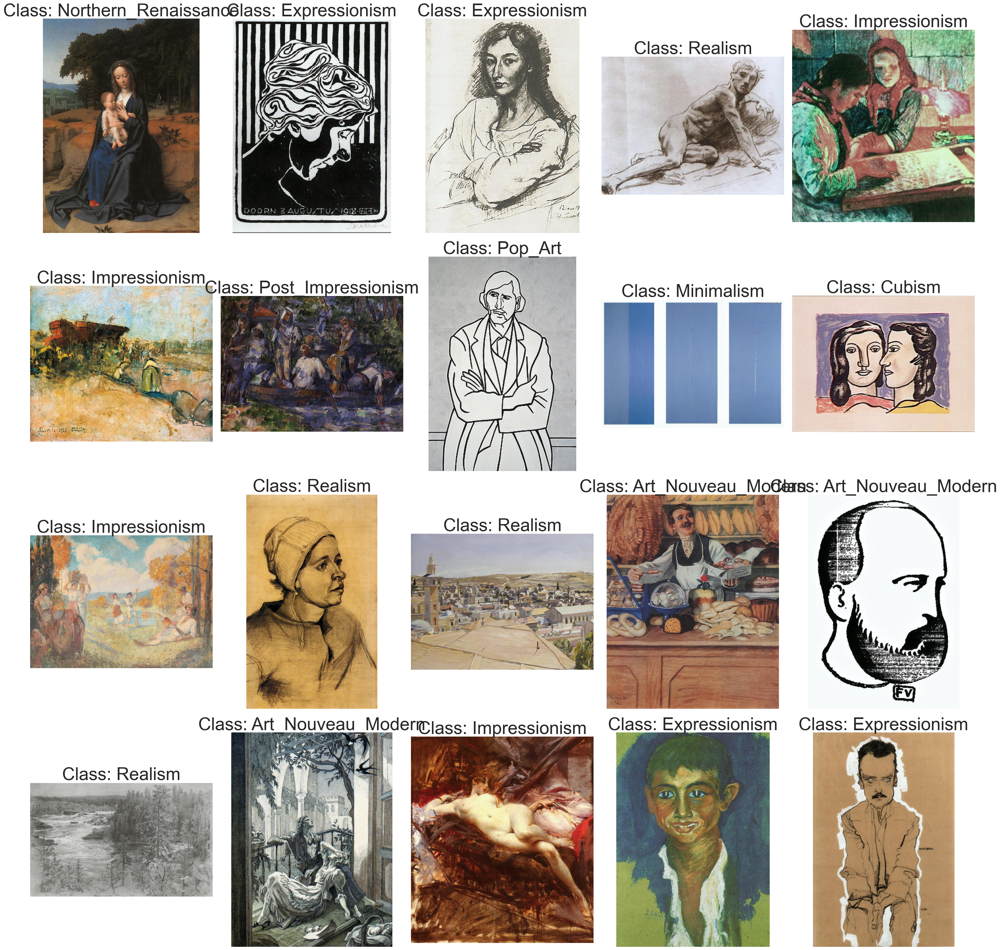

In [15]:
import imutils.paths
import random
import math
from pathlib import PurePath
from PIL import Image
import matplotlib.pyplot as plt

train_image_path_list = list(sorted(imutils.paths.list_images(config.TRAIN_DIR)))
train_image_path_sample = random.sample(population=train_image_path_list, k=20)

def examine_images(images:list):
    num_images = len(images)
    num_rows = int(math.ceil(num_images/5))
    num_cols = 5
    
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(30, 30),tight_layout=True)
    axs = axs.ravel()

    for i, image_path in enumerate(images[:num_images]):
        image = Image.open(image_path)
        label = PurePath(image_path).parent.name
        axs[i].imshow(image)
        axs[i].set_title(f"Class: {label}", fontsize=40)
        axs[i].axis('off')
    plt.show()

examine_images(train_image_path_sample)


In [36]:
import torchvision.datasets as datasets

# Применяем предобработку к наборам данных
train_data = datasets.ImageFolder(train_path, transform=train_transform)
test_data = datasets.ImageFolder(test_path, transform=test_transform)


In [ ]:
----------------------------------------------------------------------------------


In [5]:
import os
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

# Путь к корневой папке с изображениями
dataset_path = "/загрузки/archive"

# Список стилей
styles = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque',
          'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism',
          'Rococo', 'Symbolism']

# Создание списка для хранения путей к изображениям и их стилей
image_paths = []
labels = []

# Заполнение списка путей и меток
for style in styles:
    style_path = os.path.join(dataset_path, style, style)
    images = os.listdir(style_path)
    images = [os.path.join(style_path, img) for img in images if img.endswith(".jpg")]
    image_paths.extend(images)
    labels.extend([style] * len(images))

# Перемешивание данных
image_paths, labels = shuffle(image_paths, labels, random_state=42)

# Разделение на обучающую и тестовую выборки (80% train, 20% test)
train_paths, test_paths, train_labels, test_labels = train_test_split(
    image_paths, labels, test_size=0.2, random_state=42, stratify=labels
)

# Создание папок для train и test, если они не существуют
train_folder = "/загрузки/train"
test_folder = "/загрузки/test"
os.makedirs(train_folder, exist_ok=True)
os.makedirs(test_folder, exist_ok=True)

# Копирование файлов в соответствующие папки
for path, label in zip(train_paths, train_labels):
    destination_folder = os.path.join(train_folder, label)
    os.makedirs(destination_folder, exist_ok=True)
    os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

for path, label in zip(test_paths, test_labels):
    destination_folder = os.path.join(test_folder, label)
    os.makedirs(destination_folder, exist_ok=True)
    os.rename(path, os.path.join(destination_folder, os.path.basename(path)))


In [7]:
INPUT_SHAPE = (350,350,3)
import numpy as np 
import pandas as pd 
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg
import plotly.express as px
from tensorflow.keras.preprocessing.image import ImageDataGenerator 
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2

AttributeError: partially initialized module 'keras.src' has no attribute 'utils' (most likely due to a circular import)

In [69]:
import os
import shutil

# Путь к исходному датасету
dataset_path = "/загрузки/archive_art"

# Получить список всех классов (папок) в датасете
classes = os.listdir(dataset_path)

# Словарь для хранения количества изображений в каждом классе
class_image_counts = {}

# Подсчитать количество изображений в каждом классе
for class_name in classes:
    class_path = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_path):
        class_images = os.listdir(class_path)
        class_image_counts[class_name] = len(class_images)

# Отсортировать классы по количеству изображений и выбрать топ-10
top_classes = sorted(class_image_counts, key=class_image_counts.get, reverse=True)[:10]

# Создать новый каталог для нового датасета
new_dataset_path = "/загрузки/archive_art_top_10"
os.makedirs(new_dataset_path, exist_ok=True)

# Скопировать изображения из выбранных классов в новый датасет
for class_name in top_classes:
    class_source_path = os.path.join(dataset_path, class_name)
    class_dest_path = os.path.join(new_dataset_path, class_name)
    shutil.copytree(class_source_path, class_dest_path)

print("Новый датасет создан успешно.")


Новый датасет создан успешно.


In [1]:
import os
import cv2
import numpy as np

dataset_path = '/загрузки/archive_art_top_11'

folders = ['Ukiyo_e', 'Symbolism', 'Romanticism', 'Rococo', 'Realism', 'Pop_Art', 'Pointillism', 'Impressionism', 'Expressionism', 'Cubism', 'Baroque']

def is_sketch(image_path, white_threshold=0.7):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return False
    
    # Пороговое значение для определения белых пикселей
    total_pixels = img.shape[0] * img.shape[1]
    white_pixels = np.sum(img >= 200)  # Пиксели, которые являются белыми (значение >= 200)
    white_ratio = white_pixels / total_pixels
    
    # Если отношение белых пикселей к общему количеству пикселей больше порогового значения, считаем изображение скетчем
    return white_ratio > white_threshold

def remove_sketches(folder_path):
    for subdir, _, files in os.walk(folder_path):
        for file in files:
            file_path = os.path.join(subdir, file)
            if is_sketch(file_path):
                os.remove(file_path)
                print(f"Deleted sketch: {file_path}")

# Итерация по папкам датасета и удаление скетчей
for folder in folders:
    folder_path = os.path.join(dataset_path, folder)
    if os.path.isdir(folder_path):
        remove_sketches(folder_path)


Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x000001ACFEC20820>>
Traceback (most recent call last):
  File "d:\Сириус\.venv\lib\site-packages\ipykernel\ipkernel.py", line 770, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(
KeyboardInterrupt: 


In [2]:
import os
import cv2
import numpy as np

# Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
def read_image(image_path):
    with open(image_path, 'rb') as file:
        img_bytes = bytearray(file.read())
    return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

dataset_path = r"/загрузки/archive_art_top_11/"  # Путь к датасету

folders = ['Ukiyo_e', 'Symbolism', 'Romanticism', 'Rococo', 'Realism', 'Pop_Art', 'Impressionism', 'Expressionism', 'Cubism', 'Baroque']

def is_too_white(image_path, threshold=0.75):
    img = read_image(image_path)  # Используем read_image для чтения изображения
    if img is None:
        return False
    
    # Применяем пороговую фильтрацию
    _, binary = cv2.threshold(img, 235, 255, cv2.THRESH_BINARY)
    
    # Подсчет белых пикселей в бинарном изображении
    white_pixels = cv2.countNonZero(binary)
    
    # Проверка на зарисовку или скетч
    sketch_pixels = img.shape[0] * img.shape[1] * 0.1  # Пусть зарисовка составляет до 5% от общего числа пикселей
    if white_pixels > sketch_pixels:
        return True
    
    # Вычисление отношения белых пикселей ко всем пикселям на изображении
    total_pixels = img.shape[0] * img.shape[1]
    white_ratio = white_pixels / total_pixels
    
    # Возвращаем True, если отношение белых пикселей превышает порог
    return white_ratio > threshold



def filter_images(dataset_path):
    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            for subdir, _, files in os.walk(folder_path):
                for file in files:
                    file_path = os.path.join(subdir, file)
                    if is_too_white(file_path):
                        os.remove(file_path)
                        print(f"Deleted: {file_path}")

# Применяем фильтр к датасету
filter_images(dataset_path)


In [6]:
import os
import cv2
import numpy as np

# Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
def read_image(image_path):
    with open(image_path, 'rb') as file:
        img_bytes = bytearray(file.read())
    return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

dataset_path = r"/загрузки/train_top_11"  # Путь к датасету

folders = ['Ukiyo_e', 'Symbolism', 'Romanticism', 'Rococo', 'Realism',  'Impressionism', 'Expressionism', 'Cubism', 'Baroque']

def is_too_white(image_path, threshold=0.7):
    img = read_image(image_path)  # Используем read_image для чтения изображения
    if img is None:
        return False
    
    # Применяем пороговую фильтрацию
    _, binary = cv2.threshold(img, 220, 255, cv2.THRESH_BINARY)
    
    # Подсчет белых пикселей в бинарном изображении
    white_pixels = cv2.countNonZero(binary)
    
    # Проверка на зарисовку или скетч
    sketch_pixels = img.shape[0] * img.shape[1] * 0.5  # Пусть зарисовка составляет до 5% от общего числа пикселей
    if white_pixels > sketch_pixels:
        return True
    
    # Вычисление отношения белых пикселей ко всем пикселям на изображении
    total_pixels = img.shape[0] * img.shape[1]
    white_ratio = white_pixels / total_pixels
    
    # Возвращаем True, если отношение белых пикселей превышает порог
    return white_ratio > threshold



def filter_images(dataset_path):
    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            for subdir, _, files in os.walk(folder_path):
                for file in files:
                    file_path = os.path.join(subdir, file)
                    if is_too_white(file_path):
                        os.remove(file_path)
                        print(f"Deleted: {file_path}")

# Применяем фильтр к датасету
filter_images(dataset_path)


Deleted: /загрузки/train_top_11\Ukiyo_e\310792.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\314642.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\314651.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\317513.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\317520.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\317612.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\317850.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\317904.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\318443.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\333118.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\9223372032559840312.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\9223372032559840315.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\9223372032559850801.jpg
Deleted: /загрузки/train_top_11\Ukiyo_e\utagawa-toyokuni_the-actor-otani-monzo-in-the-role-of-igarashi-tenzen.jpg
Deleted: /загрузки/train_top_11\Symbolism\mikhail-vrubel_demon-looking.jpg
Deleted: /загрузки/train_top_11\Symbolism\nicholas-roerich_monhigan-study-1922-2.jpg
Deleted: /загрузки/train

In [7]:
import os
import cv2
import numpy as np

# Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
def read_image(image_path):
    with open(image_path, 'rb') as file:
        img_bytes = bytearray(file.read())
    return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

dataset_path = r"/загрузки/test_top_11"  # Путь к датасету

folders = ['Ukiyo_e', 'Symbolism', 'Romanticism', 'Rococo', 'Realism',  'Impressionism', 'Expressionism', 'Cubism', 'Baroque']

def is_too_white(image_path, threshold=0.7):
    img = read_image(image_path)  # Используем read_image для чтения изображения
    if img is None:
        return False
    
    # Применяем пороговую фильтрацию
    _, binary = cv2.threshold(img, 220, 255, cv2.THRESH_BINARY)
    
    # Подсчет белых пикселей в бинарном изображении
    white_pixels = cv2.countNonZero(binary)
    
    # Проверка на зарисовку или скетч
    sketch_pixels = img.shape[0] * img.shape[1] * 0.5  # Пусть зарисовка составляет до 5% от общего числа пикселей
    if white_pixels > sketch_pixels:
        return True
    
    # Вычисление отношения белых пикселей ко всем пикселям на изображении
    total_pixels = img.shape[0] * img.shape[1]
    white_ratio = white_pixels / total_pixels
    
    # Возвращаем True, если отношение белых пикселей превышает порог
    return white_ratio > threshold



def filter_images(dataset_path):
    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            for subdir, _, files in os.walk(folder_path):
                for file in files:
                    file_path = os.path.join(subdir, file)
                    if is_too_white(file_path):
                        os.remove(file_path)
                        print(f"Deleted: {file_path}")

# Применяем фильтр к датасету
filter_images(dataset_path)


Deleted: /загрузки/test_top_11\Ukiyo_e\222138.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\222150.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\222237.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\223633.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\233290.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\310784.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\310786.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\314638.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\314643.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\317532.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\317589.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\317592.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\333088.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\9223372032559850771.jpg
Deleted: /загрузки/test_top_11\Ukiyo_e\9223372032559855357.jpg
Deleted: /загрузки/test_top_11\Symbolism\mstislav-dobuzhinsky_white-nights-1922-1(1).jpg
Deleted: /загрузки/test_top_11\Symbolism\mstislav-dobuzhinsky_white-nights-1922-7.jpg
Deleted: /загрузки/test_top_11\Symbolism\nicholas

In [8]:
import os
import cv2
import numpy as np

# Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
def read_image(image_path):
    with open(image_path, 'rb') as file:
        img_bytes = bytearray(file.read())
    return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

def is_too_white(image_path, threshold=0.7, yellow_blue_threshold=0.4):
    img = read_image(image_path)
    if img is None:
        return False
    
    # Преобразование изображения в цветовое пространство HSV
    hsv_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    hsv_img = cv2.cvtColor(hsv_img, cv2.COLOR_BGR2HSV)
    
    # Определение диапазонов для светло-желтого и голубого цветов
    light_yellow_lower = np.array([20, 100, 100])
    light_yellow_upper = np.array([30, 255, 255])
    light_blue_lower = np.array([90, 100, 100])
    light_blue_upper = np.array([120, 255, 255])
    
    # Создание масок для светло-желтых и голубых пикселей
    mask_light_yellow = cv2.inRange(hsv_img, light_yellow_lower, light_yellow_upper)
    mask_light_blue = cv2.inRange(hsv_img, light_blue_lower, light_blue_upper)
    
    # Подсчет количества светло-желтых и голубых пикселей
    yellow_pixels = cv2.countNonZero(mask_light_yellow)
    blue_pixels = cv2.countNonZero(mask_light_blue)
    
    # Подсчет общего числа пикселей
    total_pixels = img.shape[0] * img.shape[1]
    
    # Проверка на превышение порога для желтых и голубых пикселей
    yellow_blue_ratio = (yellow_pixels + blue_pixels) / total_pixels
    
    # Возвращаем True, если отношение желтых и голубых пикселей превышает порог
    return yellow_blue_ratio > yellow_blue_threshold


dataset_path = r"/загрузки/train_top_11"  # Путь к датасету

folders = ['Ukiyo_e', 'Symbolism', 'Romanticism', 'Rococo', 'Realism', 'Impressionism', 'Expressionism', 'Cubism', 'Baroque']

def filter_images(dataset_path):
    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            for subdir, _, files in os.walk(folder_path):
                for file in files:
                    file_path = os.path.join(subdir, file)
                    if is_too_white(file_path):
                        os.remove(file_path)
                        print(f"Deleted: {file_path}")

# Применяем фильтр к датасету
filter_images(dataset_path)


KeyboardInterrupt: 

In [ ]:
-----------------------------------

In [10]:
import os
import cv2
import numpy as np

# Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
def read_image(image_path):
    with open(image_path, 'rb') as file:
        img_bytes = bytearray(file.read())
    return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

dataset_path = r"/загрузки/train"  # Путь к датасету

folders = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque',
          'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism',
          'Rococo', 'Symbolism']

def is_too_white(image_path, threshold=0.6):
    img = read_image(image_path)  # Используем read_image для чтения изображения
    if img is None:
        return False
    
    # Применяем пороговую фильтрацию
    _, binary = cv2.threshold(img, 225, 255, cv2.THRESH_BINARY)
    
    # Подсчет белых пикселей в бинарном изображении
    white_pixels = cv2.countNonZero(binary)
    
    # Проверка на зарисовку или скетч
    sketch_pixels = img.shape[0] * img.shape[1] * 0.6  # Пусть зарисовка составляет до 5% от общего числа пикселей
    if white_pixels > sketch_pixels:
        return True
    
    # Вычисление отношения белых пикселей ко всем пикселям на изображении
    total_pixels = img.shape[0] * img.shape[1]
    white_ratio = white_pixels / total_pixels
    
    # Возвращаем True, если отношение белых пикселей превышает порог
    return white_ratio > threshold



def filter_images(dataset_path):
    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            for subdir, _, files in os.walk(folder_path):
                for file in files:
                    file_path = os.path.join(subdir, file)
                    if is_too_white(file_path):
                        os.remove(file_path)
                        print(f"Deleted: {file_path}")

# Применяем фильтр к датасету
filter_images(dataset_path)


Deleted: /загрузки/train\Renaissance\244601.jpg
Deleted: /загрузки/train\Renaissance\280540.jpg
Deleted: /загрузки/train\Romanticism\194182.jpg
Deleted: /загрузки/train\Romanticism\194215.jpg
Deleted: /загрузки/train\Romanticism\196753.jpg
Deleted: /загрузки/train\Romanticism\196766.jpg
Deleted: /загрузки/train\Romanticism\196767.jpg
Deleted: /загрузки/train\Romanticism\196943.jpg
Deleted: /загрузки/train\Romanticism\197003.jpg
Deleted: /загрузки/train\Romanticism\204273.jpg
Deleted: /загрузки/train\Romanticism\209682.jpg
Deleted: /загрузки/train\Romanticism\209693.jpg
Deleted: /загрузки/train\Romanticism\209721.jpg
Deleted: /загрузки/train\Romanticism\209730.jpg
Deleted: /загрузки/train\Romanticism\209769.jpg
Deleted: /загрузки/train\Romanticism\209778.jpg
Deleted: /загрузки/train\Romanticism\228080.jpg
Deleted: /загрузки/train\Romanticism\228097.jpg
Deleted: /загрузки/train\Romanticism\228098.jpg
Deleted: /загрузки/train\Romanticism\228191.jpg
Deleted: /загрузки/train\Romanticism\228

KeyboardInterrupt: 

In [11]:
import os
import cv2
import numpy as np

# Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
def read_image(image_path):
    with open(image_path, 'rb') as file:
        img_bytes = bytearray(file.read())
    return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

dataset_path = r"/загрузки/test"  # Путь к датасету

folders = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque',
          'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism',
          'Rococo', 'Symbolism']

def is_too_white(image_path, threshold=0.6):
    img = read_image(image_path)  # Используем read_image для чтения изображения
    if img is None:
        return False
    
    # Применяем пороговую фильтрацию
    _, binary = cv2.threshold(img, 225, 255, cv2.THRESH_BINARY)
    
    # Подсчет белых пикселей в бинарном изображении
    white_pixels = cv2.countNonZero(binary)
    
    # Проверка на зарисовку или скетч
    sketch_pixels = img.shape[0] * img.shape[1] * 0.5  # Пусть зарисовка составляет до 5% от общего числа пикселей
    if white_pixels > sketch_pixels:
        return True
    
    # Вычисление отношения белых пикселей ко всем пикселям на изображении
    total_pixels = img.shape[0] * img.shape[1]
    white_ratio = white_pixels / total_pixels
    
    # Возвращаем True, если отношение белых пикселей превышает порог
    return white_ratio > threshold



def filter_images(dataset_path):
    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            for subdir, _, files in os.walk(folder_path):
                for file in files:
                    file_path = os.path.join(subdir, file)
                    if is_too_white(file_path):
                        os.remove(file_path)
                        print(f"Deleted: {file_path}")

# Применяем фильтр к датасету
filter_images(dataset_path)


Deleted: /загрузки/test\Renaissance\198363.jpg
Deleted: /загрузки/test\Renaissance\200564.jpg
Deleted: /загрузки/test\Renaissance\200647.jpg
Deleted: /загрузки/test\Renaissance\200705.jpg
Deleted: /загрузки/test\Renaissance\200815.jpg
Deleted: /загрузки/test\Renaissance\200842.jpg
Deleted: /загрузки/test\Renaissance\200886.jpg
Deleted: /загрузки/test\Renaissance\200908.jpg
Deleted: /загрузки/test\Renaissance\201075.jpg
Deleted: /загрузки/test\Renaissance\201130.jpg
Deleted: /загрузки/test\Renaissance\201352.jpg
Deleted: /загрузки/test\Renaissance\225244.jpg
Deleted: /загрузки/test\Renaissance\225297.jpg
Deleted: /загрузки/test\Renaissance\230801.jpg
Deleted: /загрузки/test\Romanticism\201472.jpg
Deleted: /загрузки/test\Romanticism\201493.jpg
Deleted: /загрузки/test\Romanticism\201574.jpg
Deleted: /загрузки/test\Romanticism\202017.jpg
Deleted: /загрузки/test\Romanticism\202070.jpg
Deleted: /загрузки/test\Romanticism\279936.jpg
Deleted: /загрузки/test\Romanticism\9223372032559874976.jpg


In [2]:
# import os
# import cv2
# import numpy as np

# # Функция для чтения изображения из файла в массив байтов и загрузки его с помощью cv2.imdecode()
# def read_image(image_path):
#     with open(image_path, 'rb') as file:
#         img_bytes = bytearray(file.read())
#     return cv2.imdecode(np.asarray(img_bytes), cv2.IMREAD_GRAYSCALE)  # Загружаем в оттенках серого

# dataset_path = r"/загрузки/train"  # Путь к датасету

# folders = ['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 'Renaissance', 'Art_Nouveau', 'Impressionism', 'Expressionism', 'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism']

# def is_too_white(image_path, adaptive_threshold=25, black_threshold=50):
#     img = read_image(image_path)  # Используем read_image для чтения изображения
#     if img is None:
#         return False
    
#     # Применяем адаптивную пороговую фильтрацию
#     binary = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, adaptive_threshold)
    
#     # Подсчет белых пикселей в бинарном изображении
#     white_pixels = cv2.countNonZero(binary)
    
#     # Проверка на зарисовку или скетч
#     sketch_pixels = img.shape[0] * img.shape[1] * 0.05  # Пусть зарисовка составляет до 5% от общего числа пикселей
#     if white_pixels > sketch_pixels:
#         return True
    
#     # Проверка на черно-белые изображения
#     black_pixels = img.shape[0] * img.shape[1] - white_pixels
#     if black_pixels < black_threshold:
#         return True
    
#     return False

# def filter_images(dataset_path):
#     for folder in folders:
#         folder_path = os.path.join(dataset_path, folder)
#         if os.path.isdir(folder_path):
#             for subdir, _, files in os.walk(folder_path):
#                 for file in files:
#                     file_path = os.path.join(subdir, file)
#                     if is_too_white(file_path):
#                         os.remove(file_path)
#                         print(f"Deleted: {file_path}")

# # Применяем фильтр к датасету
# filter_images(dataset_path)


Deleted: /загрузки/train\Academic_Art\232333.jpg
Deleted: /загрузки/train\Academic_Art\232334.jpg
Deleted: /загрузки/train\Academic_Art\232335.jpg
Deleted: /загрузки/train\Academic_Art\232336.jpg
Deleted: /загрузки/train\Academic_Art\232337.jpg
Deleted: /загрузки/train\Academic_Art\232338.jpg
Deleted: /загрузки/train\Academic_Art\232339.jpg
Deleted: /загрузки/train\Academic_Art\232340.jpg
Deleted: /загрузки/train\Academic_Art\232341.jpg
Deleted: /загрузки/train\Academic_Art\232342.jpg
Deleted: /загрузки/train\Academic_Art\232343.jpg
Deleted: /загрузки/train\Academic_Art\232344.jpg
Deleted: /загрузки/train\Academic_Art\232345.jpg
Deleted: /загрузки/train\Academic_Art\232346.jpg
Deleted: /загрузки/train\Academic_Art\232347.jpg
Deleted: /загрузки/train\Academic_Art\232349.jpg
Deleted: /загрузки/train\Academic_Art\232351.jpg
Deleted: /загрузки/train\Academic_Art\232352.jpg
Deleted: /загрузки/train\Academic_Art\232354.jpg
Deleted: /загрузки/train\Academic_Art\232356.jpg
Deleted: /загрузки/t

KeyboardInterrupt: 

In [10]:
from PIL import Image
import os

def calculate_average_size(dataset_path, folders):
    total_width = 0
    total_height = 0
    total_images = 0

    for folder in folders:
        folder_path = os.path.join(dataset_path, folder)
        if not os.path.exists(folder_path):
            continue

        for filename in os.listdir(folder_path):
            image_path = os.path.join(folder_path, filename)
            if os.path.isfile(image_path):
                with Image.open(image_path) as img:
                    width, height = img.size
                    total_width += width
                    total_height += height
                    total_images += 1

    if total_images > 0:
        average_width = total_width / total_images
        average_height = total_height / total_images
        return average_width, average_height
    else:
        return 0, 0

train_path = "/загрузки/train"
test_path = "/загрузки/test"
folders = ['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 'Renaissance', 'Art_Nouveau', 'Impressionism', 'Expressionism', 'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism']

train_average_width, train_average_height = calculate_average_size(train_path, folders)
test_average_width, test_average_height = calculate_average_size(test_path, folders)

print("Средняя ширина и высота изображений в тренировочном наборе:", train_average_width, train_average_height)
print("Средняя ширина и высота изображений в тестовом наборе:", test_average_width, test_average_height)


d:\Сириус\.venv\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))
d:\Сириус\.venv\lib\site-packages\PIL\Image.py:3186: DecompressionBombWarning: Image size (96714256 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


Средняя ширина и высота изображений в тренировочном наборе: 1159.336668148807 1233.7069808803913
Средняя ширина и высота изображений в тестовом наборе: 1150.3318491721163 1231.8559899819118


In [2]:
train_average_width = 1644.0069289601765
train_average_height = 1633.5526145436236
test_average_width = 1649.0054660529345
test_average_height = 1634.6462408899117

total_average_width = (train_average_width + test_average_width) / 2
total_average_height = (train_average_height + test_average_height) / 2

print("Общее среднее значение ширины изображений:", total_average_width)
print("Общее среднее значение высоты изображений:", total_average_height)


Общее среднее значение ширины изображений: 1646.5061975065555
Общее среднее значение высоты изображений: 1634.0994277167677


In [3]:
# import os
# from sklearn.model_selection import train_test_split
# from sklearn.utils import shuffle

# # Путь к корневой папке с изображениями
# dataset_path = "/загрузки/archive_art_top_11"

# # Список стилей
# styles = ['Ukiyo_e', 'Symbolism', 'Romanticism', 'Rococo', 'Realism', 'Pop_Art','Impressionism', 'Expressionism', 'Cubism', 'Baroque']

# # Создание списка для хранения путей к изображениям и их стилей
# image_paths = []
# labels = []

# # Заполнение списка путей и меток
# for style in styles:
#     style_path = os.path.join(dataset_path, style)
#     images = os.listdir(style_path)
#     images = [os.path.join(style_path, img) for img in images if img.endswith(".jpg")]
#     image_paths.extend(images)
#     labels.extend([style] * len(images))

# # Перемешивание данных
# image_paths, labels = shuffle(image_paths, labels, random_state=42)

# # Разделение на обучающую и тестовую выборки (80% train, 20% test)
# train_paths, test_paths, train_labels, test_labels = train_test_split(
#     image_paths, labels, test_size=0.2, random_state=42, stratify=labels
# )

# # Создание папок для train и test, если они не существуют
# train_folder = "/загрузки/train_top_11"
# test_folder = "/загрузки/test_top_11"
# os.makedirs(train_folder, exist_ok=True)
# os.makedirs(test_folder, exist_ok=True)

# # Копирование файлов в соответствующие папки
# for path, label in zip(train_paths, train_labels):
#     destination_folder = os.path.join(train_folder, label)
#     os.makedirs(destination_folder, exist_ok=True)
#     os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

# for path, label in zip(test_paths, test_labels):
#     destination_folder = os.path.join(test_folder, label)
#     os.makedirs(destination_folder, exist_ok=True)
#     os.rename(path, os.path.join(destination_folder, os.path.basename(path)))


ValueError: With n_samples=0, test_size=0.2 and train_size=None, the resulting train set will be empty. Adjust any of the aforementioned parameters.

In [1]:
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import albumentations as A

# Пути к данным
train_path = "/загрузки/train"
test_path = "/загрузки/test"

import albumentations as A
from albumentations.pytorch import ToTensorV2

# Albumentations аугментации для обучающего набора данных
train_transform = A.Compose([
    A.Resize(256, 256),
    A.RandomResizedCrop(224, 224),
    A.HorizontalFlip(),
    A.Rotate(limit=20),
    A.RandomBrightnessContrast(),
    A.Normalize(),
    ToTensorV2(),  # Fix here
])

# Преобразование для тестового набора данных
test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


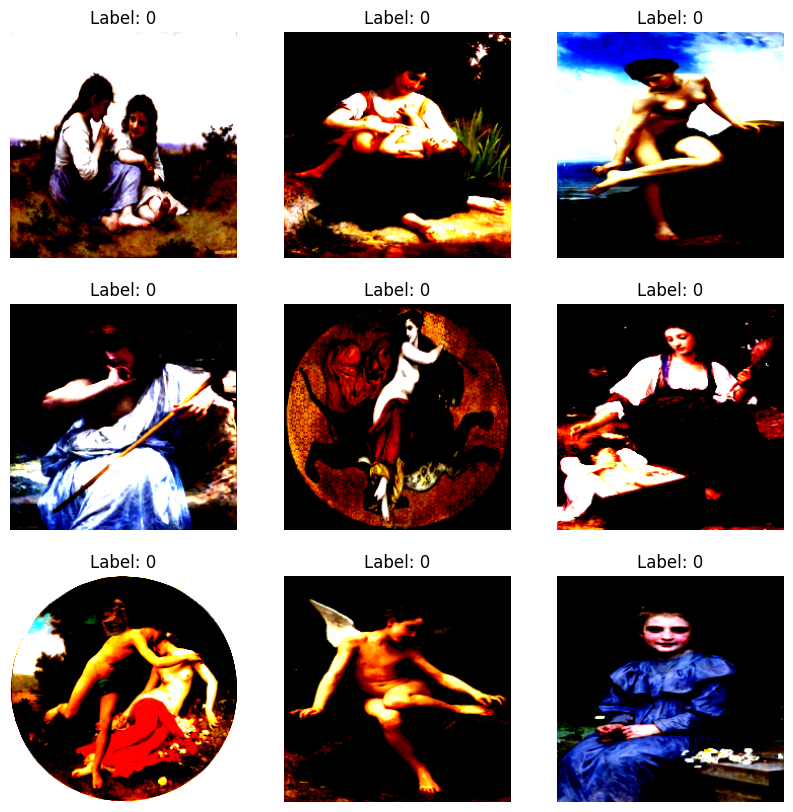

In [2]:
import torch
import matplotlib.pyplot as plt
import numpy as np
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
import albumentations as A

# Пути к данным
train_path = "/загрузки/train"
test_path = "/загрузки/test"

# Albumentations аугментации для обучающего набора данных
train_transform = A.Compose([
    A.Resize(256, 256),
    A.RandomResizedCrop(224, 224),
    A.HorizontalFlip(),
    A.Rotate(limit=20),
    A.RandomBrightnessContrast(),
    A.Normalize(),
    A.pytorch.transforms.ToTensorV2(),
])

# Преобразование для тестового набора данных
test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Загрузка данных
train_data = ImageFolder(root=train_path, transform=train_transform)
test_data = ImageFolder(root=test_path, transform=test_transform)

# Визуализация обработанных изображений из тестового набора данных
plt.figure(figsize=(10, 10))
for i in range(9):
    image, label = test_data[i]
    image = image.permute(1, 2, 0)  # Переставляем каналы для правильного отображения
    image = image.numpy()
    plt.subplot(3, 3, i + 1)
    plt.imshow(image)
    plt.title(f"Label: {label}")
    plt.axis("off")
plt.show()


NameError: name 'titles' is not defined

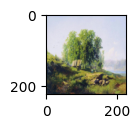

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np

# Выбираем случайные изображения из тестового набора данных
num_samples = 5
random_indices = torch.randint(0, len(test_data), (num_samples,))

# Создаем новый график
plt.figure(figsize=(12, 6))

# Проходим по выбранным случайным индексам
for i, idx in enumerate(random_indices):
    # Получаем оригинальное и предобработанное изображения из тестового набора данных
    original_image, _ = test_data[idx]
    processed_image, _ = test_data[idx]
    
    # Преобразуем тензоры в numpy массивы
    original_image = original_image.permute(1, 2, 0).numpy()
    processed_image = processed_image.permute(1, 2, 0).numpy()
    
    # Восстанавливаем нормализацию для отображения
    original_image = (original_image * np.array([0.229, 0.224, 0.225])) + np.array([0.485, 0.456, 0.406])
    processed_image = (processed_image * np.array([0.229, 0.224, 0.225])) + np.array([0.485, 0.456, 0.406])
    
    # Отображаем оригинальное и предобработанное изображения рядом
    plt.subplot(num_samples, 2, 2*i+1)
    plt.imshow(original_image)
    plt.title(titles[0])
    plt.axis('off')
    
    plt.subplot(num_samples, 2, 2*i+2)
    plt.imshow(processed_image)
    plt.title(titles[1])
    plt.axis('off')

plt.tight_layout()
plt.show()


In [32]:
 datasets = '/загрузки/archive_img'

In [16]:

def apply_transform(img: Image, transform) -> np.ndarray:
    """
    Applies a transform to a PIL Image and returns a numpy array of the transformed image.

    Args:
        img (PIL.Image): The input image to transform.
        transform (torchvision.transforms.Compose): The transform to apply to the image.

    Returns:
        np.ndarray: A numpy array representing the transformed image.
    """
    # Apply the transform to the image
    if isinstance(transform, torchvision.transforms.Compose):
        # Apply PyTorch transform to image array
        transformed_image = train_transforms(img)

    elif isinstance(transform, A.Compose):
        # Apply Albumentations transform to image array
        img_array = np.array(img)
        transformed_image = transform(image=img_array)["image"]

    # Convert the image tensor to a numpy array and transpose the axes to (height, width, channels)
    img_array = transformed_image.numpy().transpose((1, 2, 0))

    # Clip the pixel values to the range [0, 1]
    img_array = np.clip(img_array, 0, 1)

    return img_array


def visualize_transform(image: np.ndarray, original_image: np.ndarray = None) -> None:
    """
    Visualize the transformed image.

    Args:
        image (np.ndarray): A NumPy array representing the transformed image.
        original_image (np.ndarray, optional): A NumPy array representing the original image. Defaults to None.
    """
    fontsize = 18
    
    if original_image is None:
        # Create a plot with 1 row and 2 columns.
        f, ax = plt.subplots(1, 2, figsize=(12, 12))

        # Show the transformed image in the first column.
        ax[0].imshow(image)
    else:
        # Create a plot with 1 row and 2 columns.
        f, ax = plt.subplots(1, 2, figsize=(12, 12))

        # Show the original image in the first column.
        ax[0].imshow(original_image)
        ax[0].set_title('Original image', fontsize=fontsize)
        
        # Show the transformed image in the second column.
        ax[1].imshow(image)
        ax[1].set_title('Transformed image', fontsize=fontsize)
        
img = Image.open(random.choice(train_image_path_list))
img_array = apply_transform(img, train_transforms)
visualize_transform(img_array, original_image=img)

NameError: name 'train_transforms' is not defined

In [3]:
BATCH_SIZE = 64
test_path="/загрузки/test"
train_path="/загрузки/train"

In [4]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def get_generator(_training_dir, _test_dir):
    # Создаем генераторы изображений для тренировочного и тестового наборов данных
    train_datagen = ImageDataGenerator(
        rescale=1/255.0,
        rotation_range=18,          # Диапазон углов поворота
        width_shift_range=0.1,      # Диапазон сдвига по ширине
        height_shift_range=0.1,     # Диапазон сдвига по высоте
        shear_range=0.1,            # Диапазон сдвига
        zoom_range=0.1,             # Диапазон увеличения
        horizontal_flip=True,       # Отражение по горизонтали
        fill_mode='nearest'         # Метод заполнения пикселей за пределами границ
    )

    test_datagen = ImageDataGenerator(rescale=1/255.0)

    # Создаем генераторы изображений для тренировочного и тестового наборов данных
    train_generator = train_datagen.flow_from_directory(
        _training_dir,
        target_size=(350, 350),     # Размер изображений
        batch_size=64,              # Размер пакета
        class_mode='categorical'    # Режим классификации
    )

    test_generator = test_datagen.flow_from_directory(
        _test_dir,
        target_size=(350,350),     # Размер изображений
        batch_size=64,              # Размер пакета
        class_mode='categorical'    # Режим классификации
    )

    return train_generator, test_generator


In [5]:
def plotter(history):
    #summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

In [6]:
def get_defined_label(x):
    label_dict = {0:'Academic_Art', 1:'Japanese_Art', 2:'Symbolism',3: 'Romanticism', 4:'Rococo',
          5:'Renaissance', 6:'Art_Nouveau',
          7:'Realism',8:'Expressionism',9:'Primitivism', 10:'Baroque', 11:'Neoclassicism'}
    for key, value in label_dict:
        if key == x:
            return value
        

In [18]:
# def get_defined_label(x):
#     label_dict = {0:'Ukiyo_e', 1:'Synthetic_Cubism', 2:'Symbolism',3: 'Romanticism', 4:'Rococo',
#           5:'Realism', 6:'Pop_Art',
#           7:'Impressionism',8:'Expressionism',9:'Cubism',10:'Baroque'}
#     for key, value in label_dict:
#         if key == x:
#             return value

In [57]:
# def get_defined_label(x):
#     label_dict = {0:'Ukiyo_e', 1:'Synthetic_Cubism', 2:'Symbolism',3: 'Romanticism', 4:'Rococo',
#           5:'Realism', 6:'Post_Impressionism', 7:'Pop_Art', 8:'Pointillism', 9:'Northern_Renaissance',
#           10:'New_Realism', 11:'Naive_Art_Primitivism', 12:'Minimalism',13:'Mannerism_Late_Renaissance',
#           14:'Impressionism',15:'High_Renaissance',16:'Fauvism',17:'Expressionism',18:'Early_Renaissance',19:'Cubism',
#           20:'Contemporary_Realism',21:'Color_Field_Painting',22:'Baroque',23:'Art_Nouveau_Modern',24:'Analytical_Cubism',
#           25:'Action_painting',26:'Abstract_Expressionism'}
#     for key, value in label_dict:
#         if key == x:
#             return value

In [18]:
from keras.applications import InceptionResNetV2


In [ ]:
# BATCH_SIZE = 64
# EPOCHS = 15
# LEARNING_RATE = 3e-4
# HEIGHT = 320
# WIDTH = 320
# CHANNELS = 3
# ES_PATIENCE = 5
# RLROP_PATIENCE = 3
# DECAY_DROP = 0.5
# BACKBONE = 'resnet34'

In [41]:
INPUT_SHAPE = (350,350,3)
def get_initialized_model(INPUT_SHAPE):
    base_model = InceptionResNetV2(
        input_shape=INPUT_SHAPE,
        weights='imagenet',
        include_top=False,
        pooling='avg'
    )
    base_model.trainable = False
    
    print('Base Model Ouput Shape = {}'.format(base_model.output_shape))
    last_output = base_model.output
    x = tf.keras.layers.Dropout(0.2)(last_output)
    x = tf.keras.layers.Dense(units=128, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.2)(x)
    x = tf.keras.layers.Dense(units=128, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.2)(x)
    x = tf.keras.layers.Dense(units = 12, activation='softmax')(x)
    
    model = tf.keras.Model( base_model.input, x) 

    model.compile(
        optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.0001, momentum=0.9, centered=True), 
        loss = ['categorical_crossentropy'], 
        metrics = ['accuracy']
    )

    model_callback = [tf.keras.callbacks.EarlyStopping(
        monitor='val_loss', 
        min_delta=0.001, 
        patience=5, 
        verbose=1,
        mode='auto', 
        baseline=None, 
        restore_best_weights=True
    ), tf.keras.callbacks.ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=1,
        min_delta=0.0000001,
        verbose=1 
    )]
    
    return model, model_callback

In [14]:
INPUT_SHAPE = (350,350,3)
def get_initialized_model(INPUT_SHAPE):
    base_model = tf.keras.applications.VGG16(
        input_shape=INPUT_SHAPE,
        weights='imagenet',
        include_top=False,
        pooling='avg'
    )
    base_model.trainable = False
    
    print('Base Model Ouput Shape = {}'.format(base_model.output_shape))
    last_output = base_model.output
    x = tf.keras.layers.Dropout(0.2)(last_output)
    x = tf.keras.layers.Dense(units=128, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.2)(x)
    x = tf.keras.layers.Dense(units=128, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.2)(x)
    x = tf.keras.layers.Dense(units=12, activation='softmax')(x)
    
    model = tf.keras.Model(base_model.input, x) 

    model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001, momentum=0.9, centered=True), 
        loss='categorical_crossentropy', 
        metrics=['accuracy']
    )

    model_callback = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', 
            min_delta=0.001, 
            patience=5, 
            verbose=1,
            mode='auto', 
            baseline=None, 
            restore_best_weights=True
        ), 
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.1,
            patience=1,
            min_delta=0.0000001,
            verbose=1 
        )
    ]
    
    return model, model_callback


In [15]:
from tensorflow.keras.optimizers import Adam

# Получение генераторов данных
train_generator, test_generator = get_generator(train_path, test_path)

# Получение и инициализация модели
model, model_callbacks = get_initialized_model(INPUT_SHAPE)

# Компиляция модели с использованием оптимизатора Adam
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Обучение модели
history = model.fit(train_generator, epochs=40, validation_data=test_generator,callbacks=[model_callbacks])


NameError: name 'get_generator' is not defined

In [13]:
INPUT_SHAPE = (350,350,3)
import numpy as np 
import pandas as pd 
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg
import plotly.express as px
from tensorflow.keras.preprocessing.image import ImageDataGenerator 
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2

In [39]:
history = model.fit_generator(train_generator, epochs=30, validation_data=test_generator, callbacks=[model_callbacks])

C:\Users\SG\AppData\Local\Temp\ipykernel_18800\3474141498.py:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(train_generator, epochs=30, validation_data=test_generator, callbacks=[model_callbacks])
d:\Сириус\.venv\lib\site-packages\keras\src\preprocessing\image.py:1862: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(
d:\Сириус\.venv\lib\site-packages\keras\src\preprocessing\image.py:1872: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(


Epoch 1/30


696/696 [==============================] - 1172s 2s/step - loss: 1.8039 - accuracy: 0.3408 - val_loss: 1.6139 - val_accuracy: 0.4281 - lr: 1.0000e-04
Epoch 2/30
696/696 [==============================] - 1532s 2s/step - loss: 1.6501 - accuracy: 0.3994 - val_loss: 1.5623 - val_accuracy: 0.4399 - lr: 1.0000e-04
Epoch 3/30
696/696 [==============================] - 1404s 2s/step - loss: 1.6132 - accuracy: 0.4174 - val_loss: 1.5418 - val_accuracy: 0.4549 - lr: 1.0000e-04
Epoch 4/30
696/696 [==============================] - 1362s 2s/step - loss: 1.5959 - accuracy: 0.4258 - val_loss: 1.4953 - val_accuracy: 0.4590 - lr: 1.0000e-04
Epoch 5/30
696/696 [==============================] - ETA: 0s - loss: 1.5835 - accuracy: 0.4295
Epoch 5: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.
696/696 [==============================] - 1367s 2s/step - loss: 1.5835 - accuracy: 0.4295 - val_loss: 1.5072 - val_accuracy: 0.4547 - lr: 1.0000e-04
Epoch 6/30
696/696 [============

KeyboardInterrupt: 

In [140]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dropout, Dense, GlobalAveragePooling2D

def get_initialized_model(INPUT_SHAPE):
    base_model = VGG16(
        input_shape=INPUT_SHAPE,
        weights='imagenet',
        include_top=False,
        pooling='avg'
    )
    base_model.trainable = False
    
    print('Base Model Ouput Shape = {}'.format(base_model.output_shape))
    last_output = base_model.output
    x = Dropout(0.2)(last_output)
    x = Dense(units=128, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(units=128, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(units=27, activation='softmax')(x)
    
    model = tf.keras.Model(base_model.input, x) 

    model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001, momentum=0.9, centered=True), 
        loss='categorical_crossentropy', 
        metrics=['accuracy']
    )

    model_callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', 
            min_delta=0.001, 
            patience=5, 
            verbose=1,
            mode='auto', 
            baseline=None, 
            restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.1,
            patience=1,
            min_delta=0.0000001,
            verbose=1 
        )
    ]
     
    return model, model_callbacks


In [26]:
root_path = '/загрузки/archive_art'

In [27]:
train_val_gen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    horizontal_flip = True,
    validation_split=0.1
)

test_gen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

# Load Data
train_ds = train_val_gen.flow_from_directory(root_path, target_size=(256,256), class_mode="binary", batch_size=32, shuffle=True, subset='training')
valid_ds = train_val_gen.flow_from_directory(root_path, target_size=(256,256), class_mode="binary", batch_size=32, shuffle=True, subset='validation')
test_ds = test_gen.flow_from_directory(root_path, target_size=(256,256), class_mode="binary", batch_size=32, subset='validation')

Found 73311 images belonging to 27 classes.
Found 8133 images belonging to 27 classes.
Found 16278 images belonging to 27 classes.


In [15]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout


In [28]:
# Model to be used
name="ResNet50V2"

# Load the Base Model
base_model = ResNet50V2(include_top=False, weights='imagenet', input_shape=(256,256,3))
base_model.trainable = False

# Model
model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(256,activation='relu'),
    Dropout(0.2),
    Dense(27, activation='softmax')
], name=name)

# Compile Model
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)

# Callbacks
callbacks = [EarlyStopping(patience=5, restore_best_weights=True), ModelCheckpoint(name + ".h5", save_best_only=True)]

In [19]:
train_generator, test_generator = get_generator(train_path, test_path)
model, model_callbacks = get_initialized_model(INPUT_SHAPE)

Found 65155 images belonging to 27 classes.
Found 16289 images belonging to 27 classes.


NameError: name 'get_initialized_model' is not defined

In [60]:
history = model.fit(train_generator, epochs=100, validation_data=test_generator, callbacks=[model_callbacks])


Epoch 1/100
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 0s 983ms/step - accuracy: 0.2123 - loss: 2.5835

d:\Сириус\.venv\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


2037/2037 ━━━━━━━━━━━━━━━━━━━━ 2467s 1s/step - accuracy: 0.2123 - loss: 2.5834 - val_accuracy: 0.2920 - val_loss: 2.2737 - learning_rate: 1.0000e-04
Epoch 2/100
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 2365s 1s/step - accuracy: 0.2720 - loss: 2.3426 - val_accuracy: 0.3101 - val_loss: 2.2297 - learning_rate: 1.0000e-04
Epoch 3/100
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 2331s 1s/step - accuracy: 0.2859 - loss: 2.3027 - val_accuracy: 0.3146 - val_loss: 2.1791 - learning_rate: 1.0000e-04
Epoch 4/100
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 2290s 1s/step - accuracy: 0.2922 - loss: 2.2926 - val_accuracy: 0.3202 - val_loss: 2.1690 - learning_rate: 1.0000e-04
Epoch 5/100
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 0s 947ms/step - accuracy: 0.2897 - loss: 2.2859
Epoch 5: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 2373s 1s/step - accuracy: 0.2897 - loss: 2.2860 - val_accuracy: 0.3241 - val_loss: 2.1701 - learning_rate: 1.0000e-04
Epoch 6/100
2037/2037 ━━━━━━━━━━━━━━━━━━━━ 2328s 1s/

174/174 [==============================] - 889s 5s/step - loss: 1.2894 - accuracy: 0.5313


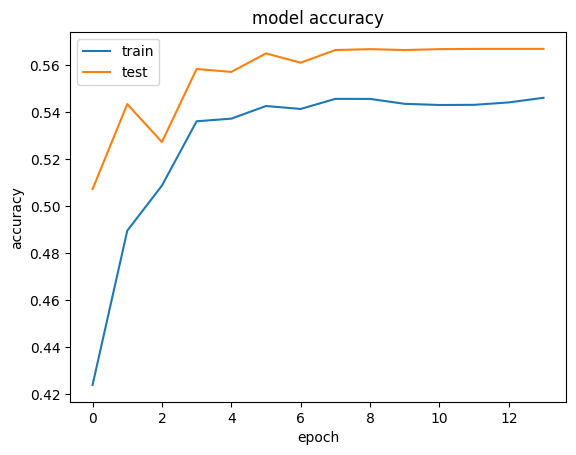

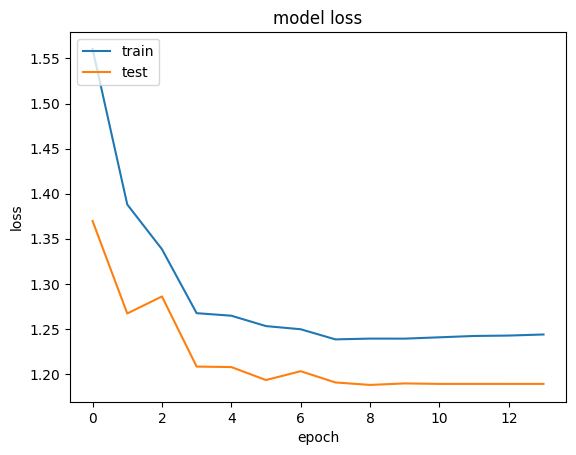

TypeError: 'History' object is not iterable

In [21]:
score = model.fit(test_generator)
plotter(history)
print('\nScore [ {} ] '.format(dict(zip(model.metrics_names, score))))

In [22]:
for layer in model.layers[-100:]:
    layer.trainable=True

for i, layer in enumerate(model.layers):
    print(i, layer.name, layer.trainable)

0 input_2 False
1 conv2d_203 False
2 batch_normalization_203 False
3 activation_203 False
4 conv2d_204 False
5 batch_normalization_204 False
6 activation_204 False
7 conv2d_205 False
8 batch_normalization_205 False
9 activation_205 False
10 max_pooling2d_4 False
11 conv2d_206 False
12 batch_normalization_206 False
13 activation_206 False
14 conv2d_207 False
15 batch_normalization_207 False
16 activation_207 False
17 max_pooling2d_5 False
18 conv2d_211 False
19 batch_normalization_211 False
20 activation_211 False
21 conv2d_209 False
22 conv2d_212 False
23 batch_normalization_209 False
24 batch_normalization_212 False
25 activation_209 False
26 activation_212 False
27 average_pooling2d_1 False
28 conv2d_208 False
29 conv2d_210 False
30 conv2d_213 False
31 conv2d_214 False
32 batch_normalization_208 False
33 batch_normalization_210 False
34 batch_normalization_213 False
35 batch_normalization_214 False
36 activation_208 False
37 activation_210 False
38 activation_213 False
39 activation_

In [23]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-5), 
    loss = ['categorical_crossentropy'], 
    metrics = ['accuracy']
)    

model_callback_new = [tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', 
    min_delta=0.001, 
    patience=3, 
    verbose=1,
    mode='auto', 
    baseline=None, 
    restore_best_weights=True
), tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=1,
    min_delta=0.00000001,
    verbose=1 
)]

In [30]:
BATCH_SIZE = 64

In [31]:
train_generator.reset()
test_generator.reset()

history = model.fit(
    train_generator,
    epochs=25,
    steps_per_epoch=14034//BATCH_SIZE,
    validation_data=test_generator,
    validation_steps=3000//BATCH_SIZE,
    callbacks=[model_callback_new]
)

Epoch 1/25
219/219 [==============================] - 1589s 7s/step - loss: 1.4086 - accuracy: 0.4799 - val_loss: 1.2218 - val_accuracy: 0.5583 - lr: 1.0000e-05
Epoch 2/25
219/219 [==============================] - 1763s 8s/step - loss: 1.2733 - accuracy: 0.5340 - val_loss: 1.1816 - val_accuracy: 0.5678 - lr: 1.0000e-05
Epoch 3/25
219/219 [==============================] - 1956s 9s/step - loss: 1.2425 - accuracy: 0.5462 - val_loss: 1.1414 - val_accuracy: 0.5819 - lr: 1.0000e-05
Epoch 4/25
219/219 [==============================] - 1682s 8s/step - loss: 1.1928 - accuracy: 0.5621 - val_loss: 1.1327 - val_accuracy: 0.5920 - lr: 1.0000e-05
Epoch 5/25
219/219 [==============================] - 1965s 9s/step - loss: 1.1781 - accuracy: 0.5619 - val_loss: 1.1143 - val_accuracy: 0.6025 - lr: 1.0000e-05
Epoch 6/25
219/219 [==============================] - 1605s 7s/step - loss: 1.1524 - accuracy: 0.5802 - val_loss: 1.0808 - val_accuracy: 0.6130 - lr: 1.0000e-05
Epoch 7/25
219/219 [==============

174/174 [==============================] - 1109s 6s/step - loss: 1.0846 - accuracy: 0.6045


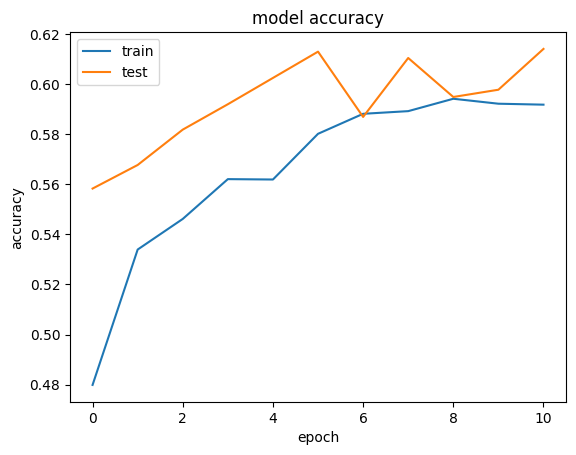

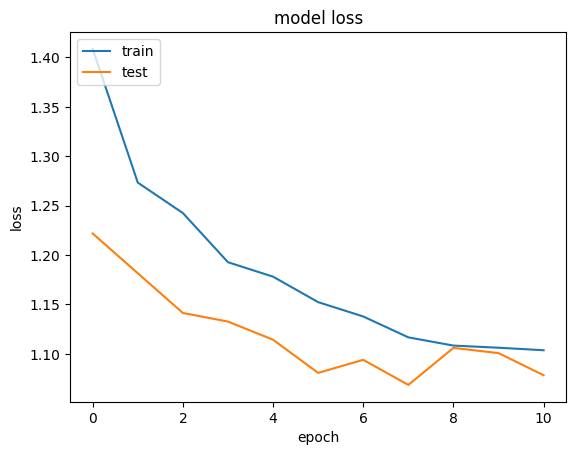


Score [ {'loss': 1.0846011638641357, 'accuracy': 0.6045262813568115} ] 


In [32]:
score = model.evaluate(test_generator)
plotter(history)
print('\nScore [ {} ] '.format(dict(zip(model.metrics_names, score))))


In [46]:
import zipfile
import os

def zip_directories(directory_list, zip_file):
    with zipfile.ZipFile(zip_file, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for directory in directory_list:
            for root, dirs, files in os.walk(directory):
                for file in files:
                    file_path = os.path.join(root, file)
                    try:
                        zipf.write(file_path, os.path.relpath(file_path, os.path.join(directory, '..')))
                    except (ValueError, RuntimeError) as e:
                        print(f"Ошибка при добавлении файла {file_path}: {e}")

# Пример использования
directories_to_zip = ["/загрузки/test_top_11", "/загрузки/train_top_11"]
zip_file_path = 'archive_art.zip'
zip_directories(directories_to_zip, zip_file_path)


In [40]:
folder_path="/загрузки/test_top_11"
folder_path="/загрузки/train_top_11"

In [45]:
import zipfile
import os
from concurrent.futures import ThreadPoolExecutor

def zip_directory(directory, zipf):
    print(f"Архивация директории: {directory}")
    file_count = sum(len(files) for _, _, files in os.walk(directory))
    files_archived = 0
    for root, dirs, files in os.walk(directory):
        for file in files:
            file_path = os.path.join(root, file)
            try:
                zipf.write(file_path, os.path.relpath(file_path, directory))
                files_archived += 1
                print(f"Архивировано файлов: {files_archived}/{file_count}", end='\r')
            except (ValueError, RuntimeError) as e:
                print(f"\nОшибка при добавлении файла {file_path}: {e}")
    print(f"\nДиректория {directory} успешно архивирована")

def zip_directories(directory_list, zip_file):
    with zipfile.ZipFile(zip_file, 'w', zipfile.ZIP_DEFLATED) as zipf:
        with ThreadPoolExecutor() as executor:
            for directory in directory_list:
                executor.submit(zip_directory, directory, zipf)

# Пример использования
directories_to_zip = ["/загрузки/test_top_11", "/загрузки/train_top_11"]
zip_file_path = 'archive_art.zip'
zip_directories(directories_to_zip, zip_file_path)


Архивация директории: /загрузки/test_top_11

Директория /загрузки/test_top_11 успешно архивирована
Архивация директории: /загрузки/train_top_11

Директория /загрузки/train_top_11 успешно архивирована


-------------------------------------------------------------------------------------------------------------------------------------------------

In [1]:
#import numpy for number array handling and represent rgb image pixel values
import numpy as np

#import tensorflow to use any tools needed for deep learning
import tensorflow as tf

#import keras api needed to implement deep learning techiques
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, Dense, BatchNormalization, Conv2D, MaxPool2D, GlobalAveragePooling2D, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator

#import libraries for visualization of data
import matplotlib.pyplot as plt

#Allow charts and graphics to display right below the page of browser setup
%matplotlib inline
from keras_preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras.applications import ResNet50V2, VGG16
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Input, MaxPool2D, BatchNormalization, Dropout, GlobalAveragePooling2D, Activation
from tensorflow.keras.models import Model
import pandas as pd
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import tensorflow as tf

In [2]:
test_path="/загрузки/test"
train_path="/загрузки/train"

In [3]:
train_batches= ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg16.preprocess_input,
    shear_range=0.2,
    zoom_range=0.2,
    width_shift_range=0.2,
    height_shift_range=0.2,
    validation_split=0.1).flow_from_directory(
    directory=train_path, target_size=(200,200), classes=['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 
                                                          'Renaissance', 'Art_Nouveau', 'Realism', 'Expressionism', 
                                                          'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism'], batch_size=64, subset='training')


# extract images to validation set
valid_batches = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg16.preprocess_input,
    validation_split=0.1).flow_from_directory(
    directory=test_path, target_size=(200,200), classes=['Academic_Art', 'Symbolism', 'Romanticism', 
                                                          'Rococo', 'Renaissance', 'Art_Nouveau', 'Realism',
                                                            'Expressionism', 'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism'], batch_size=64, subset='validation')

Found 28046 images belonging to 12 classes.
Found 786 images belonging to 12 classes.


In [5]:
def plotImages(images):
    fig, axes = plt.subplots(1, 12, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip(images, axes):
        ax.imshow(img.astype(np.uint8))
        ax.axis('off')
    plt.tight_layout()
    plt.show()

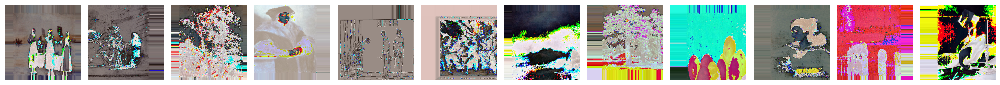

In [6]:
imgs, labels = next(train_batches)
plotImages(imgs)

In [7]:
# set the input image size for proposed CNN model
IMG_SIZE = 200
IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

# import the convolution base of the VGG16 model with pre-trained weights
base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE, 
                                        include_top=False,
                                        weights='imagenet')

In [8]:
base_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 200, 200, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 200, 200, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 200, 200, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 100, 100, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 100, 100, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 100, 100, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 50, 50, 128)       0     

In [9]:
model = Sequential()

# Freeze the convolutional base of VGG16 to prevent the pre-trained weights being updated 
# during training inorder to extract features
base_model.trainable=False

# add VGG16 convolution base to initialize sequential model
model.add(base_model)

# add global average pooling layer
model.add(GlobalAveragePooling2D())

# add densely-connected NN layer with 512 hidden units
model.add(Dense(units=512, activation='relu'))  # use ReLU activation function
model.add(BatchNormalization())                 # normalize and scale inputs or activations
model.add(Dropout(0.2))                         # applies dopout to the input which will randomly disable 20% of hidden units

# add densely-connected NN layer with 128 hidden units
model.add(Dense(units=128, activation='relu')) # use ReLU activation function
model.add(BatchNormalization())                # normalize and scale inputs or activations
model.add(Dropout(0.2))                        # applies dopout to the input which will randomly disable 20% of hidden units

# add densely-connected NN layer with 6 hidden units
model.add(Dense(units=12, activation='softmax')) # use Softmax activation function to do final predictions

In [10]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 6, 6, 512)         14714688  
                                                                 
 global_average_pooling2d (  (None, 512)               0         
 GlobalAveragePooling2D)                                         
                                                                 
 dense (Dense)               (None, 512)               262656    
                                                                 
 batch_normalization (Batch  (None, 512)               2048      
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 128)               6

In [11]:
# compile the built CNN model by selecting suitable optimizer and loss function
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [12]:
import os
import pandas as pd

# Список классов
class_names = ['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 
               'Renaissance', 'Art_Nouveau', 'Realism', 'Expressionism', 
               'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism']

# Функция для получения названий классов из папок датасета
def get_class_names(dataset_path):
    return [name for name in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, name))]

# Получение названий классов из обучающего и тестового датасетов
train_class_names = get_class_names(train_path)
test_class_names = get_class_names(test_path)

# Создание DataFrame с колонкой 'names', содержащей названия классов
art_movements = pd.DataFrame({'names': class_names})

# Вычисление весов классов
class_weights = {}
total_paintings = 0
for class_name in class_names:
    train_class_path = os.path.join(train_path, class_name)
    test_class_path = os.path.join(test_path, class_name)
    num_train_paintings = sum([len(files) for _, _, files in os.walk(train_class_path)])
    num_test_paintings = sum([len(files) for _, _, files in os.walk(test_class_path)])
    total_paintings += num_train_paintings + num_test_paintings

for i, class_name in enumerate(class_names):
    train_class_path = os.path.join(train_path, class_name)
    test_class_path = os.path.join(test_path, class_name)
    num_train_paintings = sum([len(files) for _, _, files in os.walk(train_class_path)])
    num_test_paintings = sum([len(files) for _, _, files in os.walk(test_class_path)])
    class_weights[i] = total_paintings / (len(class_names) * (num_train_paintings + num_test_paintings))

# Вывод результатов
print("Class Weights:")
print(class_weights)
print("\nClass Names:")
print(class_names)


Class Weights:
{0: 2.5436197916666665, 1: 2.2058491418247517, 2: 0.4915207326892109, 3: 1.295080880403076, 4: 0.618979721166033, 5: 1.3476131346578366, 6: 0.6159351746752427, 7: 1.3262050237610319, 8: 1.512230995510141, 9: 0.6185093718338399, 10: 2.4628088754412505, 11: 1.0780905077262692}

Class Names:
['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 'Renaissance', 'Art_Nouveau', 'Realism', 'Expressionism', 'Japanese_Art', 'Baroque', 'Primitivism', 'Neoclassicism']


In [13]:
# Loading artworks and splitting data for training and validation
batch_size = 64
train_input_shape = (256, 256, 3)

datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range= 5,
    zoom_range=0.05,
    horizontal_flip=True,
    validation_split=0.1
)

train_generator = datagen.flow_from_directory(
    train_path,
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='categorical',
    shuffle =True,
    subset='training',
    seed=123,
    classes=['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 
               'Renaissance', 'Art_Nouveau', 'Realism', 'Expressionism', 
               'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism']
)

validation_generator = datagen.flow_from_directory(
    test_path,
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='categorical',
    shuffle =True,
    subset='validation',
    seed=123,
    classes=['Academic_Art', 'Symbolism', 'Romanticism', 'Rococo', 
               'Renaissance', 'Art_Nouveau', 'Realism', 'Expressionism', 
               'Japanese_Art', 'Baroque','Primitivism', 'Neoclassicism']
)

Found 28046 images belonging to 12 classes.
Found 786 images belonging to 12 classes.


In [14]:
# Adding model steps
Step_Train = train_generator.n//train_generator.batch_size
Step_Validation = validation_generator.n//validation_generator.batch_size
print("Total number of batches =", Step_Train, "and", Step_Validation)

Total number of batches = 438 and 12


In [15]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, 
                              verbose=1, mode='auto')

early_stop = EarlyStopping(monitor='val_accuracy', patience=3, verbose=1, 
                           mode='auto', restore_best_weights=True)


In [16]:
base_model = ResNet50V2(weights='imagenet', include_top=False, input_shape=(256,256,3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = True
    

In [17]:
# Add extra layers to model
output = base_model.output

output = Flatten()(output)

output = Dense(256, kernel_initializer='he_uniform')(output)
output = Dropout(0.5)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(128, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(64, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(32, kernel_initializer='he_uniform')(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(1, activation='sigmoid')(output)

model = Model(inputs=base_model.inputs, outputs=output)

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 262, 262, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 128, 128, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 pool1_pad (ZeroPadding2D)   (None, 130, 130, 64)         0         ['conv1_conv[0][0]']          
                                                                                              

In [21]:
from keras.metrics import Precision, Recall

# Определение функции для вычисления F1-score
def f1_score(y_true, y_pred):
    precision = Precision()(y_true, y_pred)
    recall = Recall()(y_true, y_pred)
    return 2 * ((precision * recall) / (precision + recall + tf.keras.backend.epsilon()))

# Используй функции precision и recall из keras.metrics для вычисления точности и полноты
model.compile(loss='categorical_crossentropy', optimizer=adam , metrics=['accuracy', f1_score, Precision(), Recall()])


In [30]:
from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.metrics import Precision, Recall
from keras import backend as K

# Определение метрики f1_score
def f1_score(y_true, y_pred):
    precision_val = Precision()(y_true, y_pred)
    recall_val = Recall()(y_true, y_pred)
    return 2 * ((precision_val * recall_val) / (precision_val + recall_val + K.epsilon()))

# Задание оптимизатора
adam = Adam(learning_rate=0.0001)

# Создание модели
model = Sequential()
# Добавление слоев
model.add(Dense(64, activation='relu', input_shape=(256, 256, 3)))  # Исправлено
model.add(Dense(12, activation='softmax'))  # softmax для многоклассовой классификации

# Компиляция модели с заданными метриками
model.compile(loss='categorical_crossentropy', 
              optimizer=adam, 
              metrics=['accuracy', Precision(), Recall(), f1_score])
history = model.fit(train_generator, 
                    validation_data=validation_generator,
                    steps_per_epoch=Step_Train, 
                    validation_steps=Step_Validation,
                    epochs=30,
                    shuffle=True,
                    verbose=1,
                    callbacks=[reduce_lr, early_stop],
                    class_weight=class_weights
                   )


Epoch 1/30


ValueError: in user code:

    File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1151, in train_step
        loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1209, in compute_loss
        return self.compiled_loss(
    File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\compile_utils.py", line 277, in __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "d:\Сириус\.venv\lib\site-packages\keras\src\losses.py", line 143, in __call__
        losses = call_fn(y_true, y_pred)
    File "d:\Сириус\.venv\lib\site-packages\keras\src\losses.py", line 270, in call  **
        return ag_fn(y_true, y_pred, **self._fn_kwargs)
    File "d:\Сириус\.venv\lib\site-packages\keras\src\losses.py", line 2221, in categorical_crossentropy
        return backend.categorical_crossentropy(
    File "d:\Сириус\.venv\lib\site-packages\keras\src\backend.py", line 5573, in categorical_crossentropy
        target.shape.assert_is_compatible_with(output.shape)

    ValueError: Shapes (None, None) and (None, None, None, 12) are incompatible


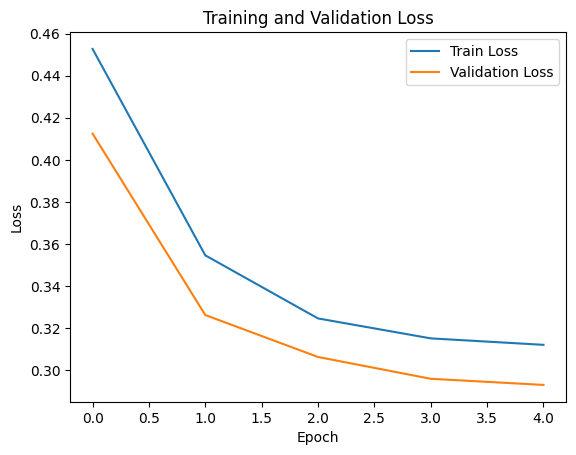

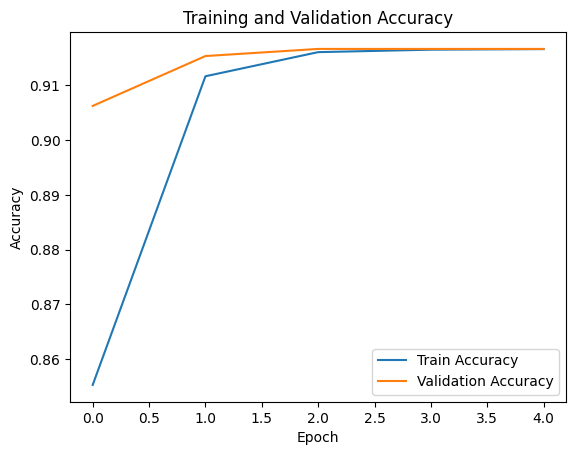

In [25]:
# График потерь на тренировочном и валидационном наборе данных
import matplotlib.pyplot as plt

# Получение истории потерь и точности из объекта history
train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Построение графика потерь
plt.plot(train_loss, label='Train Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Построение графика точности
plt.plot(train_accuracy, label='Train Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [27]:
from sklearn.metrics import classification_report

# Получение предсказаний модели для валидационного набора данных
y_pred = model.predict(validation_generator)

# Преобразование предсказаний в метки классов
y_pred_classes = np.argmax(y_pred, axis=1)

# Получение истинных меток классов для валидационного набора данных
y_true = validation_generator.classes

# Оценка precision и recall
report = classification_report(y_true, y_pred_classes, target_names=class_names)

# Вывод отчета
print(report)


11/11 [==============================] - 19s 2s/step


ValueError: Number of classes, 11, does not match size of target_names, 12. Try specifying the labels parameter

In [60]:
# Freeze core ResNet layers
for layer in model.layers:
    layer.trainable = False

for layer in model.layers[:50]:
    layer.trainable = True

model.compile(loss='categorical_crossentropy',
              optimizer=adam, 
              metrics=['accuracy'])


# Training
history = model.fit(train_generator, 
                    validation_data=validation_generator,
                    steps_per_epoch=Step_Train, 
                    validation_steps=Step_Validation,
                    epochs=20,
                    shuffle=True,
                    verbose=1,
                    callbacks=[reduce_lr, early_stop],
                    class_weight=class_weights
                   )

# График потерь на тренировочном и валидационном наборе данных
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

# График точности на тренировочном и валидационном наборе данных
plt.plot(history.history['accuracy'], label='train_accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.show()


Epoch 1/20


d:\Сириус\.venv\lib\site-packages\tensorflow\python\util\dispatch.py:1260: SyntaxWarning: In loss categorical_crossentropy, expected y_pred.shape to be (batch_size, num_classes) with num_classes > 1. Received: y_pred.shape=(None, 1). Consider using 'binary_crossentropy' if you only have 2 classes.
  return dispatch_target(*args, **kwargs)


InvalidArgumentError: Graph execution error:

Detected at node gradient_tape/model_2/dense_20/MatMul/MatMul defined at (most recent call last):
  File "C:\Users\SG\AppData\Local\Programs\Python\Python310\lib\runpy.py", line 196, in _run_module_as_main

  File "C:\Users\SG\AppData\Local\Programs\Python\Python310\lib\runpy.py", line 86, in _run_code

  File "d:\Сириус\.venv\lib\site-packages\ipykernel_launcher.py", line 17, in <module>

  File "d:\Сириус\.venv\lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\kernelapp.py", line 739, in start

  File "d:\Сириус\.venv\lib\site-packages\tornado\platform\asyncio.py", line 205, in start

  File "C:\Users\SG\AppData\Local\Programs\Python\Python310\lib\asyncio\base_events.py", line 603, in run_forever

  File "C:\Users\SG\AppData\Local\Programs\Python\Python310\lib\asyncio\base_events.py", line 1909, in _run_once

  File "C:\Users\SG\AppData\Local\Programs\Python\Python310\lib\asyncio\events.py", line 80, in _run

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\kernelbase.py", line 542, in dispatch_queue

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\kernelbase.py", line 531, in process_one

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\kernelbase.py", line 437, in dispatch_shell

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\ipkernel.py", line 359, in execute_request

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\kernelbase.py", line 775, in execute_request

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\ipkernel.py", line 446, in do_execute

  File "d:\Сириус\.venv\lib\site-packages\ipykernel\zmqshell.py", line 549, in run_cell

  File "d:\Сириус\.venv\lib\site-packages\IPython\core\interactiveshell.py", line 3051, in run_cell

  File "d:\Сириус\.venv\lib\site-packages\IPython\core\interactiveshell.py", line 3106, in _run_cell

  File "d:\Сириус\.venv\lib\site-packages\IPython\core\async_helpers.py", line 129, in _pseudo_sync_runner

  File "d:\Сириус\.venv\lib\site-packages\IPython\core\interactiveshell.py", line 3311, in run_cell_async

  File "d:\Сириус\.venv\lib\site-packages\IPython\core\interactiveshell.py", line 3493, in run_ast_nodes

  File "d:\Сириус\.venv\lib\site-packages\IPython\core\interactiveshell.py", line 3553, in run_code

  File "C:\Users\SG\AppData\Local\Temp\ipykernel_28220\3710469351.py", line 14, in <module>

  File "d:\Сириус\.venv\lib\site-packages\keras\src\utils\traceback_utils.py", line 65, in error_handler

  File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1807, in fit

  File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1401, in train_function

  File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1384, in step_function

  File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1373, in run_step

  File "d:\Сириус\.venv\lib\site-packages\keras\src\engine\training.py", line 1154, in train_step

  File "d:\Сириус\.venv\lib\site-packages\keras\src\optimizers\optimizer.py", line 543, in minimize

  File "d:\Сириус\.venv\lib\site-packages\keras\src\optimizers\optimizer.py", line 276, in compute_gradients

Matrix size-incompatible: In[0]: [64,12], In[1]: [32,1]
	 [[{{node gradient_tape/model_2/dense_20/MatMul/MatMul}}]] [Op:__inference_train_function_69427]

In [20]:
from keras.callbacks import Callback
import sys

# Создание класса для отслеживания изменения метрик во время обучения
class MetricsTracker(Callback):
    def on_epoch_end(self, epoch, logs=None):
        print("\nEpoch {} - Loss: {:.4f} - Accuracy: {:.4f} - Validation Loss: {:.4f} - Validation Accuracy: {:.4f}".format(
            epoch + 1, logs['loss'], logs['accuracy'], logs['val_loss'], logs['val_accuracy']))

    def on_batch_end(self, batch, logs=None):
        sys.stdout.write('\r')
        sys.stdout.write("Batch {} - Loss: {:.4f} - Accuracy: {:.4f}".format(
            batch + 1, logs['loss'], logs['accuracy']))
        sys.stdout.flush()

# Создание экземпляра класса обратного вызова
metrics_tracker = MetricsTracker()

# Добавление обратного вызова в метод fit
model_details = model.fit(x=train_batches, validation_data=valid_batches, epochs=20, verbose=0, callbacks=[metrics_tracker])


Batch 3 - Loss: 3.3794 - Accuracy: 0.1198

KeyboardInterrupt: 

In [ ]:
# store the losses of training
loss = model_details.history['loss']
validation_loss = model_details.history['val_loss']

In [ ]:
# store the accuracy of training
accuracy = model_details.history['accuracy']
validation_accuracy = model_details.history['val_accuracy']

In [ ]:
# unfreeze the convolution base of VGG16 inorder to fine-tune which adapt these pre-trained weights 
# to work with the new dataset
base_model.trainable=True

In [ ]:
# summary of the fine-tune CNN model
model.summary()

-------------------------------------------------------------------------------------------------------------------------

In [9]:
#Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
import os
from tqdm import tqdm, tqdm_notebook
import random
import imageio
import shutil
import cv2
from PIL import Image


import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.applications import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.initializers import *
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from numpy.random import seed
seed(1)

In [2]:
art = "/загрузки/archive"

In [2]:
import numpy as np
import pandas as pd
import os
import random
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt 
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Layer, Flatten, Embedding, Reshape
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense, Input
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tqdm import tqdm
import plotly.express as px

plt.rcParams['font.size'] =  12

In [3]:
train_dir = "/загрузки/train"
test_dir = "/загрузки/test"

In [4]:
training_data = []
test_data = []
labels = os.listdir(train_dir)
for folder in os.listdir(train_dir):
    training_data.append(len(os.listdir(os.path.join(train_dir,folder))))
    
for folder in os.listdir(test_dir):
    test_data.append(len(os.listdir(os.path.join(test_dir,folder))))

In [5]:
fig = px.bar(x=labels, y=training_data, title='Class Count Training Data')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [6]:
fig = px.bar(x=labels, y=test_data, title='Class Count Test Data')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [7]:
# batch_size = 32
# img_size = 224

# datagen = ImageDataGenerator(rescale=1/255.,
#                              zoom_range=0.2,
#                              horizontal_flip=True,
#                              validation_split=0.15)

# test_datagen = ImageDataGenerator(rescale=1/255.)

# train_generator = datagen.flow_from_directory(train_dir,  
#                                                 target_size=(img_size, img_size), 
#                                                 batch_size=batch_size,
#                                                 shuffle=True,
#                                                 subset='training',
#                                                 class_mode='categorical')  

# validation_generator = datagen.flow_from_directory(train_dir,
#                                                     target_size=(img_size, img_size),
#                                                     batch_size=batch_size,
#                                                     shuffle=False,
#                                                     subset='validation',
#                                                     class_mode='categorical')

# test_generator = test_datagen.flow_from_directory(test_dir,
#                                                  target_size=(img_size, img_size),
#                                                  batch_size=batch_size,
#                                                  shuffle=False,
#                                                  class_mode='categorical')

Found 28907 images belonging to 13 classes.
Found 5093 images belonging to 13 classes.
Found 8500 images belonging to 13 classes.


d:\Сириус\.venv\lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



ValueError: Argument(s) not recognized: {'lr': 0.0001}

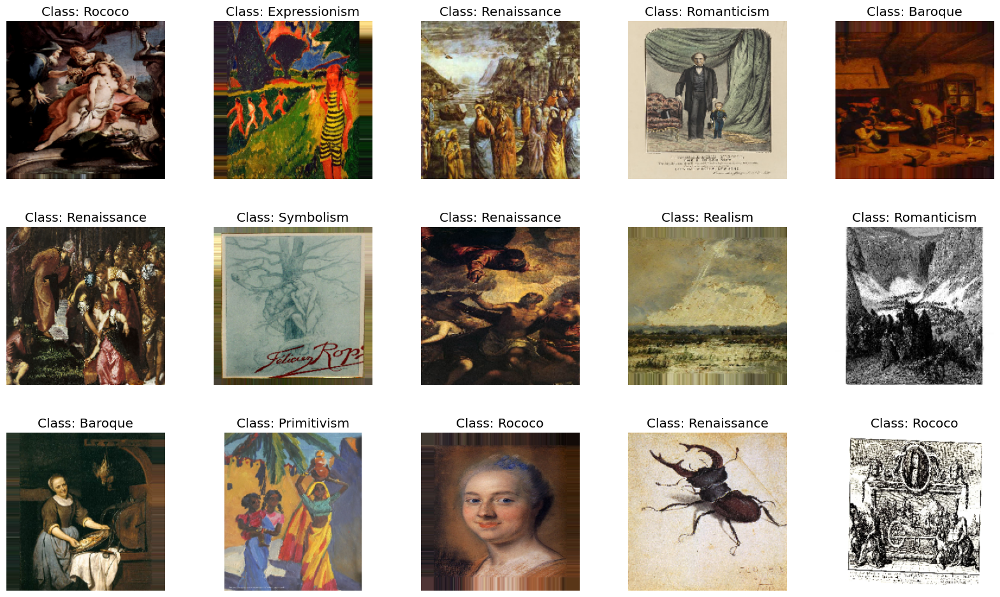

In [8]:
labels = [k for k,v in train_generator.class_indices.items()]
sample_generate = train_generator.__next__()
images = sample_generate[0]
titles = sample_generate[1]
plt.figure(figsize = (20 , 20))

for i in range(15):
    plt.subplot(5 , 5, i+1)
    plt.subplots_adjust(hspace = 0.3 , wspace = 0.3)
    plt.imshow(images[i])
    plt.title(f'Class: {labels[np.argmax(titles[i],axis=0)]}')
    plt.axis("off")

In [9]:
from tensorflow.keras.applications import ResNet50

base_model = ResNet50(include_top=False,
                      weights='imagenet',
                      input_shape=(img_size, img_size, 3))


In [10]:
base_model.summary()

Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃ Param # ┃ Connected to         ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │       0 │ -                    │
│ (InputLayer)        │ 3)                │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv1_pad           │ (None, 230, 230,  │       0 │ input_layer[0][0]    │
│ (ZeroPadding2D)     │ 3)                │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │   9,472 │ conv1_pad[0][0]      │
│                     │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv1_bn            │ (None, 112, 112,  │     256 │ conv1_conv[0][0]     │
│ (BatchNormalizatio… │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv1_relu          │ (None, 112, 112,  │       0 │ conv1_bn[0][0]       │
│ (Activation)        │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ pool1_pad           │ (None, 114, 114,  │       0 │ conv1_relu[0][0]     │
│ (ZeroPadding2D)     │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ pool1_pool          │ (None, 56, 56,    │       0 │ pool1_pad[0][0]      │
│ (MaxPooling2D)      │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │   4,160 │ pool1_pool[0][0]     │
│ (Conv2D)            │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │     256 │ conv2_block1_1_conv… │
│ (BatchNormalizatio… │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │       0 │ conv2_block1_1_bn[0… │
│ (Activation)        │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │  36,928 │ conv2_block1_1_relu… │
│ (Conv2D)            │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │     256 │ conv2_block1_2_conv… │
│ (BatchNormalizatio… │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │       0 │ conv2_block1_2_bn[0… │
│ (Activation)        │ 64)               │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │  16,640 │ pool1_pool[0][0]     │
│ (Conv2D)            │ 256)              │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │  16,640 │ conv2_block1_2_relu… │
│ (Conv2D)            │ 256)              │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │   1,024 │ conv2_block1_0_conv… │
│ (BatchNormalizatio… │ 256)              │         │                      │
├─────────────────────┼───────────────────┼─────────┼──────────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │   1,024 │ conv2_block1_3_conv

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 23,534,592 (89.78 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [11]:
freeze_index = None
for i, layer in enumerate(base_model.layers):
    layer_config = layer.get_config()
    if 'conv4' in layer_config['name']:
        freeze_index = i
        break


In [12]:
last_output = base_model.output
x = GlobalAveragePooling2D()(last_output)
x = Dense(512, activation='relu')(x)
outputs = Dense(13, activation='softmax')(x)
model = Model(inputs=base_model.inputs, outputs=outputs)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
             loss='categorical_crossentropy',
             metrics=['accuracy'])

In [13]:
modelname =  "model.keras"
checkpoint = ModelCheckpoint(modelname,
                              monitor="val_loss",
                              mode="min",
                              save_best_only=True,
                              verbose=1)

earlystopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=1, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss', 
                                            patience=3, 
                                            verbose=1, 
                                            factor=0.3, 
                                            min_lr=0.00000001)

In [14]:
history = model.fit(train_generator,
                    epochs=15,
                    validation_data=validation_generator,
                    callbacks=[checkpoint,earlystopping,learning_rate_reduction])

Epoch 1/15


d:\Сириус\.venv\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:122: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.



AbortedError: Graph execution error:

Detected at node StatefulPartitionedCall/gradient_tape/functional_1_1/conv5_block3_3_conv_1/convolution/Conv2DBackpropInput defined at (most recent call last):
<stack traces unavailable>
Operation received an exception:Status: 1, message: could not create a memory object, in file tensorflow/core/kernels/mkl/mkl_conv_grad_input_ops.cc:545
	 [[{{node StatefulPartitionedCall/gradient_tape/functional_1_1/conv5_block3_3_conv_1/convolution/Conv2DBackpropInput}}]] [Op:__inference_one_step_on_iterator_43340]

In [5]:
# Define input directory
path = "/загрузки/archive"

# Class names
class_names = sorted(os.listdir(path))

#specify our selected classes
class_names_bin =  ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
n_classes = len(class_names_bin)

In [ ]:
import os
import shutil

# Путь к исходному датасету
dataset_path = "/загрузки/archive_art"

# Получить список всех классов (папок) в датасете
classes = os.listdir(dataset_path)

# Словарь для хранения количества изображений в каждом классе
class_image_counts = {}

# Подсчитать количество изображений в каждом классе
for class_name in classes:
    class_path = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_path):
        class_images = os.listdir(class_path)
        class_image_counts[class_name] = len(class_images)

# Отсортировать классы по количеству изображений и выбрать топ-10
top_classes = sorted(class_image_counts, key=class_image_counts.get, reverse=True)[:10]

# Создать новый каталог для нового датасета
new_dataset_path = "/загрузки/archive_art_top_10"
os.makedirs(new_dataset_path, exist_ok=True)

# Скопировать изображения из выбранных классов в новый датасет
for class_name in top_classes:
    class_source_path = os.path.join(dataset_path, class_name)
    class_dest_path = os.path.join(new_dataset_path, class_name)
    shutil.copytree(class_source_path, class_dest_path)

print("Новый датасет создан успешно.")


In [4]:

from keras.preprocessing.image import ImageDataGenerator as IDG

# Data Visualization
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import plotly.express as px

# Visualization of Paintings
from IPython.display import Image
from IPython.display import clear_output as cls

# Model
from keras.applications import ResNet50
from keras.models import Sequential, load_model, save_model
from keras.layers import Dense

# Callbacks 
from keras.callbacks import EarlyStopping, ModelCheckpoint

# Post-hoc explainability
import visualkeras
import ImageDataGenerator as IDG


ImportError: cannot import name 'ImageDataGenerator' from 'keras.preprocessing.image' (d:\Сириус\.venv\lib\site-packages\keras\preprocessing\image\__init__.py)

In [7]:
import shutil
import random

newpath = "/загрузки"
#shutil.rmtree(newpath)
#shutil.rmtree("/kaggle/working/_models")
#shutil.rmtree("/kaggle/working/img")

# Create folders for saving the models and images later
for folder in ["models", "img"]:
    os.makedirs(folder)

# Set splitting rates
validation_split = 0.2
test_split = 0.1
train_split = 1-(validation_split + test_split)

for class_path in class_names_bin:
    # copy folder structure + paintings to "train"
    shutil.copytree(src = os.path.join(path, class_path, class_path),
                    dst = os.path.join(newpath, "train", class_path))
    
    # create folder structure for validation and test folders
    for subset, split in [["validation", validation_split], ["test", test_split]]:
        os.makedirs(os.path.join(newpath, subset, class_path))

        # move part of the data to test
        source = os.path.join(newpath, "train", class_path)
        dest = os.path.join(newpath, subset, class_path)
        files = os.listdir(source)
        no_of_files = int(len(files)//(1/split))

        random.seed(123)
        for file_name in random.sample(files, no_of_files):
            shutil.move(os.path.join(source, file_name), dest)
    
# Print data distribution
for subset in os.listdir(newpath):
    for class_path in class_names_bin:
        lst = os.listdir(os.path.join(newpath, subset, class_path))
        no_files = len(lst)
        txt = "The {subset} set contains {no_files} paintings in {class_path}."
        print(txt.format(subset=subset, no_files=no_files, class_path=class_path))

FileExistsError: [WinError 183] Невозможно создать файл, так как он уже существует: 'models'

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
#for dirname, _, filenames in os.walk('/kaggle/input'):
    #for filename in filenames:
        #print(os.path.join(dirname, filename))
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
from keras.preprocessing import image
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Flatten,Dense,Dropout,BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from tensorflow.keras.applications import VGG16, InceptionResNetV2
from keras import regularizers
from tensorflow.keras.optimizers import Adam,RMSprop,SGD,Adamax

In [2]:
train_dir = "/загрузки/train"
test_dir = "/загрузки/test"

In [23]:
img_size = 48 #original size of the image

In [24]:
train_datagen = ImageDataGenerator(#rotation_range = 180,
                                         width_shift_range = 0.1,
                                         height_shift_range = 0.1,
                                         horizontal_flip = True,
                                         rescale = 1./255,
                                         #zoom_range = 0.2,
                                         validation_split = 0.2
                                        )
validation_datagen = ImageDataGenerator(rescale = 1./255,
                                         validation_split = 0.2)

In [25]:
train_generator = train_datagen.flow_from_directory(directory = train_dir,
                                                    target_size = (img_size,img_size),
                                                    batch_size = 64,
                                                    color_mode = "grayscale",
                                                    class_mode = "categorical",
                                                    subset = "training"
                                                   )
validation_generator = validation_datagen.flow_from_directory( directory = test_dir,
                                                              target_size = (img_size,img_size),
                                                              batch_size = 64,
                                                              color_mode = "grayscale",
                                                              class_mode = "categorical",
                                                              subset = "validation"
                                                             )

Found 27206 images belonging to 13 classes.
Found 1695 images belonging to 13 classes.


In [26]:
model= tf.keras.models.Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), padding='same', activation='relu', input_shape=(48, 48,1)))
model.add(Conv2D(64,(3,3), padding='same', activation='relu' ))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(128,(5,5), padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
    
model.add(Conv2D(512,(3,3), padding='same', activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(512,(3,3), padding='same', activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten()) 
model.add(Dense(256,activation = 'relu'))
model.add(BatchNormalization())
model.add(Dropout(0.25))
    
model.add(Dense(512,activation = 'relu'))
model.add(BatchNormalization())
model.add(Dropout(0.25))

model.add(Dense(7, activation='softmax'))

model.compile(
    optimizer=Adam(learning_rate=0.0001), 
    loss='categorical_crossentropy', 
    metrics=['accuracy']
)


In [18]:
model = tf.keras.models.Sequential()

model.add(Layers.Conv2D(200,kernel_size=(3,3),activation='relu',input_shape=(150,150,3)))
model.add(Layers.Conv2D(180,kernel_size=(3,3),activation='relu'))
model.add(Layers.MaxPool2D(5,5))
model.add(Layers.Conv2D(180,kernel_size=(3,3),activation='relu'))
model.add(Layers.Conv2D(140,kernel_size=(3,3),activation='relu'))
model.add(Layers.Conv2D(100,kernel_size=(3,3),activation='relu'))
model.add(Layers.Conv2D(50,kernel_size=(3,3),activation='relu'))
model.add(Layers.MaxPool2D(5,5))
model.add(Layers.Flatten())
model.add(Layers.Dense(180,activation='relu'))
model.add(Layers.Dense(100,activation='relu'))
model.add(Layers.Dense(50,activation='relu'))
model.add(Layers.Dropout(rate=0.5))
model.add(Layers.Dense(6,activation='softmax'))

model.compile(optimizer=Optimizer.Adam(lr=0.0001),loss='sparse_categorical_crossentropy',metrics=['accuracy'])

model.summary()
SVG(model_to_dot(model).create(prog='dot', format='svg'))
Utils.plot_model(model,to_file='model.png',show_shapes=True)

NameError: name 'Models' is not defined

In [20]:
epochs = 60
batch_size = 64

In [27]:
model.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ conv2d_30 (Conv2D)              │ (None, 48, 48, 32)        │        320 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_31 (Conv2D)              │ (None, 48, 48, 64)        │     18,496 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_36          │ (None, 48, 48, 64)        │        256 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 24, 24, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_36 (Dropout)            │ (None, 24, 24, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_32 (Conv2D)              │ (None, 24, 24, 128)       │    204,928 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_37          │ (None, 24, 24, 128)       │        512 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 12, 12, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_37 (Dropout)            │ (None, 12, 12, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_33 (Conv2D)              │ (None, 12, 12, 512)       │    590,336 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_38          │ (None, 12, 12, 512)       │      2,048 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 6, 6, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_38 (Dropout)            │ (None, 6, 6, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_34 (Conv2D)              │ (None, 6, 6, 512)         │  2,359,808 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_39          │ (None, 6, 6, 512)         │      2,048 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 3, 3, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_39 (Dropout)            │ (None, 3, 3, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ flatten_6 (Flatten)             │ (None, 4608)              │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_18 (Dense)                │ (None, 256)               │  1,179,904 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_40          │ (None, 256)               │      1,024 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_40 (Dropout)            │ (None, 256)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_19 (Dense)                │ (None, 512)               │    131,584 │
├─────────────────────────────────┼───────────────────────────┼──────────

 Total params: 4,496,903 (17.15 MB)

 Trainable params: 4,492,935 (17.14 MB)

 Non-trainable params: 3,968 (15.50 KB)

In [28]:
history = model.fit(x = train_generator,epochs = epochs,validation_data = validation_generator)

Epoch 1/60


ValueError: Arguments `target` and `output` must have the same shape. Received: target.shape=(None, 13), output.shape=(None, 7)

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

from sklearn.metrics import confusion_matrix , classification_report 
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score

from IPython.display import clear_output
import warnings
warnings.filterwarnings('ignore')

In [ ]:
class_names =  ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}

nb_classes = len(class_names)

IMAGE_SIZE = (150, 150)

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm
from sklearn.utils import shuffle  # Import shuffle from scikit-learn if not already imported

def load_data():
    datasets = ["/загрузки/train", "/загрузки/test"]
    output = []

    for dataset in datasets:
        images = []
        labels = []

        print("Loading {}".format(dataset))

        for folder in os.listdir(dataset):
            label = class_names_label.get(folder, -1)  # Use get() to avoid potential KeyError

            if label != -1:  # Check if a valid label is assigned
                for file in tqdm(os.listdir(os.path.join(dataset, folder))):
                    img_path = os.path.join(os.path.join(dataset, folder), file)

                    # Open and resize the img
                    image = cv2.imread(img_path)

                    if image is not None:
                        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                        image = cv2.resize(image, IMAGE_SIZE)

                        # Append the image and its corresponding label to the output
                        images.append(image)
                        labels.append(label)
                    else:
                        print(f"Warning: Unable to load image from {img_path}")

        images = np.array(images, dtype='float32')
        labels = np.array(labels, dtype='int32')

        output.append((images, labels))

    return output

(train_images, train_labels), (test_images, test_labels) = load_data()

# Shuffle the training data
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

n_train = train_labels.shape[0]  # Use the first element of the tuple
n_test = test_labels.shape[0]    # Use the first element of the tuple

print("Number of training examples: {}".format(n_train))
print("Number of testing examples: {}".format(n_test))
print("Each image is of size: {}".format(IMAGE_SIZE))


In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data()

In [ ]:
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

In [ ]:
n_train = train_labels.shape[0]  # Use the first element of the tuple
n_test = test_labels.shape[0]    # Use the first element of the tuple

print("Number of training examples: {}".format(n_train))
print("Number of testing examples: {}".format(n_test))
print("Each image is of size: {}".format(IMAGE_SIZE))


In [ ]:
import pandas as pd

_, train_counts = np.unique(train_labels, return_counts=True)
_, test_counts = np.unique(test_labels, return_counts=True)
pd.DataFrame({'train': train_counts,
                    'test': test_counts}, 
             index=class_names
            ).plot.bar()
plt.show()

In [ ]:
def display_random_image(class_names, images, labels):
    """
        Display a random image from the images array and its correspond label from the labels array.
    """
    
    index = np.random.randint(images.shape[0])
    plt.figure()
    plt.imshow(images[index])
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.title('Image #{} : '.format(index) + class_names[labels[index]])
    plt.show()

In [ ]:
def display_examples(class_names, images, labels):
    """
        Display 25 images from the images array with its corresponding labels
    """
    
    fig = plt.figure(figsize=(10,10))
    fig.suptitle("Some examples of images of the dataset", fontsize=16)
    for i in range(25):
        plt.subplot(5,5,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(images[i], cmap=plt.cm.binary)
        plt.xlabel(class_names[labels[i]])
    plt.show()

In [ ]:
display_examples(class_names, train_images, train_labels)

In [ ]:
# import os
# from sklearn.model_selection import train_test_split
# from sklearn.utils import shuffle

# # Путь к корневой папке с изображениями
# dataset_path = "/загрузки/archive"

# # Список стилей
# styles = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque',
#           'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism',
#           'Rococo', 'Symbolism', 'Western_Medieval']

# # Создание списка для хранения путей к изображениям и их стилей
# image_paths = []
# labels = []

# # Заполнение списка путей и меток
# for style in styles:
#     style_path = os.path.join(dataset_path, style, style)
#     images = os.listdir(style_path)
#     images = [os.path.join(style_path, img) for img in images if img.endswith(".jpg")]
#     image_paths.extend(images)
#     labels.extend([style] * len(images))

# # Перемешивание данных
# image_paths, labels = shuffle(image_paths, labels, random_state=42)

# # Разделение на обучающую и тестовую выборки (80% train, 20% test)
# train_paths, test_paths, train_labels, test_labels = train_test_split(
#     image_paths, labels, test_size=0.2, random_state=42, stratify=labels
# )

# # Создание папок для train и test, если они не существуют
# train_folder = "/загрузки/train"
# test_folder = "/загрузки/test"
# os.makedirs(train_folder, exist_ok=True)
# os.makedirs(test_folder, exist_ok=True)

# # Копирование файлов в соответствующие папки
# for path, label in zip(train_paths, train_labels):
#     destination_folder = os.path.join(train_folder, label)
#     os.makedirs(destination_folder, exist_ok=True)
#     os.rename(path, os.path.join(destination_folder, os.path.basename(path)))

# for path, label in zip(test_paths, test_labels):
#     destination_folder = os.path.join(test_folder, label)
#     os.makedirs(destination_folder, exist_ok=True)
#     os.rename(path, os.path.join(destination_folder, os.path.basename(path)))


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

from sklearn.metrics import confusion_matrix , classification_report 
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score

from IPython.display import clear_output
import warnings
warnings.filterwarnings('ignore')

In [2]:
#Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
import os
from tqdm import tqdm, tqdm_notebook
import random
import imageio
import shutil
import cv2
from PIL import Image


import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.applications import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.initializers import *
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from numpy.random import seed
seed(1)

In [3]:
train_dir = "/загрузки/train"
test_dir = "/загрузки/test"

In [14]:
train_dir = "/загрузки/train"
test_dir = "/загрузки/test"
SEED = 12
IMG_HEIGHT = 200
IMG_WIDTH = 200
BATCH_SIZE = 64
EPOCHS = 30
FINE_TUNING_EPOCHS = 20
LR = 0.0001
NUM_CLASSES = 13
EARLY_STOPPING_CRITERIA=3

lr_schedule = tf.keras.callbacks.LearningRateScheduler(lambda epoch: 1e-4 * 10**(epoch / 10))
CLASS_LABELS   = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
# CLASS_LABELS = {class_name:i for i, class_name in enumerate(class_names)}

In [15]:
preprocess_fun = tf.keras.applications.densenet.preprocess_input

train_datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1,
    brightness_range=[0.8, 1.2],
    rescale=1./255,
    validation_split=0.2,
    preprocessing_function=preprocess_fun
)

test_datagen = ImageDataGenerator(rescale = 1./255,
                                  validation_split = 0.2,
                                  preprocessing_function=preprocess_fun)

train_generator = train_datagen.flow_from_directory(directory = train_dir,
                                                    target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                    batch_size = BATCH_SIZE,
                                                    shuffle  = True , 
                                                    color_mode = "rgb",
                                                    class_mode = "categorical",
                                                    subset = "training",
                                                    seed = 12
                                                   )

validation_generator = test_datagen.flow_from_directory(directory = train_dir,
                                                         target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                         batch_size = BATCH_SIZE,
                                                         shuffle  = True , 
                                                         color_mode = "rgb",
                                                         class_mode = "categorical",
                                                         subset = "validation",
                                                         seed = 12
                                                        )

test_generator = test_datagen.flow_from_directory(directory = test_dir,
                                                   target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                    batch_size = BATCH_SIZE,
                                                    shuffle  = False , 
                                                    color_mode = "rgb",
                                                    class_mode = "categorical",
                                                    seed = 12
                                                  )

Found 27206 images belonging to 13 classes.
Found 6794 images belonging to 13 classes.
Found 8500 images belonging to 13 classes.


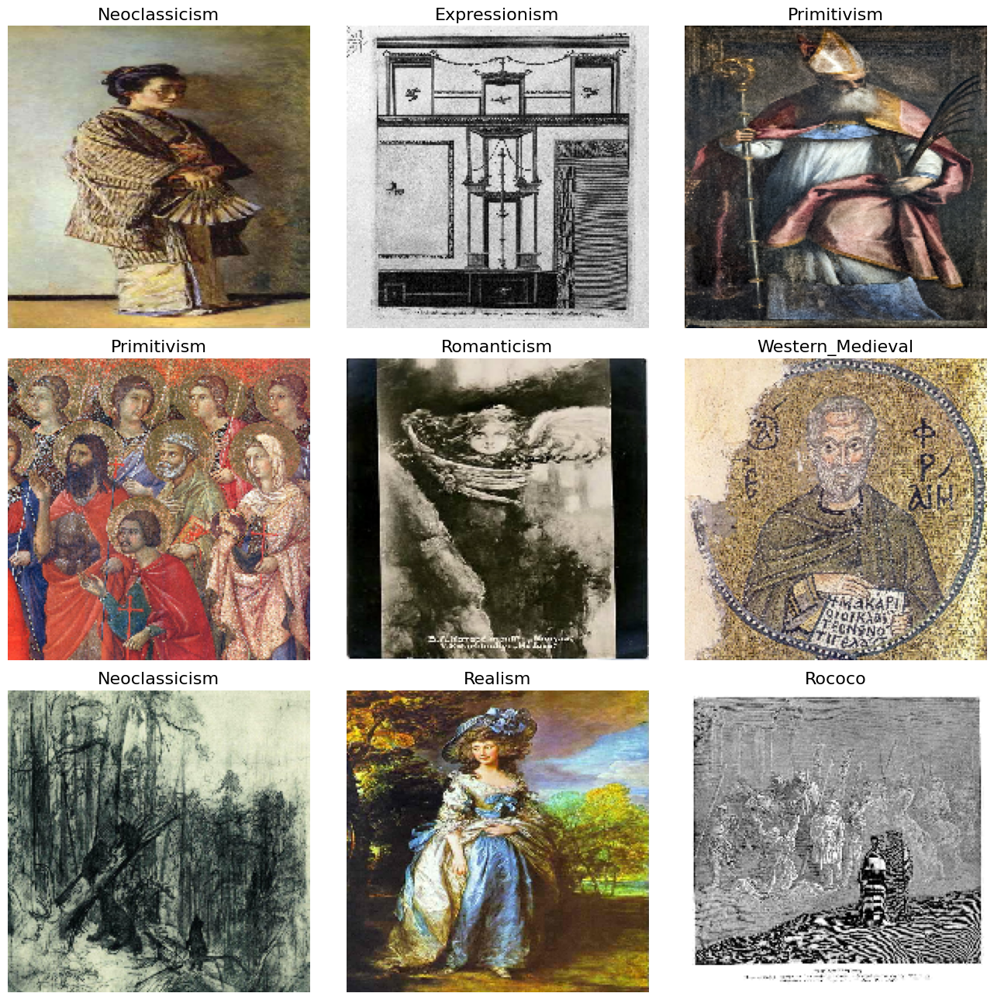

In [7]:
# Helper Functions
def display_one_image(image, title, subplot, color):
    plt.subplot(subplot)
    plt.axis('off')
    plt.imshow(image)
    plt.title(title, fontsize=16)
    
def display_nine_images(images, titles, title_colors=None):
    subplot = 331
    plt.figure(figsize=(13,13))
    for i in range(9):
        color = 'black' if title_colors is None else title_colors[i]
        display_one_image(images[i], titles[i], 331+i, color)
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()

def image_title(label, prediction):
  # Both prediction (probabilities) and label (one-hot) are arrays with one item per class.
    class_idx = np.argmax(label, axis=-1)
    prediction_idx = np.argmax(prediction, axis=-1)
    if class_idx == prediction_idx:
        return f'{CLASS_LABELS[prediction_idx]} [correct]', 'black'
    else:
        return f'{CLASS_LABELS[prediction_idx]} [incorrect, should be {CLASS_LABELS[class_idx]}]', 'red'

def get_titles(images, labels, model):
    predictions = model.predict(images)
    titles, colors = [], []
    for label, prediction in zip(classes, predictions):
        title, color = image_title(label, prediction)
        titles.append(title)
        colors.append(color)
    return titles, colors

img_datagen = ImageDataGenerator(rescale = 1./255)
img_generator = img_datagen.flow_from_directory(directory = train_dir,
                                                   target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                    batch_size = BATCH_SIZE,
                                                    shuffle  = True , 
                                                    color_mode = "rgb",
                                                    class_mode = "categorical",
                                                    seed = 12
                                                  )
clear_output()

images, classes = next(img_generator)
class_idxs = np.argmax(classes, axis=-1) 
labels = [CLASS_LABELS[idx] for idx in class_idxs]
display_nine_images(images, labels)

In [8]:
fig = px.bar(x = CLASS_LABELS,
             y = [list(train_generator.classes).count(i) for i in np.unique(train_generator.classes)] , 
             color = np.unique(train_generator.classes) ,
             color_continuous_scale="Emrld") 
fig.update_xaxes(title="class")
fig.update_yaxes(title = "Number of Images")
fig.update_layout(showlegend = True,
    title = {
        'text': 'Train Data Distribution ',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [13]:
def feature_extractor(inputs):
    feature_extractor = tf.keras.applications.ResNet50(input_shape=(IMG_HEIGHT, IMG_WIDTH, 3),
                                                      include_top=False,
                                                      weights="imagenet")(inputs)
    
    return feature_extractor

def classifier(inputs):
    x = tf.keras.layers.GlobalAveragePooling2D()(inputs)
    x = tf.keras.layers.Dense(256, activation="relu", kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
    x = tf.keras.layers.Dropout(0.3)(x)
    x = tf.keras.layers.Dense(1024, activation="relu", kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    x = tf.keras.layers.Dense(512, activation="relu", kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    x = tf.keras.layers.Dense(NUM_CLASSES, activation="softmax", name="classification")(x)
    
    return x

def final_model(inputs):
    resnet_feature_extractor = feature_extractor(inputs)
    classification_output = classifier(resnet_feature_extractor)
    
    return classification_output

def define_compile_model():
    inputs = tf.keras.layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3))
    classification_output = final_model(inputs)
    model = tf.keras.Model(inputs=inputs, outputs=classification_output)
     
    model.compile(optimizer=tf.keras.optimizers.SGD(0.0001), 
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
  
    return model

In [11]:
model = define_compile_model()
clear_output()

# Feezing the feature extraction layers
model.layers[1].trainable = False

model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 200, 200, 3)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ resnet50 (Functional)           │ (None, 7, 7, 2048)        │ 23,587,712 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ global_average_pooling2d        │ (None, 2048)              │          0 │
│ (GlobalAveragePooling2D)        │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense (Dense)                   │ (None, 256)               │    524,544 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout (Dropout)               │ (None, 256)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_1 (Dense)                 │ (None, 1024)              │    263,168 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_1 (Dropout)             │ (None, 1024)              │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_2 (Dense)                 │ (None, 512)               │    524,800 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_2 (Dropout)             │ (None, 512)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ classification (Dense)          │ (None, 13)                │      6,669 │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 24,906,893 (95.01 MB)

 Trainable params: 1,319,181 (5.03 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [19]:
earlyStoppingCallback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                         patience=EARLY_STOPPING_CRITERIA,
                                                         verbose= 1 ,
                                                         restore_best_weights=True
                                                        )

history = model.fit(x = train_generator,
                    epochs = EPOCHS ,
                    validation_data = validation_generator , 
                    callbacks= [earlyStoppingCallback])

history = pd.DataFrame(history.history)

Epoch 1/30
426/426 ━━━━━━━━━━━━━━━━━━━━ 1393s 3s/step - accuracy: 0.1547 - loss: 2.7553 - val_accuracy: 0.1604 - val_loss: 2.4898
Epoch 2/30
344/426 ━━━━━━━━━━━━━━━━━━━━ 7:16 5s/step - accuracy: 0.1595 - loss: 2.4739

KeyboardInterrupt: 

In [20]:
# Augment data
batch_size = 32
train_input_shape = (224, 224, 3)
n_classes = 13

train_datagen = ImageDataGenerator(validation_split=0.2,
                                   rescale=1./255.,
                                   rotation_range=10,
                                   #width_shift_range=0.5,
                                   #height_shift_range=0.5,
                                   shear_range=5,
                                   #zoom_range=0.4,
                                   horizontal_flip=True,
                                   vertical_flip=True
                                   
                                  )

train_generator = train_datagen.flow_from_directory(directory=filtered_imgdir,
                                                    class_mode='categorical',
                                                    target_size=train_input_shape[0:2],
                                                    batch_size=batch_size,
                                                    subset="training",
                                                    shuffle=True,
                                                    classes=artstyles.tolist()
                                                   )

valid_generator = train_datagen.flow_from_directory(directory=filtered_imgdir,
                                                    class_mode='categorical',
                                                    target_size=train_input_shape[0:2],
                                                    batch_size=batch_size,
                                                    subset="validation",
                                                    shuffle=True,
                                                    classes=artstyles.tolist()
                                                   )

STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size
print("Total number of batches =", STEP_SIZE_TRAIN, "and", STEP_SIZE_VALID)

AttributeError: 'list' object has no attribute 'shape'

In [ ]:
print(base_model.output)
print(Flatten()(base_model.output))

In [13]:
def feature_extractor(inputs):
    feature_extractor = tf.keras.applications.DenseNet169(input_shape=(IMG_HEIGHT,IMG_WIDTH, 3),
                                               include_top=False,
                                               weights="imagenet")(inputs)
    
    return feature_extractor

def classifier(inputs):
    x = tf.keras.layers.GlobalAveragePooling2D()(inputs)
    x = tf.keras.layers.Dense(256, activation="relu", kernel_regularizer = tf.keras.regularizers.l2(0.01))(x)
    x = tf.keras.layers.Dropout(0.3)(x)
    x = tf.keras.layers.Dense(1024, activation="relu", kernel_regularizer = tf.keras.regularizers.l2(0.01))(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    x = tf.keras.layers.Dense(512, activation="relu", kernel_regularizer = tf.keras.regularizers.l2(0.01))(x)
    x = tf.keras.layers.Dropout(0.5) (x)
    x = tf.keras.layers.Dense(NUM_CLASSES, activation="softmax", name="classification")(x)
    
    return x

def final_model(inputs):
    densenet_feature_extractor = feature_extractor(inputs)
    classification_output = classifier(densenet_feature_extractor)
    
    return classification_output

def define_compile_model():
    
    inputs = tf.keras.layers.Input(shape=(IMG_HEIGHT ,IMG_WIDTH,3))
    classification_output = final_model(inputs) 
    model = tf.keras.Model(inputs=inputs, outputs = classification_output)
     
    model.compile(optimizer=tf.keras.optimizers.SGD(0.1), 
                loss='categorical_crossentropy',
                metrics = ['accuracy'])
  
    return model

In [14]:
model = define_compile_model()
clear_output()

# Feezing the feature extraction layers
model.layers[1].trainable = False

model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 200, 200, 3)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ densenet169 (Functional)        │ (None, 6, 6, 1664)        │ 12,642,880 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ global_average_pooling2d        │ (None, 1664)              │          0 │
│ (GlobalAveragePooling2D)        │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense (Dense)                   │ (None, 256)               │    426,240 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout (Dropout)               │ (None, 256)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_1 (Dense)                 │ (None, 1024)              │    263,168 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_1 (Dropout)             │ (None, 1024)              │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_2 (Dense)                 │ (None, 512)               │    524,800 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_2 (Dropout)             │ (None, 512)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ classification (Dense)          │ (None, 13)                │      6,669 │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 13,863,757 (52.89 MB)

 Trainable params: 1,220,877 (4.66 MB)

 Non-trainable params: 12,642,880 (48.23 MB)

In [15]:
import tensorflow as tf
import pandas as pd
from tqdm import tqdm 

In [16]:
earlyStoppingCallback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                         patience=EARLY_STOPPING_CRITERIA,
                                                         verbose= 1 ,
                                                         restore_best_weights=True
                                                        )

history = model.fit(x = train_generator,
                    epochs = EPOCHS ,
                    validation_data = validation_generator , 
                    callbacks= [earlyStoppingCallback])

history = pd.DataFrame(history.history)

Epoch 1/30
 84/426 ━━━━━━━━━━━━━━━━━━━━ 25:31 4s/step - accuracy: 0.1441 - loss: 16.6279

KeyboardInterrupt: 

In [ ]:
# Un-Freezing the feature extraction layers for fine tuning 
model.layers[1].trainable = True

model.compile(optimizer=tf.keras.optimizers.SGD(0.001), #lower learning rate
                loss='categorical_crossentropy',
                metrics = ['accuracy'])

history_ = model.fit(x = train_generator,epochs = FINE_TUNING_EPOCHS ,validation_data = validation_generator)
history = history.append(pd.DataFrame(history_.history) , ignore_index=True)

In [ ]:

x = px.line(data_frame= history , y= ["accuracy" , "val_accuracy"] ,markers = True )
x.update_xaxes(title="Number of Epochs")
x.update_yaxes(title = "Accuracy")
x.update_layout(showlegend = True,
    title = {
        'text': 'Accuracy vs Number of Epochs',
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
x.show()

In [ ]:
x = px.line(data_frame= history , 
            y= ["loss" , "val_loss"] , markers = True )
x.update_xaxes(title="Number of Epochs")
x.update_yaxes(title = "Loss")
x.update_layout(showlegend = True,
    title = {
        'text': 'Loss vs Number of Epochs',
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
x.show()



In [ ]:
earlyStoppingCallback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                         patience=EARLY_STOPPING_CRITERIA,
                                                         verbose= 1 ,
                                                         restore_best_weights=True
                                                        )

history = model.fit(x = train_generator,
                    epochs = EPOCHS ,
                    validation_data = validation_generator , 
                    callbacks= [earlyStoppingCallback])

history = pd.DataFrame(history.history)

In [ ]:
import sys
sys.version


In [ ]:
preprocess_fun = tf.keras.applications.densenet.preprocess_input

train_datagen = ImageDataGenerator(horizontal_flip=True,
                                   width_shift_range=0.1,
                                   height_shift_range=0.05,
                                   rescale = 1./255,
                                   validation_split = 0.2,
                                   preprocessing_function=preprocess_fun
                                  )
test_datagen = ImageDataGenerator(rescale = 1./255,
                                  validation_split = 0.2,
                                  preprocessing_function=preprocess_fun)

train_generator = train_datagen.flow_from_directory(directory = train_dir,
                                                    target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                    batch_size = BATCH_SIZE,
                                                    shuffle  = True , 
                                                    color_mode = "rgb",
                                                    class_mode = "categorical",
                                                    subset = "training",
                                                    seed = 12
                                                   )

validation_generator = test_datagen.flow_from_directory(directory = train_dir,
                                                         target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                         batch_size = BATCH_SIZE,
                                                         shuffle  = True , 
                                                         color_mode = "rgb",
                                                         class_mode = "categorical",
                                                         subset = "validation",
                                                         seed = 12
                                                        )

test_generator = test_datagen.flow_from_directory(directory = test_dir,
                                                   target_size = (IMG_HEIGHT ,IMG_WIDTH),
                                                    batch_size = BATCH_SIZE,
                                                    shuffle  = False , 
                                                    color_mode = "rgb",
                                                    class_mode = "categorical",
                                                    seed = 12
                                                  )

In [ ]:
class_names =  ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}

nb_classes = len(class_names)

IMAGE_SIZE = (250, 250)

In [ ]:
nb_classes

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm
from sklearn.utils import shuffle



def load_data(data_path):
    """
    Load the data:
        - 14,034 images to train the network.
        - 3,000 images to evaluate how accurately the network learned to classify images.
    """
    
    datasets = [os.path.join(data_path, genre).replace('\\', '/') + '/' for genre in class_names_label.keys()]
    output = []
    
    # Iterate through training and test sets
    for dataset in datasets:
        
        images = []
        labels = []
        
        print("Loading {}".format(dataset))
        
        # Iterate through each folder corresponding to a category
        for folder in os.listdir(dataset):
            label = class_names_label[folder]
            
            # Iterate through each image in our folder
            for file in tqdm(os.listdir(os.path.join(dataset, folder))):
                
                # Get the path name of the image
                img_path = os.path.join(os.path.join(dataset, folder), file)
                
                # Open and resize the img
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, IMAGE_SIZE) 
                
                # Append the image and its corresponding label to the output
                images.append(image)
                labels.append(label)
                
        images = np.array(images, dtype='float32')
        labels = np.array(labels, dtype='int32')   
        
        output.append((images, labels))

    return output

# Replace '/загрузки/archive' with the actual path to your data
data_path = '/загрузки/archive'
(train_images, train_labels), (test_images, test_labels) = load_data(data_path)
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

In [ ]:
from sklearn.model_selection import train_test_split

def load_data():
    data_path = '/загрузки/archive'
    datasets = [os.path.join(data_path, genre, genre).replace('\\', '/') + '/' for genre in class_names_label.keys()]
    all_data = []
    
    for dataset in datasets:
        images = []
        labels = []
        print("Loading {}".format(dataset))
        
        for folder in os.listdir(dataset):
            label = class_names_label.get(folder)
            folder_path = os.path.join(dataset, folder)
            
            if os.path.isdir(folder_path):
                for file in tqdm(os.listdir(folder_path)):
                    img_path = os.path.join(folder_path, file)
                    
                    if os.path.isfile(img_path):
                        image = cv2.imread(img_path)
                        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                        image = cv2.resize(image, IMAGE_SIZE)
                        images.append(image)
                        labels.append(label)
        
        images = np.array(images, dtype='float32')
        labels = np.array(labels, dtype='int32')   
        
        if len(images) > 0:
            # Check if there is enough data for splitting
            if len(set(labels)) > 1:
                # Split data into training and testing sets
                train_images, test_images, train_labels, test_labels = train_test_split(images, labels, test_size=0.2, random_state=42)
                all_data.append(((train_images, train_labels), (test_images, test_labels)))
    
    return all_data if all_data else [((np.array([]), np.array([])), (np.array([]), np.array([])))]

# Load data
(train_images, train_labels), (test_images, test_labels) = load_data()[0]


In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data()

In [ ]:
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

In [ ]:
def load_data():
    all_data = []

    # Iterate through datasets
    for dataset in datasets:
        images = []
        labels = []

        # ... (your existing code)

        images = np.array(images, dtype='float32')
        labels = np.array(labels, dtype='int32')

        print("Shapes - Images: {}, Labels: {}".format(images.shape, labels.shape))

        # Split the data into training and testing sets
        train_images, test_images, train_labels, test_labels = train_test_split(
            images, labels, test_size=0.2, random_state=42, stratify=labels
        )

        all_data.append((train_images, train_labels, test_images, test_labels))

    return all_data


In [ ]:
# Load data
loaded_data = load_data()

if loaded_data:
    (train_images, train_labels, test_images, test_labels) = loaded_data[0]

    # Check shapes
    print("Shape of train_images:", train_images.shape)
    print("Shape of train_labels:", train_labels.shape)
    print("Shape of test_images:", test_images.shape)
    print("Shape of test_labels:", test_labels.shape)

    # Other code for printing the number of examples and image size
    n_train = train_labels.shape[0]
    n_test = test_labels.shape[0]

    print("Number of training examples: {}".format(n_train))
    print("Number of testing examples: {}".format(n_test))
    print("Each image is of size: {}".format(IMAGE_SIZE))



In [ ]:
n_train = train_labels.shape[0]
n_test = test_labels.shape[0]

print ("Number of training examples: {}".format(n_train))
print ("Number of testing examples: {}".format(n_test))
print ("Each image is of size: {}".format(IMAGE_SIZE))

In [ ]:
output

In [ ]:
from sklearn.model_selection import train_test_split

# Ваш код, который создает список output

# Объединение данных из разных датасетов
all_images = np.concatenate([entry[0] for entry in output])
all_labels = np.concatenate([entry[1] for entry in output])

# Разделение на обучающую и тестовую выборки с учетом пропорций классов
train_images, test_images, train_labels, test_labels = train_test_split(
    all_images, all_labels, test_size=0.2, random_state=42, stratify=all_labels
)

# Вывод в формате (train_images, train_labels), (test_images, test_labels)
(train_images, train_labels), (test_images, test_labels) = (train_images, train_labels), (test_images, test_labels)


In [ ]:
output

In [ ]:
# Define default_label before the loop
default_label = "default_label_value"  # Replace this with the actual default label value

# Iterate through each folder corresponding to a category
for folder in os.listdir('/загрузки/archive'):
    label = class_names_label.get(folder, default_label)
    
    # Iterate through each image in our folder
    for file in tqdm(os.listdir(os.path.join('/загрузки/archive', folder))):
        # Get the path name of the image
        image_path = os.path.join('/загрузки/archive', folder, file)
        # Further processing of the image...

# Iterate through each folder corresponding to a category
for folder in os.listdir('/загрузки/archive'):
    label = class_names_label.get(folder, default_label)
    
    # Iterate through each image in our folder
    for file in tqdm(os.listdir(os.path.join('/загрузки/archive', folder))):
        # Get the path name of the image
        image_path = os.path.join('/загрузки/archive', folder, file)
        # Further processing of the image...


In [ ]:
print(class_names_label)
label = class_names_label.get(folder, default_label)


In [ ]:
custom_data_path = '/загрузки/archive'
IMAGE_SIZE = (224, 224)


In [ ]:
loaded_data = custom_data_path

    # Шаффлинг данных (если требуется)
    train_images, train_labels = shuffle(train_images, train_labels, random_state=25)
    test_images, test_labels = shuffle(test_images, test_labels, random_state=25)

    # Получение количества обучающих и тестовых примеров
    n_train = train_labels.shape[0]
    n_test = test_labels.shape[0]

    print("Number of training examples: {}".format(n_train))
    print("Number of testing examples: {}".format(n_test))
    print("Each image is of size: {}".format(IMAGE_SIZE))

In [ ]:
def load_data(data_path, image_size=(224, 224)):
    # ...

    datasets = [os.path.join(data_path, genre, genre) + '/' for genre in class_names_label.keys()]
    output = []

    for dataset in datasets:
        # ...

        print("Loading {}".format(dataset.replace('\\', '/')))

        # Check if the dataset folder exists
        if not os.path.exists(dataset):
            print(f"Dataset folder not found: {dataset}")
            continue

        # Iterate through each image in the folder
        for file in tqdm(os.listdir(dataset)):
            # Get the path name of the image
            img_path = os.path.join(dataset, file).replace('\\', '/')

In [ ]:
def load_data(data_path, image_size=(224, 224)):
    class_names_label = {
        'Renaissance': 0,
        'Romanticism': 1,
        'Academic_Art': 2,
        'Art_Nouveau': 3,
        'Baroque': 4,
        'Expressionism': 5,
        'Japanese_Art': 6,
        'Neoclassicism': 7,
        'Primitivism': 8,
        'Realism': 9,
        'Rococo': 10,
        'Symbolism': 11,
        'Western_Medieval': 12
    }

    datasets = [os.path.join(data_path, genre, genre) + '/' for genre in class_names_label.keys()]
    output = []

    for dataset in datasets:
        images = []
        labels = []

        print("Loading {}".format(dataset.replace('\\', '/')))

        # Check if the dataset folder exists
        if not os.path.exists(dataset):
            print(f"Dataset folder not found: {dataset}")
            continue

        # Print the number of files in the dataset
        num_files = len(os.listdir(dataset))
        print(f"Number of files in {dataset}: {num_files}")

        # Iterate through each image in the folder
        for file in tqdm(os.listdir(dataset)):
            # Get the path name of the image
            img_path = os.path.join(dataset, file).replace('\\', '/')

            # Try to open and read the image
            try:
                image = cv2.imread(img_path)

                # Check if the image is not None
                if image is not None:
                    # Open and resize the image
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                    image = cv2.resize(image, image_size)

                    # Get the label from the folder name
                    label = class_names_label[os.path.basename(dataset).replace('/', '_')]

                    # Append the image and its corresponding label to the output
                    images.append(image)
                    labels.append(label)
                else:
                    print(f"Failed to read image at {img_path}. Image is empty.")
            except Exception as e:
                print(f"Error reading image at {img_path}: {str(e)}")

        images = np.array(images, dtype='float32')
        labels = np.array(labels, dtype='int32')

        output.append((images, labels))

    return output


In [ ]:
custom_data_path = '/загрузки/archive'
IMAGE_SIZE = (224, 224)

# Загрузка данных с использованием кастомного пути
loaded_data = load_data(custom_data_path, image_size=IMAGE_SIZE)

# Проверка наличия данных
if not loaded_data:
    print("No data loaded. Please check your dataset path and structure.")
else:
    # Исходя из предположения, что load_data возвращает кортеж (train_data, test_data)
    (train_images, train_labels), (test_images, test_labels) = loaded_data

    # Шаффлинг данных (если требуется)
    train_images, train_labels = shuffle(train_images, train_labels, random_state=25)
    test_images, test_labels = shuffle(test_images, test_labels, random_state=25)

    # Получение количества обучающих и тестовых примеров
    n_train = train_labels.shape[0]
    n_test = test_labels.shape[0]

    print("Number of training examples: {}".format(n_train))
    print("Number of testing examples: {}".format(n_test))
    print("Each image is of size: {}".format(IMAGE_SIZE))

In [ ]:
# Исходя из предположения, что load_data возвращает кортеж (train_data, test_data)
(train_images, train_labels), (test_images, test_labels) = loaded_data
# Исходя из предположения, что load_data возвращает список (с одним или более элементами)
if len(loaded_data) > 1:
    train_images, train_labels = loaded_data[0]
    test_images, test_labels = loaded_data[1]
else:
    print("Not enough data to unpack. Please check your dataset.")


In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data()

In [ ]:
data_path = '/загрузки/archive'
IMAGE_SIZE = (224, 224)
loaded_data = load_data(data_path, image_size=IMAGE_SIZE)

# Check if any data was loaded
if not loaded_data:
    print("No data loaded. Please check your dataset path and structure.")
else:
    # Assuming load_data returns a tuple of train_images and train_labels
    train_images, train_labels = loaded_data[0]  # Replace with the correct index if needed

    # Shuffle the data
    train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

    # Check if the dataset is large enough for the specified split
    if len(train_labels) < 2:
        print("The dataset is too small to perform a meaningful train-test split. Consider using a larger dataset.")
    else:
        # Split the data into training and testing sets
        train_images, test_images, train_labels, test_labels = train_test_split(train_images, train_labels, test_size=0.2, random_state=42)

        # Shuffle the data (if needed, but you've already shuffled in your previous code)
        train_images, train_labels = shuffle(train_images, train_labels, random_state=25)
        test_images, test_labels = shuffle(test_images, test_labels, random_state=25)


In [ ]:
# Split the data into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(train_images, train_labels, test_size=0.1, random_state=42)


In [ ]:

        # Get the number of training and testing examples
        n_train = train_labels.shape[0]
        n_test = test_labels.shape[0]

        print("Number of training examples: {}".format(n_train))

In [ ]:
from sklearn.model_selection import train_test_split

# Assuming load_data returns a tuple of train_images and train_labels
loaded_data = load_data(data_path, image_size=IMAGE_SIZE)
train_images, train_labels = loaded_data[0]  # Replace with the correct index if needed

# Check if the dataset is large enough for the specified split
if len(train_labels) < 2:
    raise ValueError("The dataset is too small to perform a meaningful train-test split. Consider using a larger dataset.")

# Print the number of images in the training set
print("Number of images in the training set:", len(train_images))

# Split the data into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(train_images, train_labels, test_size=0.2, random_state=42)

# Continue with the rest of your code...


In [ ]:
data_path = '/загрузки/archive'
IMAGE_SIZE = (224, 224)
loaded_data = load_data(data_path, image_size=IMAGE_SIZE)

# Assuming load_data returns a tuple of train_images and train_labels
train_images, train_labels = loaded_data[0]  # Replace with the correct index if needed

# Shuffle the data
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

In [ ]:
from sklearn.model_selection import train_test_split

# Assuming loaded_data returns a tuple of train_images, train_labels
train_images, train_labels = loaded_data[0]  # Replace with the correct index if needed

# Check if the dataset is large enough for the specified split
if len(train_labels) < 2:
    raise ValueError("The dataset is too small to perform a meaningful train-test split. Consider using a larger dataset.")

# Split the data into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(train_images, train_labels, test_size=0.2, random_state=42)

# Shuffle the data (if needed, but you've already shuffled in your previous code)
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)
test_images, test_labels = shuffle(test_images, test_labels, random_state=25)

# Get the number of training and testing examples
n_train = train_labels.shape[0]
n_test = test_labels.shape[0]

print("Number of training examples: {}".format(n_train))
print("Number of testing examples: {}".format(n_test))
print("Each image is of size: {}".format(IMAGE_SIZE))


In [ ]:
from sklearn.model_selection import train_test_split

# Assuming loaded_data returns a tuple of train_images, train_labels
train_images, train_labels = loaded_data[0]  # Replace with the correct index if needed

# Check if the dataset is large enough for the specified split
if len(train_labels) < 2:
    raise ValueError("The dataset is too small to perform a meaningful train-test split. Consider using a larger dataset.")

# Split the data into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(train_images, train_labels, test_size=0.2, random_state=42)

# Shuffle the data (if needed, but you've already shuffled in your previous code)
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)
test_images, test_labels = shuffle(test_images, test_labels, random_state=25)

# Get the number of training and testing examples
n_train = train_labels.shape[0]
n_test = test_labels.shape[0]

print("Number of training examples: {}".format(n_train))
print("Number of testing examples: {}".format(n_test))
print("Each image is of size: {}".format(IMAGE_SIZE))


In [ ]:
# Load data and define train_images, train_labels, test_images, and test_labels
data_path = '/загрузки/archive'
IMAGE_SIZE = (224, 224)
loaded_data = load_data(data_path, image_size=IMAGE_SIZE)

# Assuming load_data returns a tuple of train_images, train_labels, test_images, and test_labels
train_images, train_labels = loaded_data[0]  # Replace with the correct index if needed
test_images, test_labels = loaded_data[1]  # Replace with the correct index if needed

# Shuffle the data
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)
test_images, test_labels = shuffle(test_images, test_labels, random_state=25)

# Get the number of training and testing examples
n_train = train_labels.shape[0]
n_test = test_labels.shape[0]

print("Number of training examples: {}".format(n_train))
print("Number of testing examples: {}".format(n_test))


In [ ]:
n_train = train_labels.shape[0]
n_test = test_labels.shape[0]

print ("Number of training examples: {}".format(n_train))
print ("Number of testing examples: {}".format(n_test))
print ("Each image is of size: {}".format(IMAGE_SIZE))

In [ ]:
import numpy as np
import os
from sklearn.metrics import confusion_matrix
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle           
import matplotlib.pyplot as plt             
import cv2                                 
import tensorflow as tf                
from tqdm import tqdm

In [ ]:
import numpy as np
import os
from sklearn.metrics import confusion_matrix
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle           
import matplotlib.pyplot as plt             
import cv2                                 
import tensorflow as tf                
from tqdm import tqdm

----------------------------------------------------------------------------------------------------------

In [ ]:
import numpy as np
import os
from sklearn.metrics import confusion_matrix
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle           
import matplotlib.pyplot as plt             
import cv2                                 
import tensorflow as tf                
from tqdm import tqdm

In [ ]:
def load_data():
    """
        Load the data:
            - 14,034 images to train the network.
            - 3,000 images to evaluate how accurately the network learned to classify images.
    """
    
    datasets = ["/загрузки/train", "/загрузки/test"]
    output = []
    
    # Iterate through training and test sets
    for dataset in datasets:
        
        images = []
        labels = []
        
        print("Loading {}".format(dataset))
        
        # Iterate through each folder corresponding to a category
        for folder in os.listdir(dataset):
            label = class_names_label[folder]
            
            # Iterate through each image in our folder
            for file in tqdm(os.listdir(os.path.join(dataset, folder))):
                
                # Get the path name of the image
                img_path = os.path.join(os.path.join(dataset, folder), file)
                
                # Open and resize the img
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, IMAGE_SIZE) 
                
                # Append the image and its corresponding label to the output
                images.append(image)
                labels.append(label)
                
        images = np.array(images, dtype = 'float32')
        labels = np.array(labels, dtype = 'int32')   
        
        output.append((images, labels))

    return output

In [ ]:
class_names =  ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}

nb_classes = len(class_names)

IMAGE_SIZE = (150, 150)

In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data()

In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 16  # Уменьшаем размер батча
num_epochs = 2 # Уменьшаем количество эпох
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)


In [ ]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)


In [ ]:
from sklearn.metrics import accuracy_score, recall_score
from tqdm import tqdm
import time
import numpy as np

# ...

# Добавим списки для хранения метрик в каждой эпохе
train_losses = []
accuracies = []
recalls = []

# Добавим списки для отслеживания времени
epoch_times = []
total_times = []
start_time = time.time()

# Обучение модели
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    all_labels = []
    all_preds = []

    # Используем tqdm для отображения полосы прогресса
    with tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}", unit="batch", leave=False) as tqdm_iterator:
        for inputs, labels in tqdm_iterator:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs).logits
            loss = criterion(outputs, labels)
            total_loss += loss.item()

            _, preds = torch.max(outputs, 1)

            all_labels.extend(labels.cpu())
            all_preds.extend(preds.cpu())

            loss.backward()
            optimizer.step()

            # Обновляем полосу прогресса с новыми значениями
            tqdm_iterator.set_postfix({"Loss": total_loss / (tqdm_iterator.n + 1)})

    # Рассчитываем метрики в конце каждой эпохи
    average_loss = total_loss / len(dataloader)
    accuracy = accuracy_score(all_labels, all_preds) * 100.0
    recall = recall_score(all_labels, all_preds, average='weighted') * 100.0

    # Добавляем метрики в списки
    train_losses.append(average_loss)
    accuracies.append(accuracy)
    recalls.append(recall)

    # Выводим метрики в консоль
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss:.2f}, Accuracy: {accuracy:.2f}%, Recall: {recall:.2f}%")

    # Замеряем время текущей эпохи и общее время
    epoch_times.append(time.time() - start_time)
    total_times.append(np.sum(epoch_times))

# Выводим информацию о времени обучения
print(f"Total training time: {total_times[-1]:.2f} seconds")


In [ ]:
# from transformers import Trainer, TrainingArguments

# # Определите параметры обучения
# training_args = TrainingArguments(
#     output_dir="./image_classification",
#     per_device_train_batch_size=8,
#     save_total_limit=2,
#     num_train_epochs=5,
#     learning_rate=2e-5,
#     save_steps=10_000,
#     push_to_hub=False,
# )

# # Инициализируйте Trainer
# trainer = Trainer(
#     model=model,
#     args=training_args,
#     # Другие необходимые параметры
# )


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = A
utoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")

In [ ]:
path = "/загрузки/archive/"

In [ ]:
path

In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
from transformers import ViTFeatureExtractor, ViTForImageClassification
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 8
num_epochs = 5
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])
dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)

In [ ]:
# Определение функции потерь и оптимизатора
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

In [ ]:
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for inputs, labels in tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs).logits
        loss = criterion(outputs, labels)
        total_loss += loss.item()

        loss.backward()
        optimizer.step()

    average_loss = total_loss / len(dataloader)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss}")

In [ ]:
for param in base_model.parameters():
    param.requires_grad = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Flatten(),
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy' 'recall', 'precision'])


In [ ]:


# Замораживаем все слои, кроме последнего
for layer in base_model.layers[:-1]:
    layer.trainable = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy', 'recall', 'precision'])



In [ ]:
# Подготовка данных
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

In [ ]:


# Обучение модели
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator
)




In [ ]:
from fastai.vision.all import *

dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                get_items=get_image_files,
                splitter=RandomSplitter(valid_pct=0.2),
                get_y=parent_label,
                item_tfms=Resize(224),
                batch_tfms=aug_transforms())
#                 batch_tfms=aug_transforms(mult=2)



# # I will experiment with 10% of data for now.
# dls_subset = dblock.dataloaders(path).subset(5)

dls = dblock.dataloaders(path)

In [ ]:
dls.train.show_batch(max_n=4, nrows=1)


In [ ]:
dls.valid.show_batch(max_n=4, nrows=1)

In [ ]:
from keras_preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras.applications import ResNet50V2, VGG16
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Input, MaxPool2D, BatchNormalization, Dropout, GlobalAveragePooling2D, Activation
from tensorflow.keras.models import Model
import pandas as pd
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import tensorflow as tf

In [ ]:
from transformers import ViTFeatureExtractor

model_name_or_path = 'google/vit-base-patch16-224-in21k'
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name_or_path)

In [ ]:
from transformers import ViTImageProcessor, ViTForImageClassification
from PIL import Image
import requests


image = Image.open( "/загрузки/archive/Rococo/Rococo/185152.jpg")

processor = ViTImageProcessor.from_pretrained('google/vit-base-patch16-224')
model = ViTForImageClassification.from_pretrained('google/vit-base-patch16-224')

inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
# model predicts one of the 1000 ImageNet classes
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

In [ ]:
# Creating dataframe with art movement class weights
art_movements = pd.DataFrame()
art_movements['names'] = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
art_movements['# of paintings'] = [6192, 6813, 1305, 3035, 5312, 2607, 2235, 3115, 1324, 5373, 2521, 1510, 1158]
art_movements = art_movements.sort_values(by=['# of paintings'], ascending=False)
art_movements = art_movements.reset_index(drop=True)
art_movements['class_weight'] = art_movements['# of paintings'].sum() / (art_movements.shape[0] * art_movements['# of paintings'])
class_weights = art_movements['class_weight'].to_dict()
print(class_weights)
art_movements_name = art_movements['names'].values
print(art_movements_name)

In [ ]:
# Loading artworks and splitting data for training and validation
batch_size = 64
train_input_shape = (256, 256, 3)

datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range= 5,
    zoom_range=0.05,
    horizontal_flip=True,
    validation_split=0.1
)

train_generator = datagen.flow_from_directory(
    '/загрузки/archive/',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='binary',
    shuffle =True,
    subset='training',
    seed=123,
    classes=art_movements_name.tolist()
)

validation_generator = datagen.flow_from_directory(
    '/загрузки/archive/',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='binary',
    shuffle =True,
    subset='validation',
    seed=123,
    classes=art_movements_name.tolist()
)

In [ ]:
Step_Train = train_generator.n//train_generator.batch_size
Step_Validation = validation_generator.n//validation_generator.batch_size
print("Total number of batches =", Step_Train, "and", Step_Validation)

In [ ]:
label_to_str = {v: k for k, v in train_generator.class_indices.items()}

# Display some artworks
for _ in range(5):
    img, label = train_generator.next()
    print(img.shape) 
    print(label_to_str[label[0]])
    plt.imshow(img[0])
    plt.show()

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, 
                              verbose=1, mode='auto')

early_stop = EarlyStopping(monitor='val_loss', patience=20, verbose=1, 
                           mode='auto', restore_best_weights=True)

In [ ]:
# Load the Resnet50V2 pretrained model
base_model = ResNet50V2(weights='imagenet', include_top=False, input_shape=(256,256,3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = True

In [ ]:
output = base_model.output

output = Flatten()(output)

output = Dense(256, kernel_initializer='he_uniform')(output)
output = Dropout(0.5)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(128, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(64, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(32, kernel_initializer='he_uniform')(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(1, activation='sigmoid')(output)

model = Model(inputs=base_model.inputs, outputs=output)

model.summary()

In [ ]:
adam = Adam(learning_rate=0.0001)
model.compile(loss='binary_crossentropy', optimizer= adam, metrics=['accuracy','Recall','Precision'])

In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K

# Освободить память GPU
K.clear_session()
tf.compat.v1.reset_default_graph()

In [ ]:
model.fit(train_generator, 
             validation_data=validation_generator,
             steps_per_epoch=Step_Train, 
             validation_steps=Step_Validation,
             epochs=10,
             shuffle=True,
             batch_size=64,
             verbose=1,
             callbacks=[reduce_lr, early_stop],
             class_weight=class_weights
             )

In [ ]:
for layer in model.layers:
    layer.trainable = False

for layer in model.layers[:50]:
    layer.trainable = True

model.compile(loss='binary_crossentropy',
              optimizer=adam, 
              metrics=['accuracy','Recall','Precision'])

In [ ]:
from fastai.vision.all import *
from transformers import AutoImageProcessor, AutoModelForImageClassification, ViTFeatureExtractor

# Load the ViT model and processor
model_name = "google/vit-base-patch16-224"
processor = AutoImageProcessor.from_pretrained(model_name)
vit_model = AutoModelForImageClassification.from_pretrained(model_name)
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name)

# Define your data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.2),
                   get_y=parent_label,
                   item_tfms=Resize(224),
                   batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path)

# Define a function to extract features using the model and processor
def vit_feature_extractor(x):
    return feature_extractor(x)

# Replace the head of the ViT model with a new head
num_classes = len(dls.vocab)
vit_model.classifier = nn.Linear(in_features=vit_model.config.hidden_size, out_features=num_classes)

# Define the Learner
learn = Learner(dls, 
                vit_model,
                loss_func=CrossEntropyLossFlat(),
                metrics=[accuracy])

# Fine-tune the model
learn.fine_tune(epochs=5, base_lr=2e-3)

# Save the fine-tuned model
learn.export('vit_fine_tuned.pkl')


In [ ]:
from transformers import Trainer, TrainingArguments

# Определите параметры обучения
training_args = TrainingArguments(
    output_dir="./image_classification",
    per_device_train_batch_size=8,
    save_total_limit=2,
    num_train_epochs=5,
    learning_rate=2e-5,
    save_steps=10_000,
    push_to_hub=False,
)

# Инициализируйте Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    # Другие необходимые параметры
)


In [ ]:
from transformers import ViTFeatureExtractor, ViTForImageClassification, ViTConfig
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Параметры обучения
batch_size = 32
image_size = (224, 224)
num_classes = 13
epochs = 10

# Загрузка предварительно обученной модели ViT
model_name = "google/vit-base-patch16-224"
config = ViTConfig.from_pretrained(model_name)
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name)
base_model = ViTForImageClassification(config=config)

# Замораживаем все слои, кроме последнего
for layer in base_model.layers[:-1]:
    layer.trainable = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Подготовка данных
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

# Обучение модели
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator
)

# Сохранение модели
model.save('painting_genre_classifier_finetuned.h5')


In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 16  # Уменьшаем размер батча
num_epochs = 2 # Уменьшаем количество эпох
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)


In [ ]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)


In [ ]:
from sklearn.metrics import accuracy_score, recall_score
from tqdm import tqdm
import time
import numpy as np

# ...

# Добавим списки для хранения метрик в каждой эпохе
train_losses = []
accuracies = []
recalls = []

# Добавим списки для отслеживания времени
epoch_times = []
total_times = []
start_time = time.time()

# Обучение модели
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    all_labels = []
    all_preds = []

    # Используем tqdm для отображения полосы прогресса
    with tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}", unit="batch", leave=False) as tqdm_iterator:
        for inputs, labels in tqdm_iterator:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs).logits
            loss = criterion(outputs, labels)
            total_loss += loss.item()

            _, preds = torch.max(outputs, 1)

            all_labels.extend(labels.cpu())
            all_preds.extend(preds.cpu())

            loss.backward()
            optimizer.step()

            # Обновляем полосу прогресса с новыми значениями
            tqdm_iterator.set_postfix({"Loss": total_loss / (tqdm_iterator.n + 1)})

    # Рассчитываем метрики в конце каждой эпохи
    average_loss = total_loss / len(dataloader)
    accuracy = accuracy_score(all_labels, all_preds) * 100.0
    recall = recall_score(all_labels, all_preds, average='weighted') * 100.0

    # Добавляем метрики в списки
    train_losses.append(average_loss)
    accuracies.append(accuracy)
    recalls.append(recall)

    # Выводим метрики в консоль
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss:.2f}, Accuracy: {accuracy:.2f}%, Recall: {recall:.2f}%")

    # Замеряем время текущей эпохи и общее время
    epoch_times.append(time.time() - start_time)
    total_times.append(np.sum(epoch_times))

# Выводим информацию о времени обучения
print(f"Total training time: {total_times[-1]:.2f} seconds")


In [ ]:
# from transformers import Trainer, TrainingArguments

# # Определите параметры обучения
# training_args = TrainingArguments(
#     output_dir="./image_classification",
#     per_device_train_batch_size=8,
#     save_total_limit=2,
#     num_train_epochs=5,
#     learning_rate=2e-5,
#     save_steps=10_000,
#     push_to_hub=False,
# )

# # Инициализируйте Trainer
# trainer = Trainer(
#     model=model,
#     args=training_args,
#     # Другие необходимые параметры
# )


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = A
utoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")

In [ ]:
path = "/загрузки/archive/"

In [ ]:
path

In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
from transformers import ViTFeatureExtractor, ViTForImageClassification
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 8
num_epochs = 5
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])
dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)

In [ ]:
# Определение функции потерь и оптимизатора
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

In [ ]:
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for inputs, labels in tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs).logits
        loss = criterion(outputs, labels)
        total_loss += loss.item()

        loss.backward()
        optimizer.step()

    average_loss = total_loss / len(dataloader)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss}")

In [ ]:
for param in base_model.parameters():
    param.requires_grad = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Flatten(),
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy' 'recall', 'precision'])


In [ ]:


# Замораживаем все слои, кроме последнего
for layer in base_model.layers[:-1]:
    layer.trainable = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy', 'recall', 'precision'])



In [ ]:
# Подготовка данных
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

In [ ]:


# Обучение модели
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator
)




In [ ]:
from fastai.vision.all import *

dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                get_items=get_image_files,
                splitter=RandomSplitter(valid_pct=0.2),
                get_y=parent_label,
                item_tfms=Resize(224),
                batch_tfms=aug_transforms())
#                 batch_tfms=aug_transforms(mult=2)



# # I will experiment with 10% of data for now.
# dls_subset = dblock.dataloaders(path).subset(5)

dls = dblock.dataloaders(path)

In [ ]:
dls.train.show_batch(max_n=4, nrows=1)


In [ ]:
dls.valid.show_batch(max_n=4, nrows=1)

In [ ]:
from keras_preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras.applications import ResNet50V2, VGG16
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Input, MaxPool2D, BatchNormalization, Dropout, GlobalAveragePooling2D, Activation
from tensorflow.keras.models import Model
import pandas as pd
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import tensorflow as tf

In [ ]:
from transformers import ViTFeatureExtractor

model_name_or_path = 'google/vit-base-patch16-224-in21k'
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name_or_path)

In [ ]:
from transformers import ViTImageProcessor, ViTForImageClassification
from PIL import Image
import requests


image = Image.open( "/загрузки/archive/Rococo/Rococo/185152.jpg")

processor = ViTImageProcessor.from_pretrained('google/vit-base-patch16-224')
model = ViTForImageClassification.from_pretrained('google/vit-base-patch16-224')

inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
# model predicts one of the 1000 ImageNet classes
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

In [ ]:
# Creating dataframe with art movement class weights
art_movements = pd.DataFrame()
art_movements['names'] = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
art_movements['# of paintings'] = [6192, 6813, 1305, 3035, 5312, 2607, 2235, 3115, 1324, 5373, 2521, 1510, 1158]
art_movements = art_movements.sort_values(by=['# of paintings'], ascending=False)
art_movements = art_movements.reset_index(drop=True)
art_movements['class_weight'] = art_movements['# of paintings'].sum() / (art_movements.shape[0] * art_movements['# of paintings'])
class_weights = art_movements['class_weight'].to_dict()
print(class_weights)
art_movements_name = art_movements['names'].values
print(art_movements_name)

In [ ]:
# Loading artworks and splitting data for training and validation
batch_size = 64
train_input_shape = (256, 256, 3)

datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range= 5,
    zoom_range=0.05,
    horizontal_flip=True,
    validation_split=0.1
)

train_generator = datagen.flow_from_directory(
    '/загрузки/archive/',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='binary',
    shuffle =True,
    subset='training',
    seed=123,
    classes=art_movements_name.tolist()
)

validation_generator = datagen.flow_from_directory(
    '/загрузки/archive/',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='binary',
    shuffle =True,
    subset='validation',
    seed=123,
    classes=art_movements_name.tolist()
)

In [ ]:
Step_Train = train_generator.n//train_generator.batch_size
Step_Validation = validation_generator.n//validation_generator.batch_size
print("Total number of batches =", Step_Train, "and", Step_Validation)

In [ ]:
label_to_str = {v: k for k, v in train_generator.class_indices.items()}

# Display some artworks
for _ in range(5):
    img, label = train_generator.next()
    print(img.shape) 
    print(label_to_str[label[0]])
    plt.imshow(img[0])
    plt.show()

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, 
                              verbose=1, mode='auto')

early_stop = EarlyStopping(monitor='val_loss', patience=20, verbose=1, 
                           mode='auto', restore_best_weights=True)

In [ ]:
# Load the Resnet50V2 pretrained model
base_model = ResNet50V2(weights='imagenet', include_top=False, input_shape=(256,256,3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = True

In [ ]:
output = base_model.output

output = Flatten()(output)

output = Dense(256, kernel_initializer='he_uniform')(output)
output = Dropout(0.5)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(128, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(64, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(32, kernel_initializer='he_uniform')(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(1, activation='sigmoid')(output)

model = Model(inputs=base_model.inputs, outputs=output)

model.summary()

In [ ]:
adam = Adam(learning_rate=0.0001)
model.compile(loss='binary_crossentropy', optimizer= adam, metrics=['accuracy','Recall','Precision'])

In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K

# Освободить память GPU
K.clear_session()
tf.compat.v1.reset_default_graph()

In [ ]:
model.fit(train_generator, 
             validation_data=validation_generator,
             steps_per_epoch=Step_Train, 
             validation_steps=Step_Validation,
             epochs=10,
             shuffle=True,
             batch_size=64,
             verbose=1,
             callbacks=[reduce_lr, early_stop],
             class_weight=class_weights
             )

In [ ]:
for layer in model.layers:
    layer.trainable = False

for layer in model.layers[:50]:
    layer.trainable = True

model.compile(loss='binary_crossentropy',
              optimizer=adam, 
              metrics=['accuracy','Recall','Precision'])

In [ ]:
from fastai.vision.all import *
from transformers import AutoImageProcessor, AutoModelForImageClassification, ViTFeatureExtractor

# Load the ViT model and processor
model_name = "google/vit-base-patch16-224"
processor = AutoImageProcessor.from_pretrained(model_name)
vit_model = AutoModelForImageClassification.from_pretrained(model_name)
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name)

# Define your data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.2),
                   get_y=parent_label,
                   item_tfms=Resize(224),
                   batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path)

# Define a function to extract features using the model and processor
def vit_feature_extractor(x):
    return feature_extractor(x)

# Replace the head of the ViT model with a new head
num_classes = len(dls.vocab)
vit_model.classifier = nn.Linear(in_features=vit_model.config.hidden_size, out_features=num_classes)

# Define the Learner
learn = Learner(dls, 
                vit_model,
                loss_func=CrossEntropyLossFlat(),
                metrics=[accuracy])

# Fine-tune the model
learn.fine_tune(epochs=5, base_lr=2e-3)

# Save the fine-tuned model
learn.export('vit_fine_tuned.pkl')


In [ ]:
from transformers import Trainer, TrainingArguments

# Определите параметры обучения
training_args = TrainingArguments(
    output_dir="./image_classification",
    per_device_train_batch_size=8,
    save_total_limit=2,
    num_train_epochs=5,
    learning_rate=2e-5,
    save_steps=10_000,
    push_to_hub=False,
)

# Инициализируйте Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    # Другие необходимые параметры
)


In [ ]:
from transformers import ViTFeatureExtractor, ViTForImageClassification, ViTConfig
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Параметры обучения
batch_size = 32
image_size = (224, 224)
num_classes = 13
epochs = 10

# Загрузка предварительно обученной модели ViT
model_name = "google/vit-base-patch16-224"
config = ViTConfig.from_pretrained(model_name)
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name)
base_model = ViTForImageClassification(config=config)

# Замораживаем все слои, кроме последнего
for layer in base_model.layers[:-1]:
    layer.trainable = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Подготовка данных
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

# Обучение модели
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator
)

# Сохранение модели
model.save('painting_genre_classifier_finetuned.h5')


In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 16  # Уменьшаем размер батча
num_epochs = 2 # Уменьшаем количество эпох
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)


In [ ]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)


In [ ]:
from sklearn.metrics import accuracy_score, recall_score
from tqdm import tqdm
import time
import numpy as np

# ...

# Добавим списки для хранения метрик в каждой эпохе
train_losses = []
accuracies = []
recalls = []

# Добавим списки для отслеживания времени
epoch_times = []
total_times = []
start_time = time.time()

# Обучение модели
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    all_labels = []
    all_preds = []

    # Используем tqdm для отображения полосы прогресса
    with tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}", unit="batch", leave=False) as tqdm_iterator:
        for inputs, labels in tqdm_iterator:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs).logits
            loss = criterion(outputs, labels)
            total_loss += loss.item()

            _, preds = torch.max(outputs, 1)

            all_labels.extend(labels.cpu())
            all_preds.extend(preds.cpu())

            loss.backward()
            optimizer.step()

            # Обновляем полосу прогресса с новыми значениями
            tqdm_iterator.set_postfix({"Loss": total_loss / (tqdm_iterator.n + 1)})

    # Рассчитываем метрики в конце каждой эпохи
    average_loss = total_loss / len(dataloader)
    accuracy = accuracy_score(all_labels, all_preds) * 100.0
    recall = recall_score(all_labels, all_preds, average='weighted') * 100.0

    # Добавляем метрики в списки
    train_losses.append(average_loss)
    accuracies.append(accuracy)
    recalls.append(recall)

    # Выводим метрики в консоль
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss:.2f}, Accuracy: {accuracy:.2f}%, Recall: {recall:.2f}%")

    # Замеряем время текущей эпохи и общее время
    epoch_times.append(time.time() - start_time)
    total_times.append(np.sum(epoch_times))

# Выводим информацию о времени обучения
print(f"Total training time: {total_times[-1]:.2f} seconds")


In [ ]:
# from transformers import Trainer, TrainingArguments

# # Определите параметры обучения
# training_args = TrainingArguments(
#     output_dir="./image_classification",
#     per_device_train_batch_size=8,
#     save_total_limit=2,
#     num_train_epochs=5,
#     learning_rate=2e-5,
#     save_steps=10_000,
#     push_to_hub=False,
# )

# # Инициализируйте Trainer
# trainer = Trainer(
#     model=model,
#     args=training_args,
#     # Другие необходимые параметры
# )


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = A
utoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")

In [ ]:
path = "/загрузки/archive/"

In [ ]:
path

In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
from transformers import ViTFeatureExtractor, ViTForImageClassification
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 8
num_epochs = 5
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])
dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)

In [ ]:
# Определение функции потерь и оптимизатора
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

In [ ]:
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for inputs, labels in tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs).logits
        loss = criterion(outputs, labels)
        total_loss += loss.item()

        loss.backward()
        optimizer.step()

    average_loss = total_loss / len(dataloader)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss}")

In [ ]:
for param in base_model.parameters():
    param.requires_grad = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Flatten(),
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy' 'recall', 'precision'])


In [ ]:


# Замораживаем все слои, кроме последнего
for layer in base_model.layers[:-1]:
    layer.trainable = False

# Добавляем свой собственный слой для классификации новых жанров
model = models.Sequential([
    base_model,
    layers.Dense(num_classes, activation='softmax')
])

# Компилируем модель
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy', 'recall', 'precision'])



In [ ]:
# Подготовка данных
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    'путь_к_вашим_данным',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

In [ ]:


# Обучение модели
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator
)




In [ ]:
from fastai.vision.all import *

dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                get_items=get_image_files,
                splitter=RandomSplitter(valid_pct=0.2),
                get_y=parent_label,
                item_tfms=Resize(224),
                batch_tfms=aug_transforms())
#                 batch_tfms=aug_transforms(mult=2)



# # I will experiment with 10% of data for now.
# dls_subset = dblock.dataloaders(path).subset(5)

dls = dblock.dataloaders(path)

In [ ]:
dls.train.show_batch(max_n=4, nrows=1)


In [ ]:
dls.valid.show_batch(max_n=4, nrows=1)

In [ ]:
from keras_preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras.applications import ResNet50V2, VGG16
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Input, MaxPool2D, BatchNormalization, Dropout, GlobalAveragePooling2D, Activation
from tensorflow.keras.models import Model
import pandas as pd
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import tensorflow as tf

In [ ]:
from transformers import ViTFeatureExtractor

model_name_or_path = 'google/vit-base-patch16-224-in21k'
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name_or_path)

In [ ]:
from transformers import ViTImageProcessor, ViTForImageClassification
from PIL import Image
import requests


image = Image.open( "/загрузки/archive/Rococo/Rococo/185152.jpg")

processor = ViTImageProcessor.from_pretrained('google/vit-base-patch16-224')
model = ViTForImageClassification.from_pretrained('google/vit-base-patch16-224')

inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
# model predicts one of the 1000 ImageNet classes
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

In [ ]:
# Creating dataframe with art movement class weights
art_movements = pd.DataFrame()
art_movements['names'] = ['Renaissance', 'Romanticism', 'Academic_Art', 'Art_Nouveau', 'Baroque', 'Expressionism', 'Japanese_Art', 'Neoclassicism', 'Primitivism', 'Realism', 'Rococo', 'Symbolism', 'Western_Medieval']
art_movements['# of paintings'] = [6192, 6813, 1305, 3035, 5312, 2607, 2235, 3115, 1324, 5373, 2521, 1510, 1158]
art_movements = art_movements.sort_values(by=['# of paintings'], ascending=False)
art_movements = art_movements.reset_index(drop=True)
art_movements['class_weight'] = art_movements['# of paintings'].sum() / (art_movements.shape[0] * art_movements['# of paintings'])
class_weights = art_movements['class_weight'].to_dict()
print(class_weights)
art_movements_name = art_movements['names'].values
print(art_movements_name)

In [ ]:
# Loading artworks and splitting data for training and validation
batch_size = 64
train_input_shape = (256, 256, 3)

datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range= 5,
    zoom_range=0.05,
    horizontal_flip=True,
    validation_split=0.1
)

train_generator = datagen.flow_from_directory(
    '/загрузки/archive/',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='binary',
    shuffle =True,
    subset='training',
    seed=123,
    classes=art_movements_name.tolist()
)

validation_generator = datagen.flow_from_directory(
    '/загрузки/archive/',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    class_mode='binary',
    shuffle =True,
    subset='validation',
    seed=123,
    classes=art_movements_name.tolist()
)

In [ ]:
Step_Train = train_generator.n//train_generator.batch_size
Step_Validation = validation_generator.n//validation_generator.batch_size
print("Total number of batches =", Step_Train, "and", Step_Validation)

In [ ]:
label_to_str = {v: k for k, v in train_generator.class_indices.items()}

# Display some artworks
for _ in range(5):
    img, label = train_generator.next()
    print(img.shape) 
    print(label_to_str[label[0]])
    plt.imshow(img[0])
    plt.show()

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, 
                              verbose=1, mode='auto')

early_stop = EarlyStopping(monitor='val_loss', patience=20, verbose=1, 
                           mode='auto', restore_best_weights=True)

In [ ]:
# Load the Resnet50V2 pretrained model
base_model = ResNet50V2(weights='imagenet', include_top=False, input_shape=(256,256,3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = True

In [ ]:
output = base_model.output

output = Flatten()(output)

output = Dense(256, kernel_initializer='he_uniform')(output)
output = Dropout(0.5)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(128, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(64, kernel_initializer='he_uniform')(output)
output = Dropout(0.25)(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(32, kernel_initializer='he_uniform')(output)
output = BatchNormalization()(output)
output = Activation('relu')(output)

output = Dense(1, activation='sigmoid')(output)

model = Model(inputs=base_model.inputs, outputs=output)

model.summary()

In [ ]:
adam = Adam(learning_rate=0.0001)
model.compile(loss='binary_crossentropy', optimizer= adam, metrics=['accuracy','Recall','Precision'])

In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K

# Освободить память GPU
K.clear_session()
tf.compat.v1.reset_default_graph()

In [ ]:
model.fit(train_generator, 
             validation_data=validation_generator,
             steps_per_epoch=Step_Train, 
             validation_steps=Step_Validation,
             epochs=10,
             shuffle=True,
             batch_size=64,
             verbose=1,
             callbacks=[reduce_lr, early_stop],
             class_weight=class_weights
             )

In [ ]:
for layer in model.layers:
    layer.trainable = False

for layer in model.layers[:50]:
    layer.trainable = True

model.compile(loss='binary_crossentropy',
              optimizer=adam, 
              metrics=['accuracy','Recall','Precision'])

In [ ]:
from fastai.vision.all import *
from transformers import AutoImageProcessor, AutoModelForImageClassification, ViTFeatureExtractor

# Load the ViT model and processor
model_name = "google/vit-base-patch16-224"
processor = AutoImageProcessor.from_pretrained(model_name)
vit_model = AutoModelForImageClassification.from_pretrained(model_name)
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name)

# Define your data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.2),
                   get_y=parent_label,
                   item_tfms=Resize(224),
                   batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path)

# Define a function to extract features using the model and processor
def vit_feature_extractor(x):
    return feature_extractor(x)

# Replace the head of the ViT model with a new head
num_classes = len(dls.vocab)
vit_model.classifier = nn.Linear(in_features=vit_model.config.hidden_size, out_features=num_classes)

# Define the Learner
learn = Learner(dls, 
                vit_model,
                loss_func=CrossEntropyLossFlat(),
                metrics=[accuracy])

# Fine-tune the model
learn.fine_tune(epochs=5, base_lr=2e-3)

# Save the fine-tuned model
learn.export('vit_fine_tuned.pkl')


In [ ]:
from transformers import Trainer, TrainingArguments

# Определите параметры обучения
training_args = TrainingArguments(
    output_dir="./image_classification",
    per_device_train_batch_size=8,
    save_total_limit=2,
    num_train_epochs=5,
    learning_rate=2e-5,
    save_steps=10_000,
    push_to_hub=False,
)

# Инициализируйте Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    # Другие необходимые параметры
)


In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data()

In [ ]:
# Путь к данным
data_dir = '/загрузки/archive'

# Параметры обучения
batch_size = 8
learning_rate = 2e-5
num_epochs = 5


In [ ]:
from torchvision.transforms import ToTensor
from torch.utils.data import DataLoader, random_split
from transformers import ViTFeatureExtractor, ViTForImageClassification
from datetime import datetime
from tqdm import tqdm
import torch
import torch.optim as optim
import torch.nn as nn
import albumentations as A
from PIL import Image
import os
import numpy as np
from addict import Dict
from sklearn.metrics import recall_score, accuracy_score

In [ ]:
model = ViTForImageClassification.from_pretrained(model_name, num_labels=13)

# Определение функции потерь и оптимизатора
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model.parameters(), lr=learning_rate)

In [ ]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torch
from tqdm import tqdm


In [ ]:
data_path = "/загрузки/archive/"  # Замените на реальный путь
batch_size = 16  # Уменьшаем размер батча
num_epochs = 2 # Уменьшаем количество эпох
learning_rate = 2e-5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataset = ImageFolder(root=data_path, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


In [ ]:
processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224")
model = AutoModelForImageClassification.from_pretrained("google/vit-base-patch16-224")
model.to(device)


In [ ]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)


In [ ]:
from sklearn.metrics import accuracy_score, recall_score
from tqdm import tqdm
import time
import numpy as np

# ...

# Добавим списки для хранения метрик в каждой эпохе
train_losses = []
accuracies = []
recalls = []

# Добавим списки для отслеживания времени
epoch_times = []
total_times = []
start_time = time.time()

# Обучение модели
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    all_labels = []
    all_preds = []

    # Используем tqdm для отображения полосы прогресса
    with tqdm(dataloader, desc=f"Epoch {epoch + 1}/{num_epochs}", unit="batch", leave=False) as tqdm_iterator:
        for inputs, labels in tqdm_iterator:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs).logits
            loss = criterion(outputs, labels)
            total_loss += loss.item()

            _, preds = torch.max(outputs, 1)

            all_labels.extend(labels.cpu())
            all_preds.extend(preds.cpu())

            loss.backward()
            optimizer.step()

            # Обновляем полосу прогресса с новыми значениями
            tqdm_iterator.set_postfix({"Loss": total_loss / (tqdm_iterator.n + 1)})

    # Рассчитываем метрики в конце каждой эпохи
    average_loss = total_loss / len(dataloader)
    accuracy = accuracy_score(all_labels, all_preds) * 100.0
    recall = recall_score(all_labels, all_preds, average='weighted') * 100.0

    # Добавляем метрики в списки
    train_losses.append(average_loss)
    accuracies.append(accuracy)
    recalls.append(recall)

    # Выводим метрики в консоль
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {average_loss:.2f}, Accuracy: {accuracy:.2f}%, Recall: {recall:.2f}%")

    # Замеряем время текущей эпохи и общее время
    epoch_times.append(time.time() - start_time)
    total_times.append(np.sum(epoch_times))

# Выводим информацию о времени обучения
print(f"Total training time: {total_times[-1]:.2f} seconds")


In [ ]:
# from transformers import Trainer, TrainingArguments

# # Определите параметры обучения
# training_args = TrainingArguments(
#     output_dir="./image_classification",
#     per_device_train_batch_size=8,
#     save_total_limit=2,
#     num_train_epochs=5,
#     learning_rate=2e-5,
#     save_steps=10_000,
#     push_to_hub=False,
# )

# # Инициализируйте Trainer
# trainer = Trainer(
#     model=model,
#     args=training_args,
#     # Другие необходимые параметры
# )
